In [2]:
import os
import SimpleITK as sitk
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
import torch.nn as nn
import torch
import torch.optim as optimizer
from torch.optim.lr_scheduler import StepLR
import torch.nn.functional as F
from tqdm.notebook import tqdm
from glob import glob
from os import path
from torchvision.utils import save_image
import torch.nn as nn
from torch.nn import init
from PIL import Image
from torchvision import transforms
# from tqdm.auto import tqdm
import cv2
from IPython.display import clear_output
from matplotlib.colors import LinearSegmentedColormap
from torchvision.transforms.functional import pad
from torchvision.utils import save_image
import seaborn as sns

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu') 

```python

dataset shape -> [modality, h, d, w]
dataset  -> data[0] : MR_Flair
dataset  -> data[1] : MR_T1
dataset  -> data[2] : MR_T1c
dataset  -> data[3] : MR_T2
[1] label necrosis
[2] label edema
[3] label non-enhancing tumor
[4] label enhancing tumor
[0] label everything else
one-hot: 
    [0] label normal
    [1] label necrosis
    [2] label edema
    [3] label non-enhancing tumor
    [4] label enhancing tumor
```

# Dataset and Function 정의 

In [3]:
# seed 고정 
np.random.seed(42)

In [4]:
class Classification_Dataset(Dataset):
    '''
    input : index list 0 ~ 3724
    '''
    def __init__(self, index_list):
        self.index_list = index_list

    def __len__(self):        
        return len(self.index_list)


    def __getitem__(self, index):   
        MR_Flair = Image.open("./BRATS_Padding/image/MR_Flair/{}.png".format(self.index_list[index])).convert('L')#흑백으로 convert
        MR_T1    = Image.open("./BRATS_Padding/image/MR_T1/{}.png".format(self.index_list[index])).convert('L')
        MR_T1c   = Image.open("./BRATS_Padding/image/MR_T1c/{}.png".format(self.index_list[index])).convert('L')
        MR_T2    = Image.open("./BRATS_Padding/image/MR_T2/{}.png".format(self.index_list[index])).convert('L')
        
        target0 = Image.open("./BRATS_Padding/label/0/{}.png".format(self.index_list[index])).convert('L')
        target1 = Image.open("./BRATS_Padding/label/1/{}.png".format(self.index_list[index])).convert('L')
        target2 = Image.open("./BRATS_Padding/label/2/{}.png".format(self.index_list[index])).convert('L')
        target3 = Image.open("./BRATS_Padding/label/3/{}.png".format(self.index_list[index])).convert('L')
        target4 = Image.open("./BRATS_Padding/label/4/{}.png".format(self.index_list[index])).convert('L')
        
        trans = transforms.Compose([transforms.ToTensor()])
        MR_Flair, MR_T1, MR_T1c, MR_T2 = trans(MR_Flair), trans(MR_T1), trans(MR_T1c), trans(MR_T2)
        target0, target1, target2, target3, target4 = trans(target0), trans(target1), trans(target2), trans(target3), trans(target4)
        image = torch.stack((MR_Flair, MR_T1, MR_T1c, MR_T2)).squeeze(1)
        target = torch.stack((target0, target1, target2, target3, target4)).squeeze(1)
        
        return image, target

In [5]:
class Classification_Dataset_ver2(Dataset):
    '''
    input : index list 0 ~ 3724
    '''
    def __init__(self, index_list):
        self.index_list = index_list

    def __len__(self):        
        return len(self.index_list)


    def __getitem__(self, index):   
        MR_Flair = Image.open("./BRATS_Padding/image/MR_Flair/{}.png".format(self.index_list[index])).convert('L')#흑백으로 convert
        MR_T1    = Image.open("./BRATS_Padding/image/MR_T1/{}.png".format(self.index_list[index])).convert('L')
        MR_T1c   = Image.open("./BRATS_Padding/image/MR_T1c/{}.png".format(self.index_list[index])).convert('L')
        MR_T2    = Image.open("./BRATS_Padding/image/MR_T2/{}.png".format(self.index_list[index])).convert('L')
        
        target0 = Image.open("./BRATS_Padding/label/1/{}.png".format(self.index_list[index])).convert('L')
        target1 = Image.open("./BRATS_Padding/label/2/{}.png".format(self.index_list[index])).convert('L')
        target2 = Image.open("./BRATS_Padding/label/3/{}.png".format(self.index_list[index])).convert('L')
        target3 = Image.open("./BRATS_Padding/label/4/{}.png".format(self.index_list[index])).convert('L')
        
        trans = transforms.Compose([transforms.ToTensor()])
        MR_Flair, MR_T1, MR_T1c, MR_T2 = trans(MR_Flair), trans(MR_T1), trans(MR_T1c), trans(MR_T2)
        target0, target1, target2, target3  = trans(target0), trans(target1), trans(target2), trans(target3) 
        image = torch.stack((MR_Flair, MR_T1, MR_T1c, MR_T2)).squeeze(1)
        target = torch.stack((target0, target1, target2, target3,)).squeeze(1)
        
        return image, target

In [6]:
def dice(prediction, GT):
    # 2*(예측병변과 실제 병변의 교집합)/예측 병변 크기+실제 병변 크기
    pred_seg=np.sum(prediction*GT, axis=(2,3))*2
    real_seg=np.sum(prediction, axis=(2,3)) + np.sum(GT, axis=(2,3))
    
    enhancing = np.sum(pred_seg[:, 1] + pred_seg[:, 4])                                              # necrosis[1] + enhanced tumor[4]
    core = np.sum(pred_seg[:, 1] + pred_seg[:, 4] + pred_seg[:, 3])                                  # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3]
    complete = np.sum(pred_seg[:, 1] + pred_seg[:, 4] + pred_seg[:, 3] + pred_seg[:, 2])             # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3] + edema[2]
    
    enhancing_real_seg = np.sum(real_seg[:, 1] + real_seg[:, 4])
    core_real_seg = np.sum(real_seg[:, 1] + real_seg[:, 4] + real_seg[:, 3])
    complete_real_seg = np.sum(real_seg[:, 1] + real_seg[:, 4] + real_seg[:, 3] + real_seg[:, 2])
    
    return  enhancing, core, complete, enhancing_real_seg, core_real_seg, complete_real_seg

def sensitivity(prediction, GT): 
    # 잘 예측된 병변/실제 병변
    pred_seg=np.sum(prediction*GT, axis=(2,3))
    real_seg=np.sum(GT, axis=(2,3))
    
    enhancing = np.sum(pred_seg[:, 1] + pred_seg[:, 4])                                              # necrosis[1] + enhanced tumor[4]
    core = np.sum(pred_seg[:, 1] + pred_seg[:, 4] + pred_seg[:, 3])                                  # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3]
    complete = np.sum(pred_seg[:, 1] + pred_seg[:, 4] + pred_seg[:, 3] + pred_seg[:, 2])             # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3] + edema[2]
    
    enhancing_real_seg = np.sum(real_seg[:, 1] + real_seg[:, 4])
    core_real_seg = np.sum(real_seg[:, 1] + real_seg[:, 4] + real_seg[:, 3])
    complete_real_seg = np.sum(real_seg[:, 1] + real_seg[:, 4] + real_seg[:, 3] + real_seg[:, 2])
    
    return  enhancing, core, complete, enhancing_real_seg, core_real_seg, complete_real_seg

def specificity(prediction, GT): 
    # 잘 예측된 정상/실제 정상
    pred_seg=np.sum((prediction==0)*(GT==0), axis=(2,3))
    real_seg=np.sum(GT==0, axis=(2,3))

    enhancing = np.sum(pred_seg[:, 1] + pred_seg[:, 4])                                              # necrosis[1] + enhanced tumor[4]
    core = np.sum(pred_seg[:, 1] + pred_seg[:, 4] + pred_seg[:, 3])                                  # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3]
    complete = np.sum(pred_seg[:, 1] + pred_seg[:, 4] + pred_seg[:, 3] + pred_seg[:, 2])             # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3] + edema[2]
    
    enhancing_real_seg = np.sum(real_seg[:, 1] + real_seg[:, 4])
    core_real_seg = np.sum(real_seg[:, 1] + real_seg[:, 4] + real_seg[:, 3])
    complete_real_seg = np.sum(real_seg[:, 1] + real_seg[:, 4] + real_seg[:, 3] + real_seg[:, 2])

    return  enhancing, core, complete, enhancing_real_seg, core_real_seg, complete_real_seg
        

# Data Set설정 

745.0 745.0 1490.0


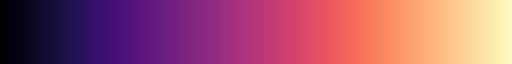

In [7]:

indx = np.arange(3725)
np.random.shuffle(indx)
print(3725*0.2, 3725*0.2, 3725*0.2+3725*0.2)

test_index = indx[:745]
valid_index = indx[746:1490]
train_index = indx[1490:]

test_index.shape, valid_index.shape, train_index.shape

train_dataset = Classification_Dataset(train_index)
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=10, shuffle=True)

valid_dataset = Classification_Dataset(valid_index)
valid_loader = torch.utils.data.DataLoader(valid_dataset, batch_size=5, shuffle=True)

test_dataset = Classification_Dataset(test_index)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=5, shuffle=True)

# img,label = train_dataset[200]


# # get colormap
ncolors = 256
color_array = plt.get_cmap('magma')(range(ncolors))
# color_array[:,-1] = np.linspace(0.0,1.0,ncolors)
# create a colormap object
map_object = LinearSegmentedColormap.from_list(name='rainbow_alpha',colors=color_array)
map_object

# Image 확인

Text(0.5, 1.0, 'MR_T2')

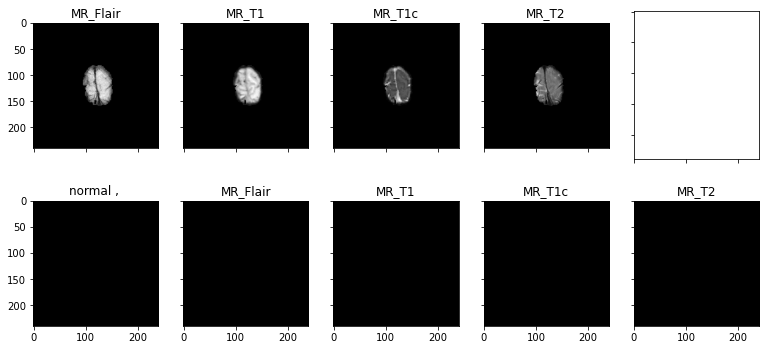

In [8]:
return_label = transforms.ToPILImage()
img,label = train_dataset[np.random.randint(train_dataset.__len__())]
f, axes = plt.subplots(2,5,sharex=True,sharey=True)
f.set_size_inches((13,6))
for i in range(4):
    axes[0][i].imshow(return_label(img[i]),cmap ='gray')
    axes[1][i].imshow(return_label(label[i]),cmap ='gray')    
axes[1][4].imshow(return_label(label[4]),cmap='gray')
axes[0][0].set_title('MR_Flair')
axes[0][1].set_title('MR_T1')
axes[0][2].set_title('MR_T1c')
axes[0][3].set_title('MR_T2')
axes[1][0].set_title("normal , ")# 검은색부분이 0인 부분 
axes[1][1].set_title("MR_Flair")
axes[1][2].set_title("MR_T1")
axes[1][3].set_title("MR_T1c")
axes[1][4].set_title("MR_T2")

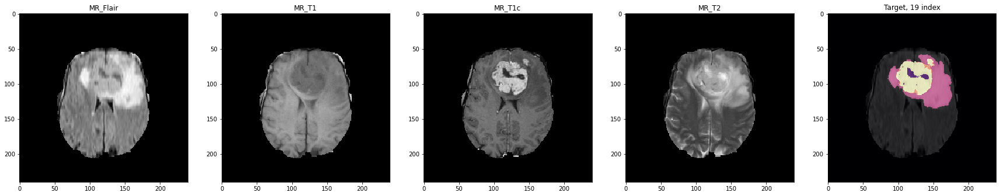

In [9]:
def imshow1(img):
    plt.imshow(img, cmap='gray',  interpolation='none')
def imshow2(mask):
    plt.imshow(mask, cmap=map_object, alpha=0.7,  interpolation='none')#target이 있는 부분을 출력하기 위해서 show하는 부분 

i=0
for img, label in train_loader:
    plt.figure(figsize=(30,30))
    plt.subplot(1,5,1)
    plt.title('MR_Flair')
    imshow1(img[0][0])
    plt.subplot(1,5,2)
    plt.title('MR_T1')
    imshow1(img[0][1])
    plt.subplot(1,5,3)
    plt.title('MR_T1c')
    imshow1(img[0][2])
    plt.subplot(1,5,4)
    plt.title('MR_T2')
    imshow1(img[0][3])
    plt.subplot(1,5,5)
    plt.title('Target, {} index'.format(i))
    imshow1(img[0][0])
    imshow2((label[0][1]+label[0][2]*2+label[0][3]*3+label[0][4]*4))
    
    plt.show()
    i+=1
    if i == 20:
        break
    clear_output(wait=True)

# Attention_Cell

In [10]:
#MicroWise Convolution
class ConvBlock(nn.Module):

    def __init__(self, in_channels, out_channels):
        super(ConvBlock, self).__init__()

        # number of input channels is a number of filters in the previous layer
        # number of output channels is a number of filters in the current layer
        # "same" convolutions
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        x = self.conv(x)
        return x
#MacroWise Convolution
class ConvBlock2(nn.Module):

    def __init__(self, in_channels, out_channels):
        super(ConvBlock2, self).__init__()

        # number of input channels is a number of filters in the previous layer
        # number of output channels is a number of filters in the current layer
        # "same" convolutions
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=7, stride=1, padding=3, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=7, stride=1, padding=3, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        x = self.conv(x)
        return x
    
class UpConv(nn.Module):

    def __init__(self, in_channels, out_channels):
        super(UpConv, self).__init__()

        self.up = nn.Sequential(
            nn.Upsample(scale_factor=2),
            nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        x = self.up(x)
        return x


class AttentionBlock(nn.Module): # 
    """Attention block with learnable parameters"""

    def __init__(self, F_g, F_l, n_coefficients):
        """
        :param F_g: number of feature maps (channels) in previous layer
        :param F_l: number of feature maps in corresponding encoder layer, transferred via skip connection
        :param n_coefficients: number of learnable multi-dimensional attention coefficients
        """
        super(AttentionBlock, self).__init__()

        self.W_gate = nn.Sequential(#
            nn.Conv2d(F_g, n_coefficients, kernel_size=(1), stride=1, padding=0, bias=False),
            nn.BatchNorm2d(n_coefficients)
        )

        self.W_x = nn.Sequential( #
            nn.Conv2d(F_l, n_coefficients, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(n_coefficients)
        )

        self.psi = nn.Sequential(
            nn.Conv2d(n_coefficients, 1, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(1),
            nn.Sigmoid()
        )

        self.relu = nn.ReLU(inplace=True)

    def forward(self, gate, skip_connection):
        """
        :param gate: gating signal from previous layer
        :param skip_connection: activation from corresponding encoder layer
        :return: output activations
        """
        g1 = self.W_gate(gate) #gate로 부터 오는 matrix 
        x1 = self.W_x(skip_connection) # skip connection으로 부터 얻은 matrix  
        psi = self.relu(g1 + x1) # activation function use 
        psi = self.psi(psi) # gate value: scalar  
        out = skip_connection * psi
        return out
    
class Macro_AttentionBlock(nn.Module):
    """Attention block with learnable parameters"""

    def __init__(self, F_g, F_l_1, F_l_2, n_coefficients):
        """
        :param F_g: number of feature maps (channels) in previous layer
        :param F_l: number of feature maps in corresponding encoder layer, transferred via skip connection
        :param n_coefficients: number of learnable multi-dimensional attention coefficients
        """
        super(Macro_AttentionBlock, self).__init__()

        self.W_gate = nn.Sequential(
            nn.Conv2d(F_g, n_coefficients, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(n_coefficients)
        )

        self.W_x1 = nn.Sequential(
            nn.Conv2d(F_l_1, n_coefficients, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(n_coefficients)
        )
        
        self.W_x2 = nn.Sequential(
            nn.Conv2d(F_l_2, n_coefficients, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(n_coefficients)
        )
        
        self.psi = nn.Sequential(
            nn.Conv2d(n_coefficients, F_g, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(F_g),
            nn.Sigmoid()
        )

        self.relu = nn.ReLU(inplace=True)

    def forward(self, gate, skip_connection, skip_connection_2):
        """
        :param gate: gating signal from previous layer
        :param skip_connection: activation from corresponding encoder layer
        :return: output activations
        """
        # print('g1.shape: {} , x1.shape: {}, x2.shape{} '.format(gate.shape,skip_connection.shape,skip_connection_2.shape))
        
        g1 = self.W_gate(gate)
        x1 = self.W_x1(skip_connection)
        x2 = self.W_x2(skip_connection_2)
        psi = self.relu(g1 + x1 + x2)
        psi = self.psi(psi)
        out = skip_connection * psi
        return out
      
class Attention3D(nn.Module):
    """Attention block with learnable parameters"""

    def __init__(self, F_g, F_l, n_coefficients):
        """
        :param F_g: number of feature maps (channels) in previous layer
        :param F_l: number of feature maps in corresponding encoder layer, transferred via skip connection
        :param n_coefficients: number of learnable multi-dimensional attention coefficients
        """
        super(Attention3D, self).__init__()

        self.W_gate = nn.Sequential(#
            nn.Conv3d(1,1, kernel_size=(1,1,1), stride=1, padding=0, bias=False),
            nn.BatchNorm3d(1)
        )

        self.W_x = nn.Sequential( #
            nn.Conv3d(1, 1, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm3d(1)
        )

        self.psi = nn.Sequential(
            nn.Conv3d(1, 1, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm3d(1),
            nn.Sigmoid()
        )

        self.relu = nn.ReLU(inplace=True)

    def forward(self, gate, skip_connection):
        """
        :param gate: gating signal from previous layer
        :param skip_connection: activation from corresponding encoder layer
        :return: output activations
        """
        # print(gate.shape, skip_connection.shape)
        g1 = self.W_gate(gate.unsqueeze(1)) #gate로 부터 오는 matrix 
        x1 = self.W_x(skip_connection.unsqueeze(1)) # skip connection으로 부터 얻은 matrix  
        psi = self.relu(g1 + x1) # activation function use 
        psi = self.psi(psi) # gate value: scalar  
        out = skip_connection * psi.squeeze(1)
        return out

## Model 1 
### for detect the iamge pixel

In [11]:
class AttentionUNet_1(nn.Module):

    def __init__(self, img_ch=3, output_ch=1):
        super(AttentionUNet_1, self).__init__()

        self.MaxPool = nn.MaxPool2d(kernel_size=2, stride=2)

        self.Conv1 = ConvBlock(img_ch, 64)
        self.Conv2 = ConvBlock(64, 128)
        self.Conv3 = ConvBlock(128, 256)
        self.Conv4 = ConvBlock(256, 512)
        self.Conv5 = ConvBlock(512, 1024)

        self.Up5 = UpConv(1024, 512)
        self.Att5 = AttentionBlock(F_g=512, F_l=512, n_coefficients=256)
        # self.Att5 = Attention3D(F_g=512, F_l=512, n_coefficients=256)
        
        
        self.UpConv5 = ConvBlock(1024, 512)

        self.Up4 = UpConv(512, 256)
        self.Att4 = AttentionBlock(F_g=256, F_l=256, n_coefficients=128)
        # self.Att4 = Attention3D(F_g=256, F_l=256, n_coefficients=128)
        
        self.UpConv4 = ConvBlock(512, 256)

        self.Up3 = UpConv(256, 128)
        self.Att3 = AttentionBlock(F_g=128, F_l=128, n_coefficients=64)
        # self.Att3 = Attention3D(F_g=128, F_l=128, n_coefficients=64)
        
        self.UpConv3 = ConvBlock(256, 128)

        self.Up2 = UpConv(128, 64)
        self.Att2 = AttentionBlock(F_g=64, F_l=64, n_coefficients=32)
        # self.Att2 = Attention3D(F_g=64, F_l=64, n_coefficients=32)
        
        self.UpConv2 = ConvBlock(128, 64)

        self.Conv = nn.Conv2d(64, output_ch, kernel_size=1, stride=1, padding=0)
        # self.softmax = nn.Softmax(dim=1)
        self.sigmoid = nn.Sigmoid()
        
    def forward(self, x):
        """
        e : encoder layers
        d : decoder layers
        s : skip-connections from encoder layers to decoder layers
        """
        e1 = self.Conv1(x)
        # print('e1:\t ',e1.shape)
        e2 = self.MaxPool(e1)
        e2 = self.Conv2(e2)
        # print('e2:\t ',e2.shape)

        e3 = self.MaxPool(e2)
        e3 = self.Conv3(e3)
        # print('e3:\t ',e3.shape)

        e4 = self.MaxPool(e3)
        e4 = self.Conv4(e4)
        # print('e4:\t ',e4.shape)

        e5 = self.MaxPool(e4)
        e5 = self.Conv5(e5)
        # print('e5:\t ',e5.shape)

        d5 = self.Up5(e5)
        # print('d5:\t ',d5.shape)
        
        s4 = self.Att5(gate=d5, skip_connection=e4)
        d5 = torch.cat((s4, d5), dim=1) # concatenate attention-weighted skip connection with previous layer output
        # print('d5 2: \t',d5.shape)
        d5 = self.UpConv5(d5)
        # print('s4,d5:\t ',s4.shape,d5.shape)
        d4 = self.Up4(d5)
        # print('d4:\t', d4.shape)
        s3 = self.Att4(gate=d4, skip_connection=e3)
        d4 = torch.cat((s3, d4), dim=1)
        d4 = self.UpConv4(d4)
        # print('s3,d4:\t ',s3.shape,d4.shape)

        d3 = self.Up3(d4)
        # print('d3:\t', d3.shape)
        
        s2 = self.Att3(gate=d3, skip_connection=e2)
        d3 = torch.cat((s2, d3), dim=1)
        d3 = self.UpConv3(d3)
        # print('s2,d3:\t ',s2.shape,d3.shape)

        d2 = self.Up2(d3)
        # print('d2:\t', d2.shape)
        
        s1 = self.Att2(gate=d2, skip_connection=e1)
        d2 = torch.cat((s1, d2), dim=1)
        d2 = self.UpConv2(d2)
        # print('s1,d2:\t ',s1.shape,d2.shape)

        out = self.Conv(d2)
        return self.sigmoid(out)


## Model 2 
### for detect the tumor

In [12]:
class AttentionUNet_2(nn.Module):

    def __init__(self, img_ch=3, output_ch=1):
        super(AttentionUNet_2, self).__init__()

        self.MaxPool = nn.MaxPool2d(kernel_size=2, stride=2)

        self.Conv1 = ConvBlock(img_ch, 64)
        self.Conv2 = ConvBlock(64, 128)
        self.Conv2_2 = ConvBlock2(64, 128)
        self.Conv3 = ConvBlock(128, 256)
        self.Conv3_2 = ConvBlock2(128, 256)
        self.Conv4 = ConvBlock(256, 512)
        self.Conv4_2 = ConvBlock2(256, 512)
        self.Conv5 = ConvBlock(512, 1024)

        self.Up5 = UpConv(1024, 512)
        self.Att5 = Macro_AttentionBlock(F_g=512, F_l_1=512, F_l_2=512, n_coefficients=256)
        self.UpConv5 = ConvBlock(1024, 512)

        self.Up4 = UpConv(512, 256)
        self.Att4 = Macro_AttentionBlock(F_g=256, F_l_1=256, F_l_2=256, n_coefficients=128)
        self.UpConv4 = ConvBlock(512, 256)

        self.Up3 = UpConv(256, 128)
        self.Att3 = Macro_AttentionBlock(F_g=128, F_l_1=128, F_l_2=128, n_coefficients=64)
        self.UpConv3 = ConvBlock(256, 128)

        self.Up2 = UpConv(128, 64)
        self.Att2 = AttentionBlock(F_g=64, F_l=64, n_coefficients=32)
        self.UpConv2 = ConvBlock(128, 64)

        self.Conv = nn.Conv2d(64, output_ch, kernel_size=1, stride=1, padding=0)
        self.softmax = nn.Softmax(dim=1)
    
    def forward(self, x):
        """
        e : encoder layers
        d : decoder layers
        s : skip-connections from encoder layers to decoder layers
        """
        e1 = self.Conv1(x)

        e2 = self.MaxPool(e1)
        e2_1 = self.Conv2(e2)
        e2_2 = self.Conv2_2(e2)

        e3 = self.MaxPool(e2_1)
        e3_1 = self.Conv3(e3)
        e3_2 = self.Conv3_2(e3)

        e4 = self.MaxPool(e3_1)
        e4_1 = self.Conv4(e4)
        e4_2 = self.Conv4_2(e4)

        e5 = self.MaxPool(e4_1)
        e5 = self.Conv5(e5)

        d5 = self.Up5(e5)

        s4 = self.Att5(gate=d5, skip_connection=e4_1, skip_connection_2=e4_2)
        d5 = torch.cat((s4, d5), dim=1) # concatenate attention-weighted skip connection with previous layer output
        d5 = self.UpConv5(d5)

        d4 = self.Up4(d5)
        s3 = self.Att4(gate=d4, skip_connection=e3_1, skip_connection_2=e3_2)
        d4 = torch.cat((s3, d4), dim=1)
        d4 = self.UpConv4(d4)

        d3 = self.Up3(d4)
        s2 = self.Att3(gate=d3, skip_connection=e2_1, skip_connection_2=e2_2)
        d3 = torch.cat((s2, d3), dim=1)
        d3 = self.UpConv3(d3)

        d2 = self.Up2(d3)
        s1 = self.Att2(gate=d2, skip_connection=e1)
        d2 = torch.cat((s1, d2), dim=1)
        d2 = self.UpConv2(d2)

        out = self.Conv(d2)

        return self.softmax(out)

In [12]:
# class FocalLoss(nn.modules.loss._WeightedLoss):

#     def __init__(self, gamma=0, size_average=None, ignore_index=-100,
#                  reduce=None, balance_param=1.0):
#         super(FocalLoss, self).__init__(size_average)
#         self.gamma = gamma
#         self.size_average = size_average
#         self.ignore_index = ignore_index
#         self.balance_param = balance_param

#     def forward(self, input, target):
        
#         # inputs and targets are assumed to be BatchxClasses
#         assert len(input.shape) == len(target.shape) #같지 않은경우는 assert처리시킴 
#         assert input.size(0) == target.size(0)
#         assert input.size(1) == target.size(1)
           
#         # compute the negative likelyhood
#         logpt = - F.binary_cross_entropy_with_logits(input, target)
#         pt = torch.exp(logpt)

#         # compute the loss
#         focal_loss = -( (1-pt)**self.gamma ) * logpt
#         balanced_focal_loss = self.balance_param * focal_loss
#         return balanced_focal_losssigmoid

In [13]:
def imshow1(img):
    plt.imshow(img, cmap='gray',  interpolation='none')
    
def imshow2(mask):
    plt.imshow(mask, cmap=map_object, alpha=0.7,  interpolation='none')#target이 있는 부분을 출력하기 위해서 show하는 부분 


def threshold_img(output, threshold =0.5):
    output2 = output.clone()
    output2[output2>=threshold] = 1
    output2[output2<threshold] = 0
    return output2
    
def Bimshow(img,i):
    plt.imshow(img, cmap=map_object, alpha=0.4)  
    plt.axis('off')
    plt.text(10, 20, f'Epoch = {i}',color = 'white',size = 15)

def Bimshow_2(original, label,param,i):
    f , (ax1,ax2) = plt.subplots(1,2,figsize = (10,15))
    ax1.imshow(original, cmap='gray',  interpolation='none')
    ax1.imshow(label, cmap=map_object, alpha=0.4)  
    
    ax1.axis('off')
    ax1.text(10, 20, f'Epoch = {i}',color = 'white',size = 15)

    ax2.imshow(original, cmap='gray',  interpolation='none')
    ax2.imshow(param, cmap=map_object, alpha=0.4)  

    ax2.axis('off')
   
    ax2.text(10, 20, f'Epoch = {i}',color = 'white',size = 15)

### for picture - 1

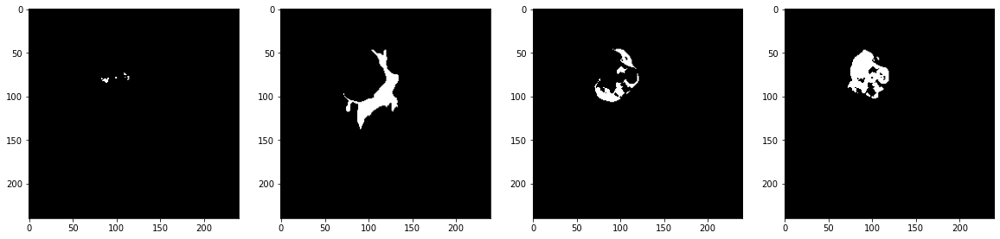

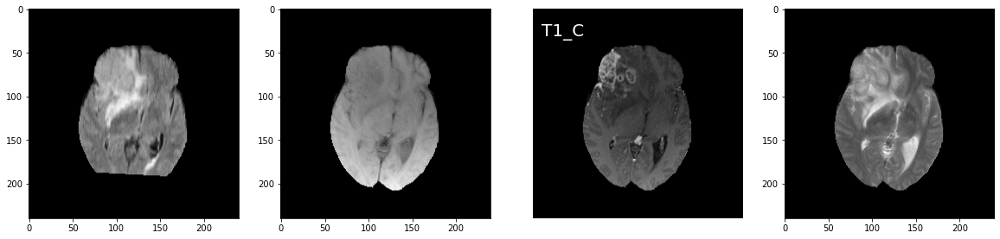

In [14]:

# index= np.random.randint(1,3724)
index= 1499
label_1 = Image.open(f"./BRATS_Padding/label/1/{index}.png").convert('L')
label_2 = Image.open(f"./BRATS_Padding/label/2/{index}.png").convert('L')
label_3 = Image.open(f"./BRATS_Padding/label/3/{index}.png").convert('L')
label_4 = Image.open(f"./BRATS_Padding/label/4/{index}.png").convert('L')
trans = transforms.Compose([transforms.ToTensor()])
label_1, label_2, label_3, label_4 = trans(label_1), trans(label_2), trans(label_3), trans(label_4)
img = [label_1, label_2, label_3, label_4]

pltlabel = torch.stack((label_1, label_2, label_3, label_4)).squeeze(1).unsqueeze(0)
pltlabel = pltlabel.to(device)
f, (ax1,ax2,ax3,ax4) = plt.subplots(1,4,sharex=True,figsize=(20,6))
# img = data[126,:,:]
ax1.imshow(img[0].permute(1,2,0),cmap='gray')
ax2.imshow(img[1].permute(1,2,0),cmap='gray')
ax3.imshow(img[2].permute(1,2,0),cmap='gray')
ax4.imshow(img[3].permute(1,2,0),cmap='gray')

MR_Flair = Image.open(f"./BRATS_Padding/image/MR_Flair/{index}.png").convert('L')
MR_T1 = Image.open(f"./BRATS_Padding/image/MR_T1/{index}.png").convert('L')
MR_T1c = Image.open(f"./BRATS_Padding/image/MR_T1c/{index}.png").convert('L')
MR_T2 = Image.open(f"./BRATS_Padding/image/MR_T2/{index}.png").convert('L')
trans = transforms.Compose([transforms.ToTensor()])
MR_Flair, MR_T1, MR_T1c, MR_T2 = trans(MR_Flair), trans(MR_T1), trans(MR_T1c), trans(MR_T2)
img_2 = [MR_Flair, MR_T1, MR_T1c, MR_T2]

pltimage = torch.stack((MR_Flair, MR_T1, MR_T1c, MR_T2)).squeeze(1).unsqueeze(0)
pltimage = pltimage.to(device)

f, (ax5,ax6,ax7,ax8) = plt.subplots(1,4,sharex=True,figsize=(20,6))
# img = data[126,:,:]
ax5.imshow(img_2[0].permute(1,2,0),cmap='gray')
ax6.imshow(img_2[1].permute(1,2,0),cmap='gray')
ax7.imshow(img_2[2].permute(1,2,0),cmap='gray')
ax7.axis(False)
ax7.text(10,30,'T1_C',fontsize =20,c='w')
ax8.imshow(img_2[3].permute(1,2,0),cmap='gray')
plt.show()


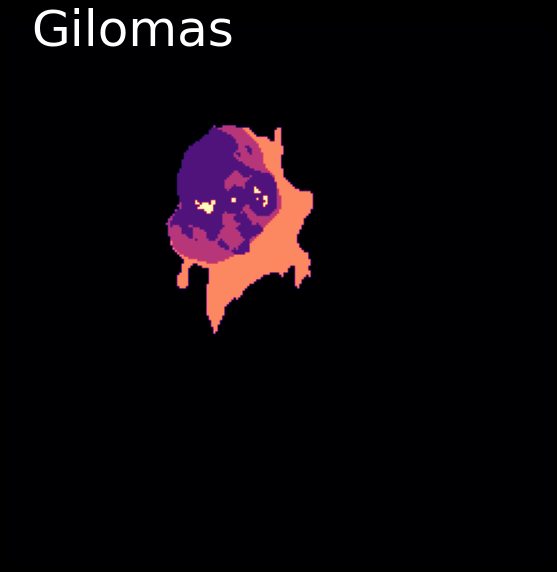

In [15]:
f ,ax = plt.subplots(1,1,figsize = (10,10),facecolor=(0,0,0))
ax.imshow((pltlabel[0,0]*4+pltlabel[0,1]*3+pltlabel[0,2]*2+pltlabel[0,3]*1).detach().cpu(),cmap =map_object)
ax.axis(False)
ax.text(10,10,'Gilomas',c='w',fontsize = 50)
# ax.set_facecolor('white')
plt.savefig('./png/Gilomas.png')


In [15]:
num_epoch = 200
learning_rate = 1e-2

model_1 = AttentionUNet_1(4, 1).to(device)
optimizer_1 = torch.optim.AdamW(model_1.parameters(), lr=learning_rate)
scheduler_1 = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_1,mode='min',patience=20)
save_1 = '2_case_unet_ver_1'


model_2 = AttentionUNet_2(4,5).to(device)
optimizer_2 = torch.optim.AdamW(model_2.parameters(), lr=learning_rate)
scheduler_2 = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_2,mode='min',patience=20)
save_2 = '2_case_Macro_Unet'

loss_func = torch.nn.BCELoss().to(device)
# loss_func_2 = torch.nn.CrossEntropyLoss().to(device)
model_1,model_2 = model_1.to(device), model_2.to(device)
    
plt2 = pltlabel[0].detach().cpu().numpy()
plt1 = pltimage[0][2].detach().cpu().numpy()
show_label = plt2[0]*5+plt2[1]*4+plt2[2]*3+plt2[3]*2
# model

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 1: model 1 : train_loss : 0.05552206281364231, valid_loss : 0.028362263211195286


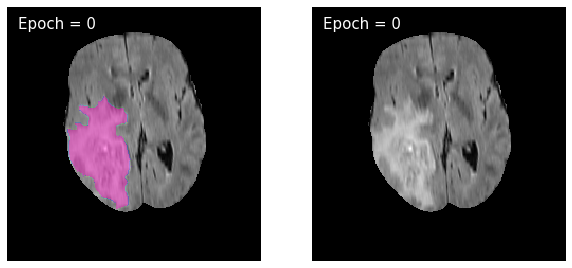

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 2: model 1 : train_loss : 0.01669300199950935, valid_loss : 0.018423686686307315


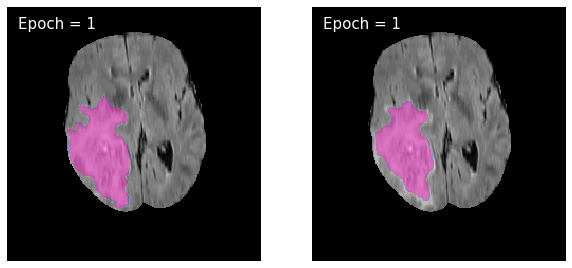

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 3: model 1 : train_loss : 0.01356441152836269, valid_loss : 0.010988742449782915


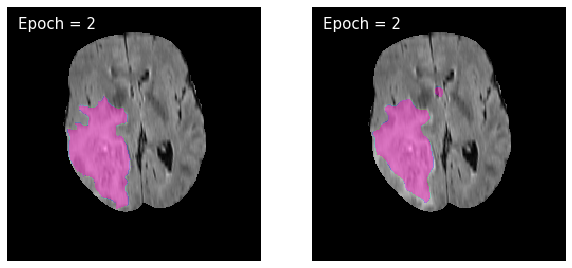

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 4: model 1 : train_loss : 0.011646763357397385, valid_loss : 0.015147428110232931


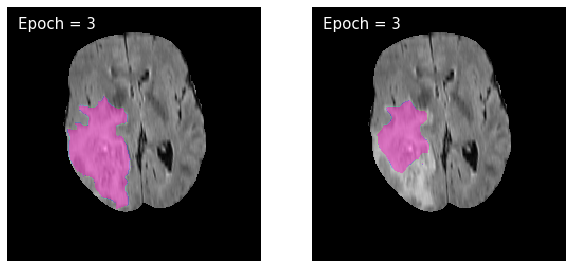

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 5: model 1 : train_loss : 0.010665124802854354, valid_loss : 0.0102094461656986


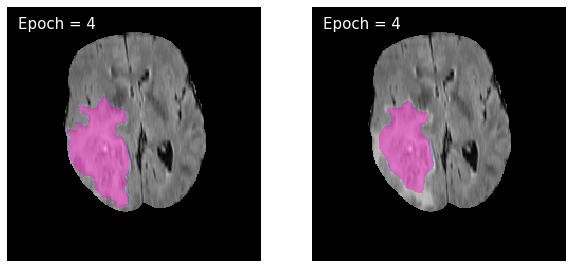

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 6: model 1 : train_loss : 0.009769980648925248, valid_loss : 0.009054148913149816


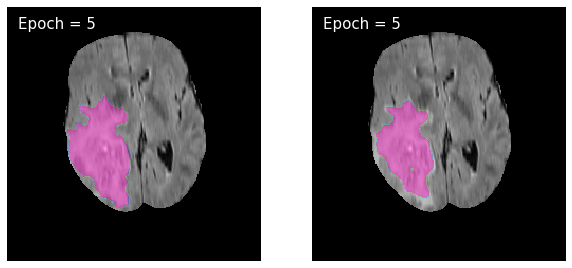

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 7: model 1 : train_loss : 0.008902903632167102, valid_loss : 0.00834215719624143


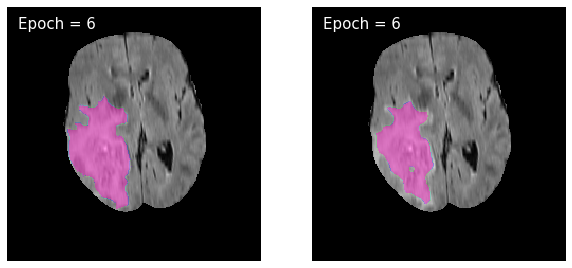

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 8: model 1 : train_loss : 0.008035424597232168, valid_loss : 0.007354133043092041


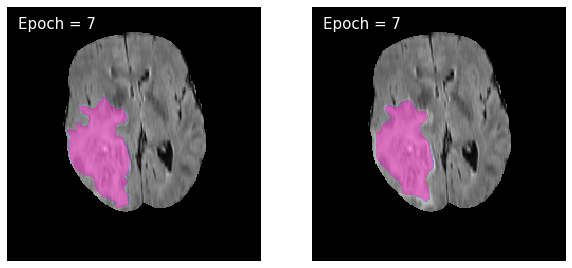

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 9: model 1 : train_loss : 0.007452846336766027, valid_loss : 0.009250805715687323


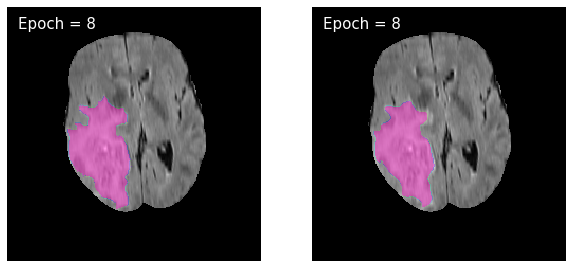

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 10: model 1 : train_loss : 0.007901777136733368, valid_loss : 0.021139113553722895


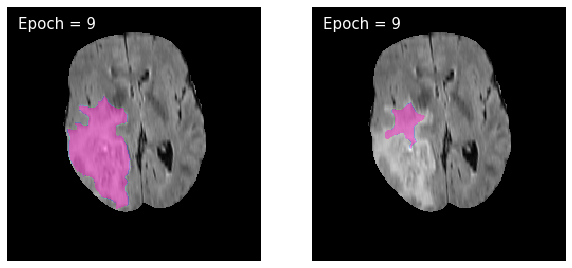

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 11: model 1 : train_loss : 0.007488580256407785, valid_loss : 0.006602414382555057


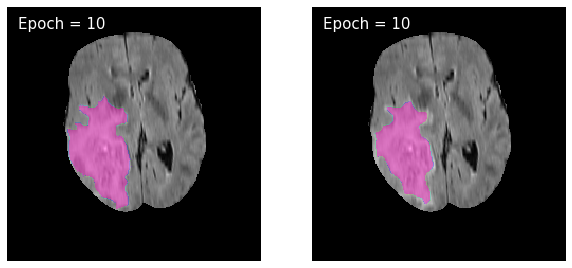

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 12: model 1 : train_loss : 0.007361101253092043, valid_loss : 0.008291548363876666


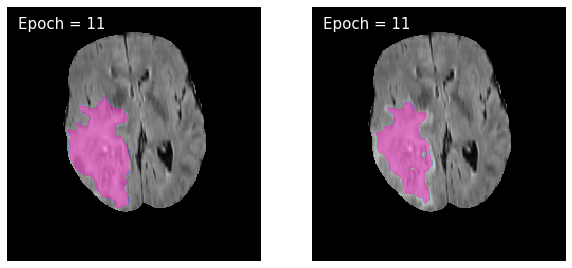

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 13: model 1 : train_loss : 0.007055387094406457, valid_loss : 0.006080043763019862


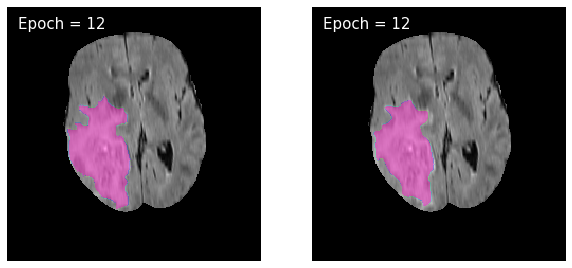

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 14: model 1 : train_loss : 0.00585339973436906, valid_loss : 0.0070129385149843935


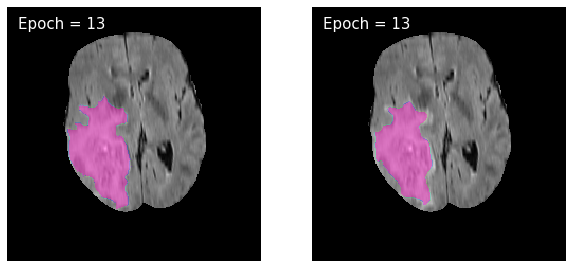

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 15: model 1 : train_loss : 0.006829020689969249, valid_loss : 0.006436586256760405


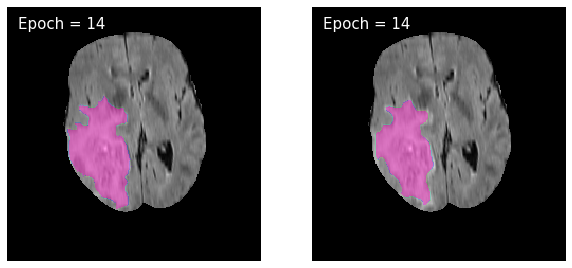

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 16: model 1 : train_loss : 0.006966863219366853, valid_loss : 0.005820722179383012


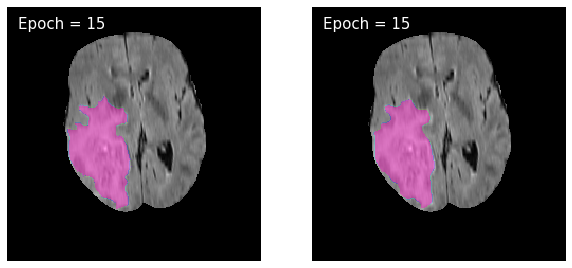

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 17: model 1 : train_loss : 0.00558464487865674, valid_loss : 0.006836093313095702


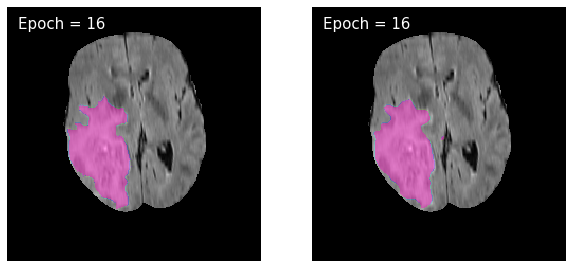

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 18: model 1 : train_loss : 0.006179138593806966, valid_loss : 0.0045207561748191105


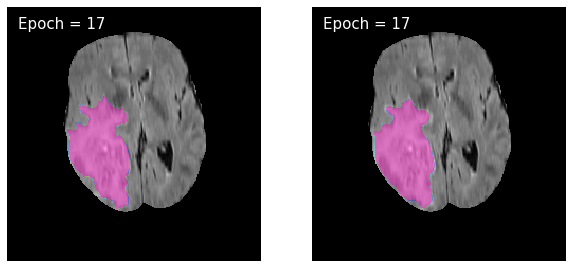

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 19: model 1 : train_loss : 0.005173398105097388, valid_loss : 0.004962509720669875


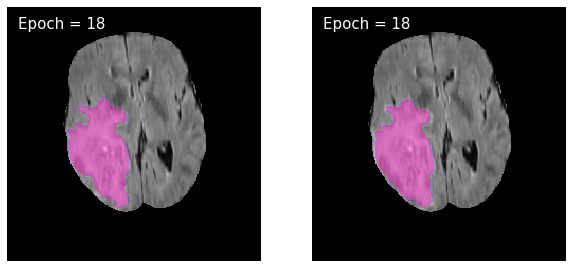

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 20: model 1 : train_loss : 0.005029692042408557, valid_loss : 0.004548136169813016


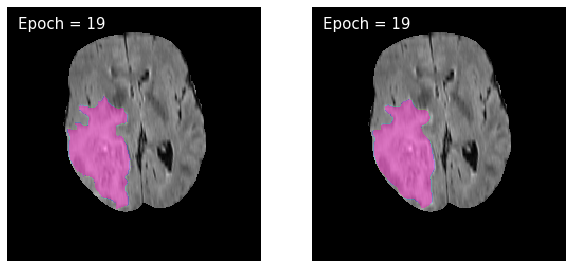

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 21: model 1 : train_loss : 0.004967999170061359, valid_loss : 0.0044758147976813965


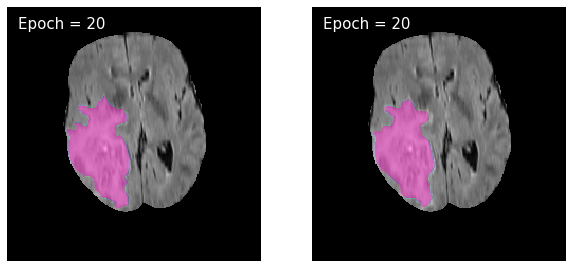

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 22: model 1 : train_loss : 0.006862417560891651, valid_loss : 0.007302955008456945


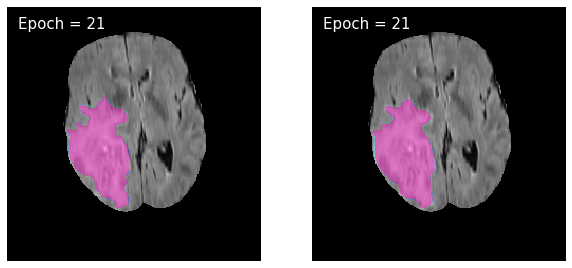

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 23: model 1 : train_loss : 0.005424126350868835, valid_loss : 0.006483770044380108


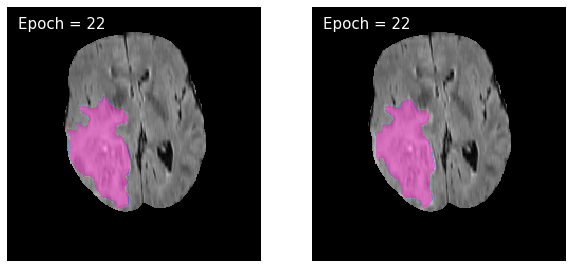

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 24: model 1 : train_loss : 0.00504148015775874, valid_loss : 0.004089691739450881


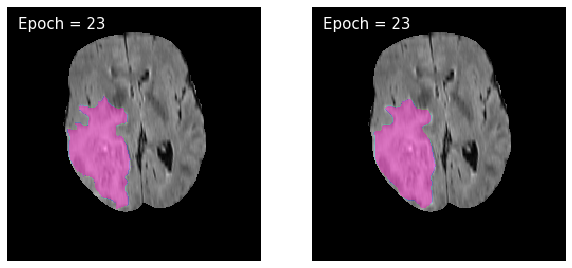

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 25: model 1 : train_loss : 0.004769121435207447, valid_loss : 0.008946452729245016


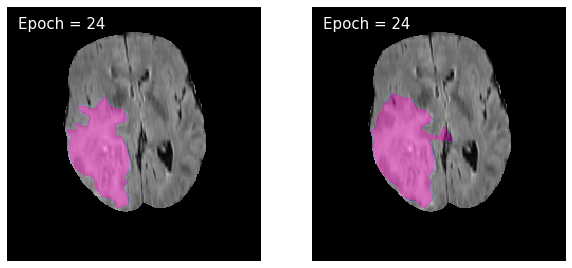

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 26: model 1 : train_loss : 0.004936010910908955, valid_loss : 0.0043559519552350285


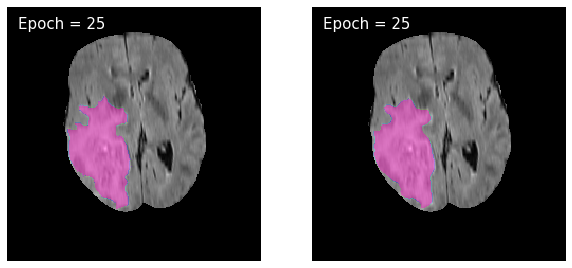

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 27: model 1 : train_loss : 0.00405434174006086, valid_loss : 0.00425536338477081


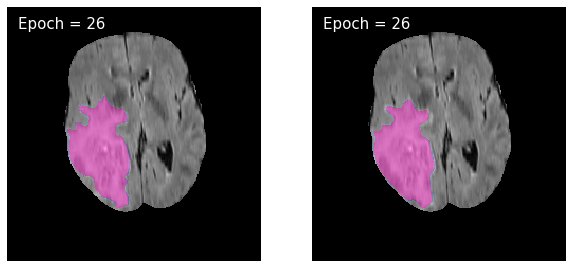

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 28: model 1 : train_loss : 0.003947296673529982, valid_loss : 0.00391599393117609


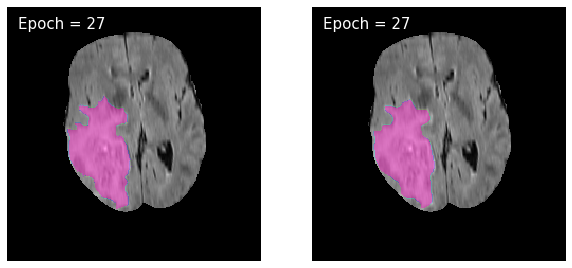

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 29: model 1 : train_loss : 0.0038898948243607182, valid_loss : 0.005244479855745552


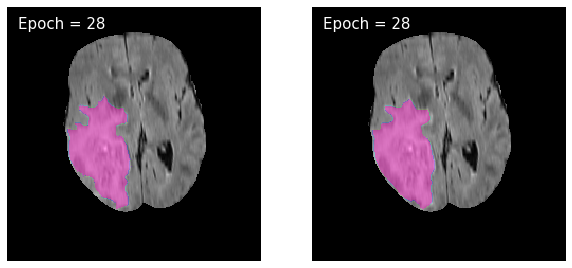

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 30: model 1 : train_loss : 0.005555367627296617, valid_loss : 0.0038265919408037685


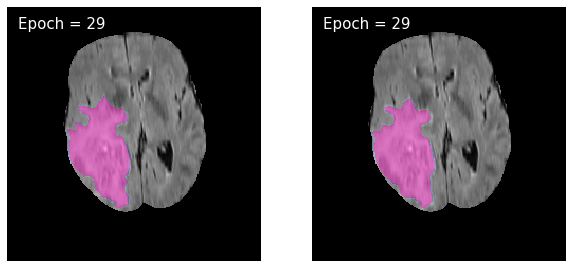

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 31: model 1 : train_loss : 0.0038777749620974938, valid_loss : 0.003558181011591673


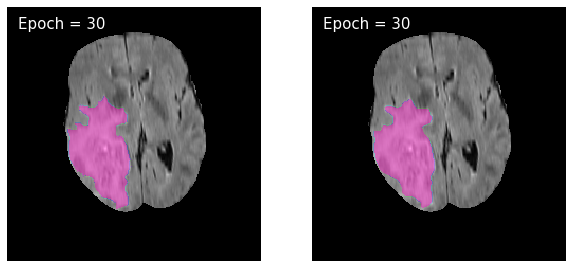

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 32: model 1 : train_loss : 0.0035980894822377025, valid_loss : 0.0035513967331234986


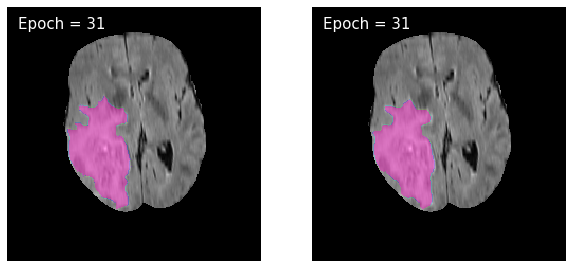

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 33: model 1 : train_loss : 0.00400631434699515, valid_loss : 0.0058881140480211164


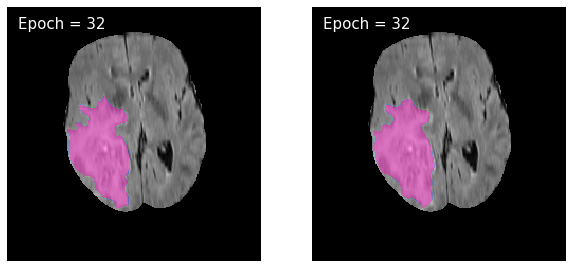

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 34: model 1 : train_loss : 0.004025294253854857, valid_loss : 0.005303212578749381


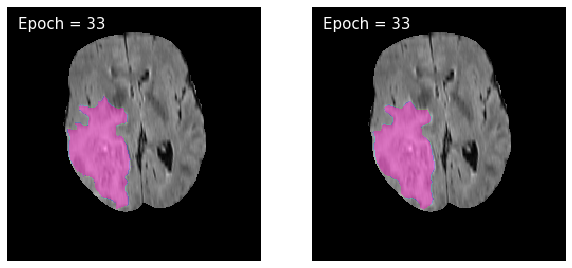

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 35: model 1 : train_loss : 0.004194280406036891, valid_loss : 0.004100346689286745


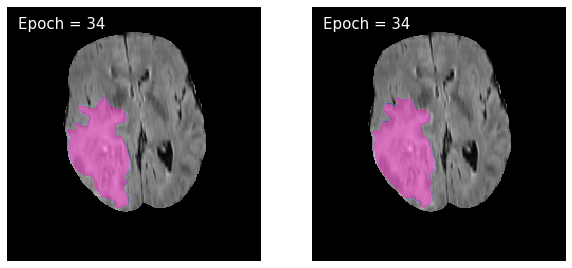

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 36: model 1 : train_loss : 0.0034547743294056, valid_loss : 0.003287201409462522


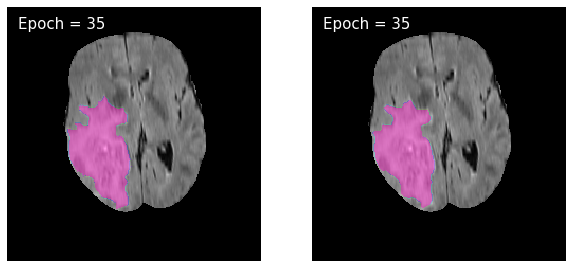

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 37: model 1 : train_loss : 0.0036516690735912375, valid_loss : 0.08554757497447336


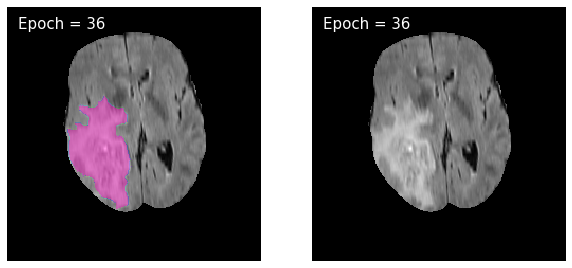

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 38: model 1 : train_loss : 0.004214409504774423, valid_loss : 0.00467954398483818


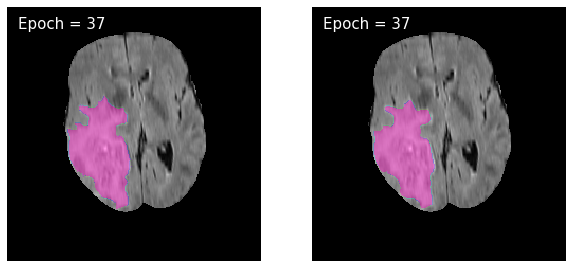

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 39: model 1 : train_loss : 0.003145315947816238, valid_loss : 0.0030747147270860312


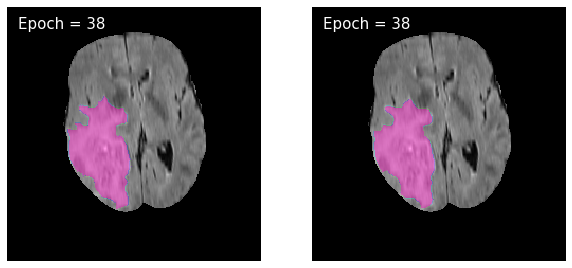

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 40: model 1 : train_loss : 0.003936721327190102, valid_loss : 0.003156379850846988


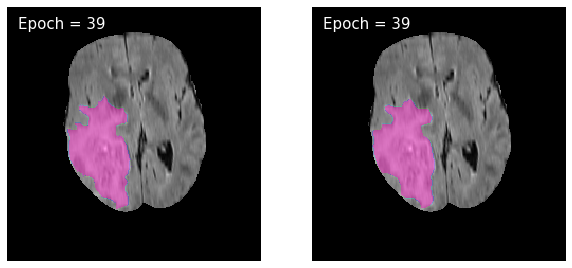

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 41: model 1 : train_loss : 0.0031196911902065592, valid_loss : 0.0030581266935363386


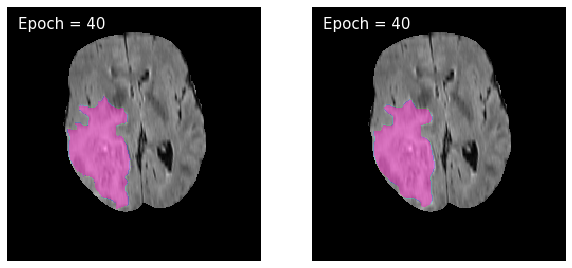

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 42: model 1 : train_loss : 0.0030621392170604353, valid_loss : 0.002990963453113128


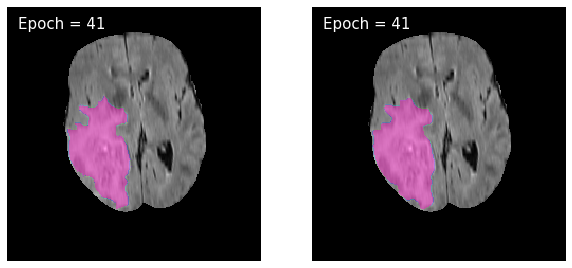

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 43: model 1 : train_loss : 0.0030825130086107083, valid_loss : 0.0032272169752177713


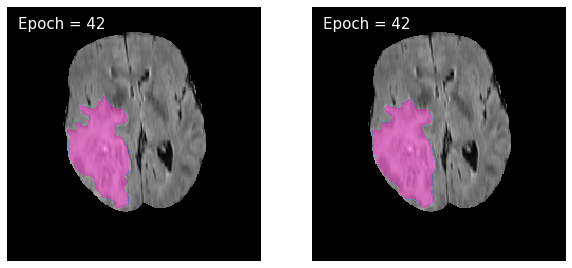

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 44: model 1 : train_loss : 0.0029192483209931554, valid_loss : 0.007511701292979604


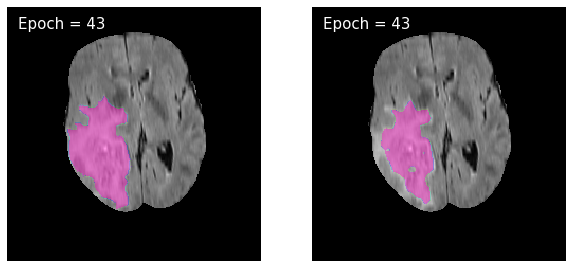

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 45: model 1 : train_loss : 0.0030016259684058646, valid_loss : 0.002879707117413225


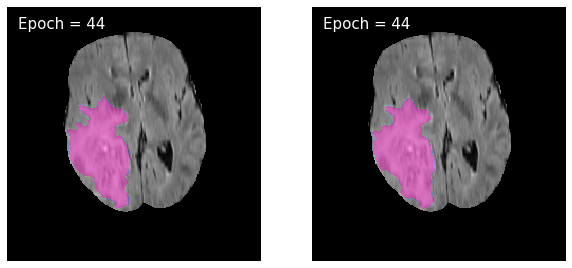

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 46: model 1 : train_loss : 0.0028269202219100725, valid_loss : 0.008175438087345287


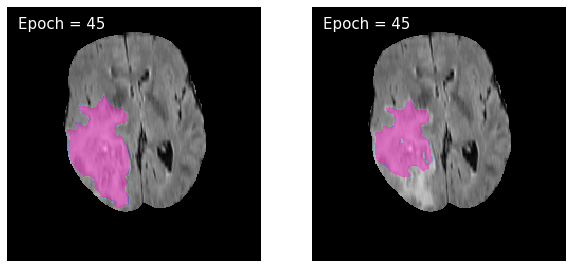

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 47: model 1 : train_loss : 0.012421463749666283, valid_loss : 0.00936884941345715


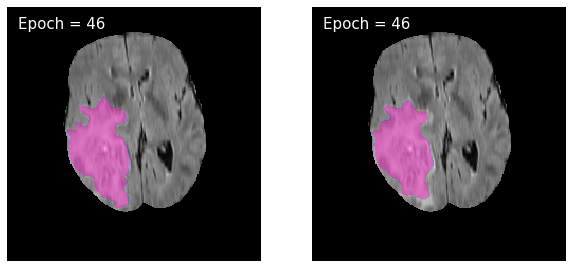

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 48: model 1 : train_loss : 0.006406855698616579, valid_loss : 0.004445027837593238


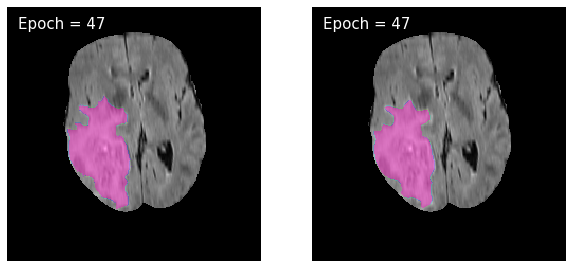

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 49: model 1 : train_loss : 0.0040592108859102555, valid_loss : 0.003873237422116243


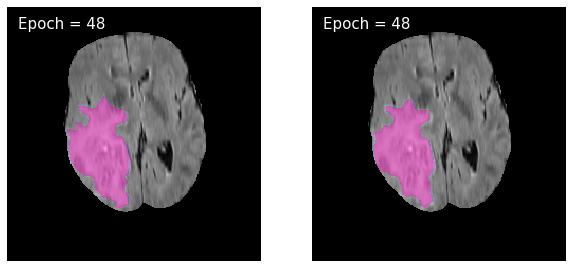

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 50: model 1 : train_loss : 0.0032070757726240452, valid_loss : 0.0031771197270489345


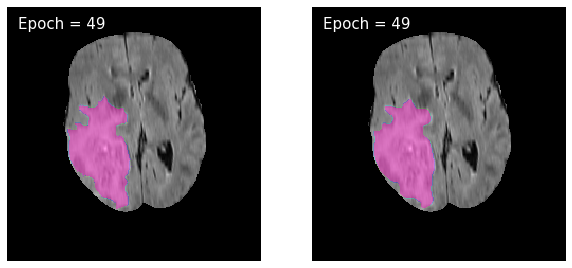

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 51: model 1 : train_loss : 0.003105975953558483, valid_loss : 0.003069628524912334


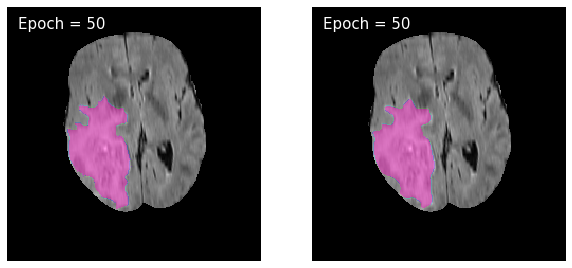

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 52: model 1 : train_loss : 0.002822098963034117, valid_loss : 0.0030429401838616087


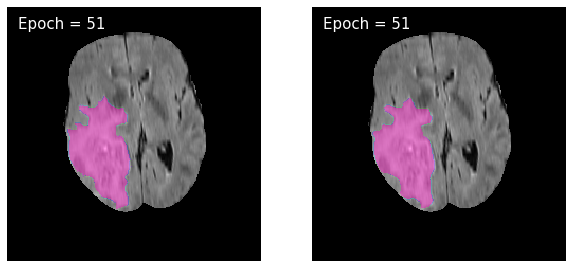

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 53: model 1 : train_loss : 0.0025759457910444774, valid_loss : 0.002802311558901058


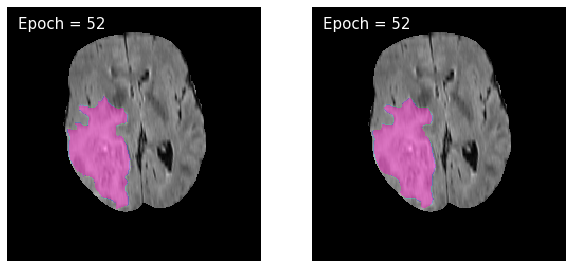

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 54: model 1 : train_loss : 0.0025671005098710617, valid_loss : 0.0027831894900666


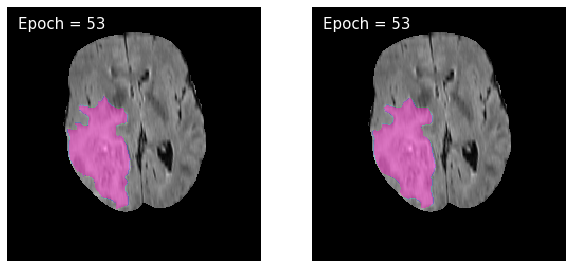

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 55: model 1 : train_loss : 0.0036512841423253983, valid_loss : 0.0034401421768111675


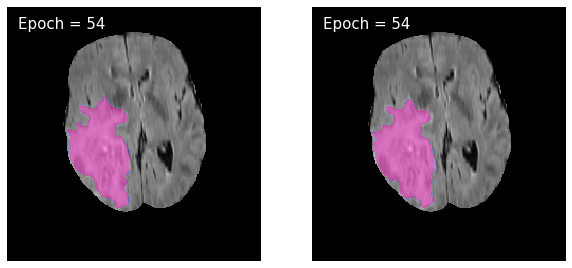

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 56: model 1 : train_loss : 0.002718408663201568, valid_loss : 0.0029693334504475757


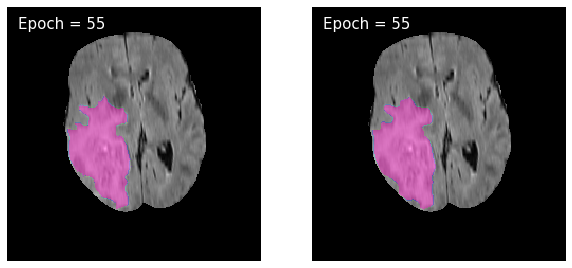

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 57: model 1 : train_loss : 0.002561602759710461, valid_loss : 0.005050049276138359


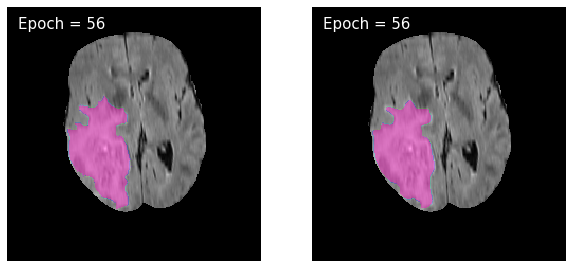

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 58: model 1 : train_loss : 0.0027199628665070127, valid_loss : 0.0028612876245121405


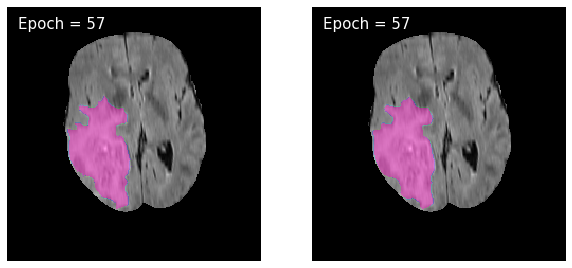

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 59: model 1 : train_loss : 0.0054374872366141315, valid_loss : 0.0056058995801921445


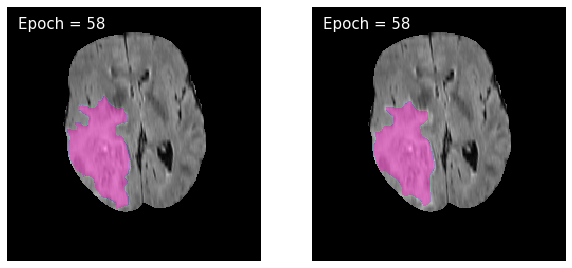

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 60: model 1 : train_loss : 0.003215561863227687, valid_loss : 0.0028315285518524117


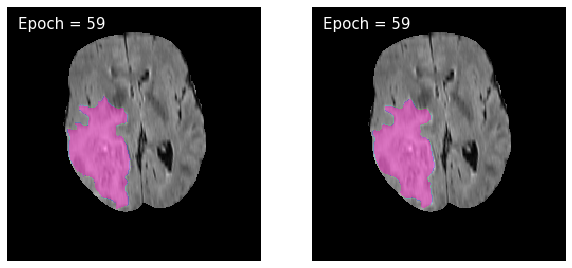

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 61: model 1 : train_loss : 0.0025006783664232816, valid_loss : 0.0028331028336570276


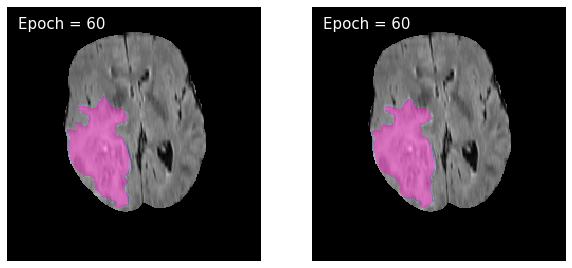

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 62: model 1 : train_loss : 0.0023468282334390862, valid_loss : 0.0025568987946292176


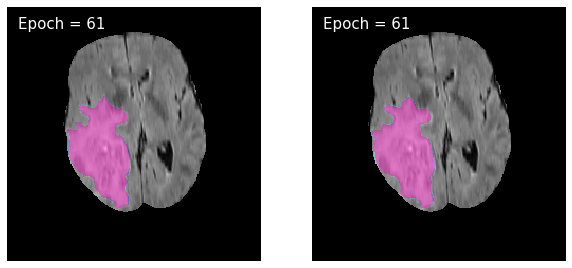

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 63: model 1 : train_loss : 0.002720383309096233, valid_loss : 0.0028914706580280836


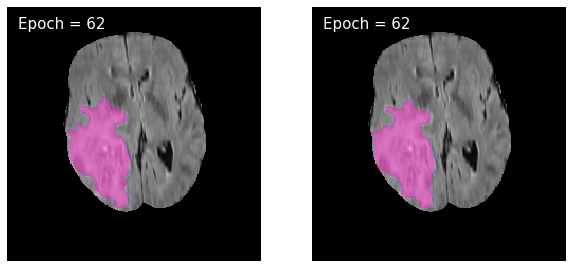

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 64: model 1 : train_loss : 0.0025026101177933846, valid_loss : 0.0026278116568915055


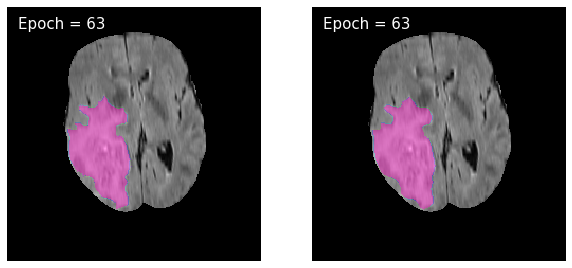

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 65: model 1 : train_loss : 0.0024688935509036415, valid_loss : 0.002532689304500048


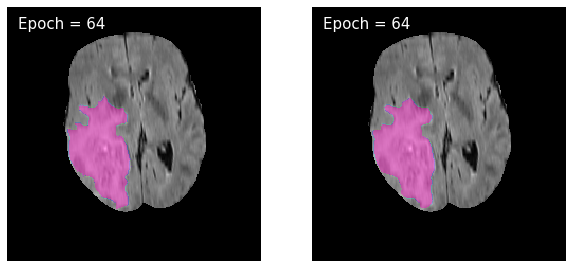

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 66: model 1 : train_loss : 0.002203146827997022, valid_loss : 0.0025410454049830085


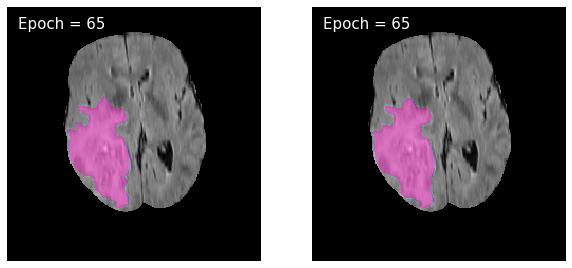

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 67: model 1 : train_loss : 0.0022122718061635643, valid_loss : 0.0026961048649065365


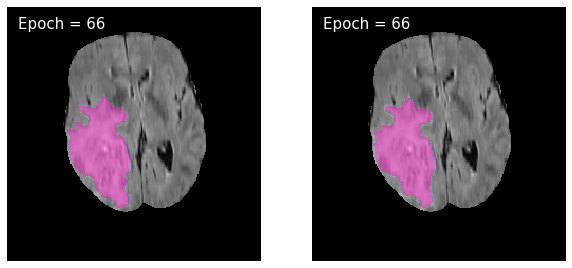

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 68: model 1 : train_loss : 0.0025033512292361236, valid_loss : 0.0048577230049091985


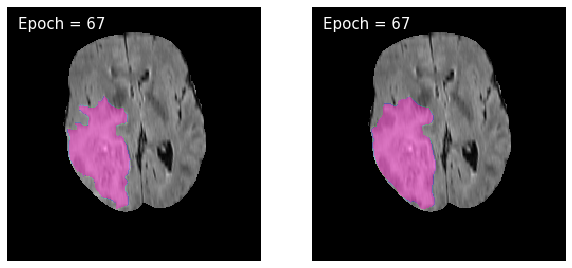

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 69: model 1 : train_loss : 0.0030010893761018595, valid_loss : 0.0025791699707549396


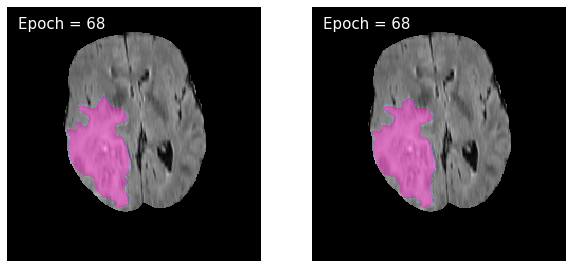

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 70: model 1 : train_loss : 0.0023125508865890474, valid_loss : 0.0026960976644124193


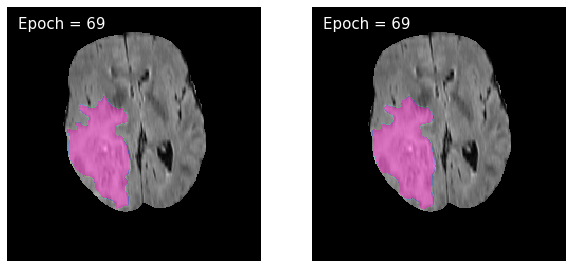

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 71: model 1 : train_loss : 0.002543264758066717, valid_loss : 0.0028999746152930978


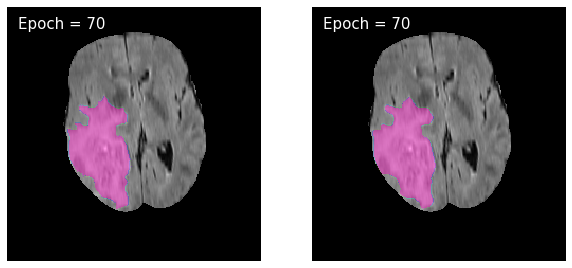

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 72: model 1 : train_loss : 0.002262742011463838, valid_loss : 0.0027326792675432163


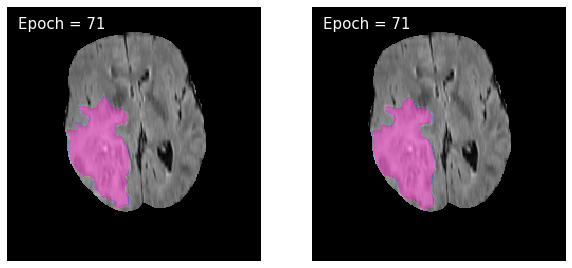

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 73: model 1 : train_loss : 0.002235995347484757, valid_loss : 0.002910943945166836


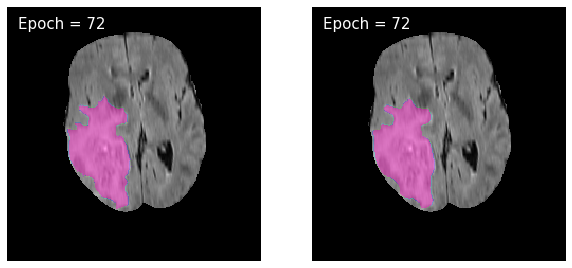

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 74: model 1 : train_loss : 0.0021461302291766898, valid_loss : 0.0024308534582801757


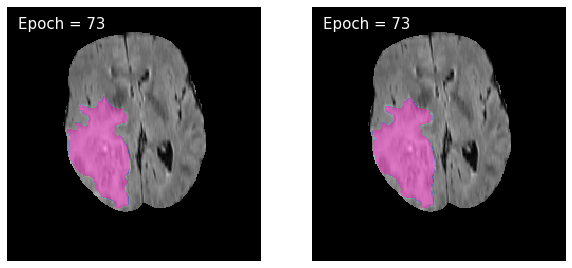

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 75: model 1 : train_loss : 0.0021218478314950625, valid_loss : 0.0028391971607700473


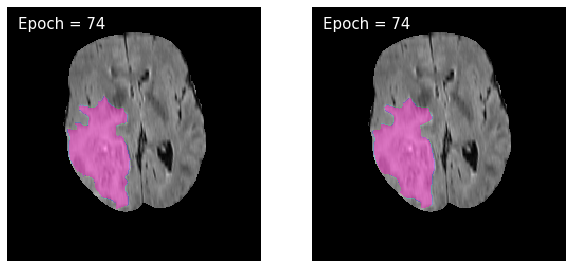

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 76: model 1 : train_loss : 0.0021413273526353035, valid_loss : 0.0026733091677284644


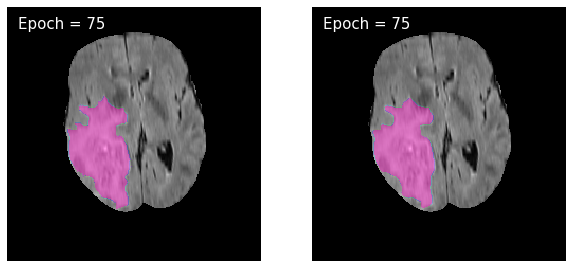

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 77: model 1 : train_loss : 0.0020486414124440662, valid_loss : 0.0026110392512687635


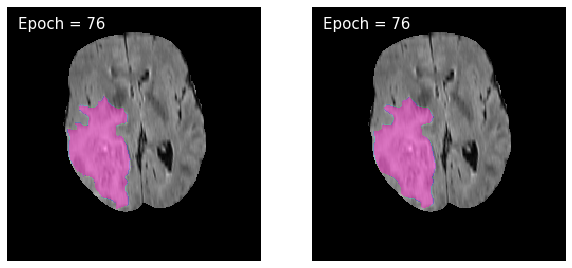

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 78: model 1 : train_loss : 0.005581733555707043, valid_loss : 0.0035823730966620484


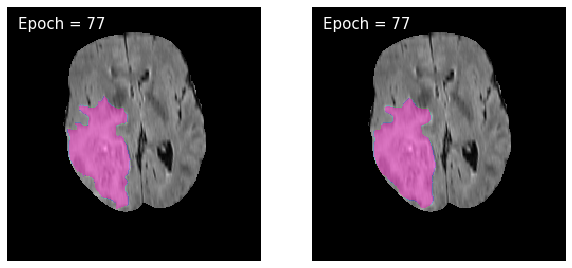

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 79: model 1 : train_loss : 0.002741403266660501, valid_loss : 0.002669940927825675


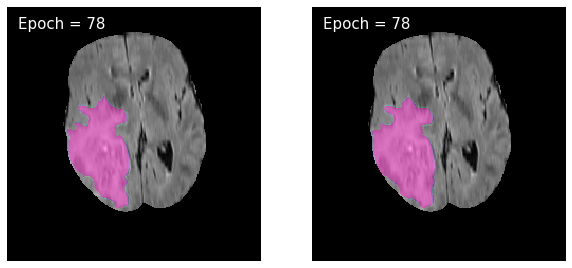

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 80: model 1 : train_loss : 0.0021256069371977005, valid_loss : 0.002425246319077166


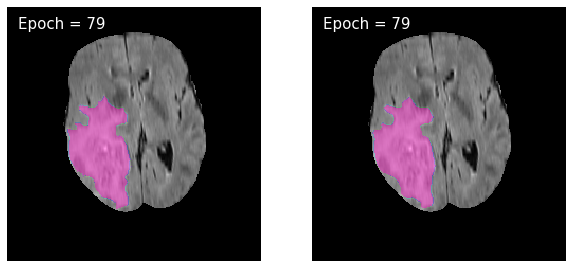

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 81: model 1 : train_loss : 0.001957322821121332, valid_loss : 0.002360448820682267


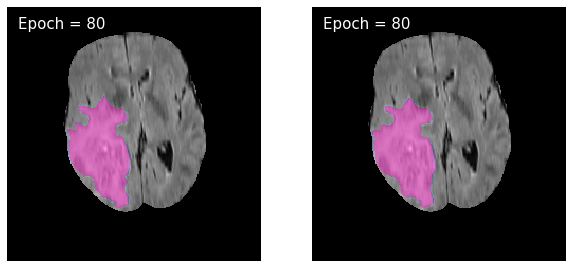

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 82: model 1 : train_loss : 0.002007534383315226, valid_loss : 0.002327902935602807


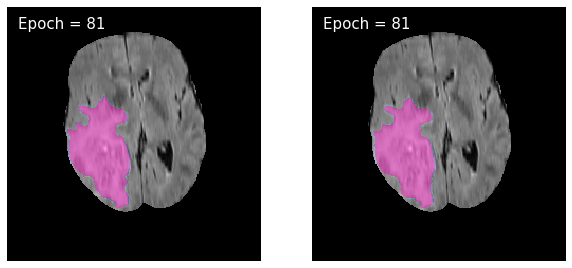

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 83: model 1 : train_loss : 0.0018943612521288172, valid_loss : 0.0025958202380723053


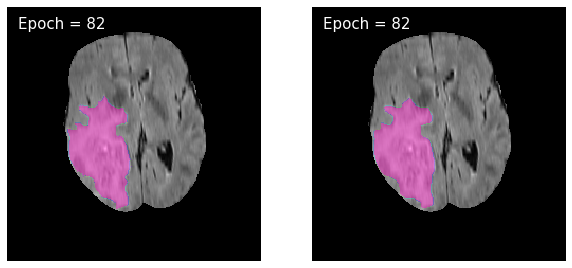

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 84: model 1 : train_loss : 0.0019306120222303317, valid_loss : 0.0023714926689448078


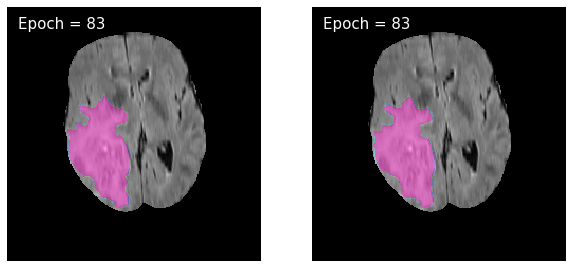

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 85: model 1 : train_loss : 0.002012626434911227, valid_loss : 0.002561938549297212


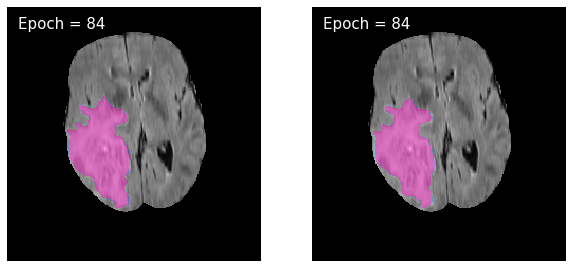

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 86: model 1 : train_loss : 0.0019292476863926437, valid_loss : 0.0023198353790153943


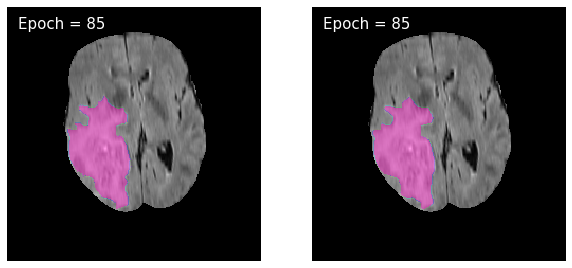

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 87: model 1 : train_loss : 0.0023368978074655954, valid_loss : 0.003581043520070915


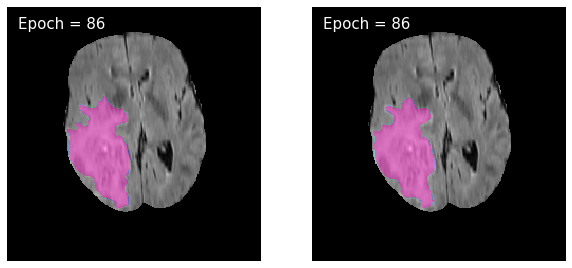

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 88: model 1 : train_loss : 0.00214480561640747, valid_loss : 0.002554715847315821


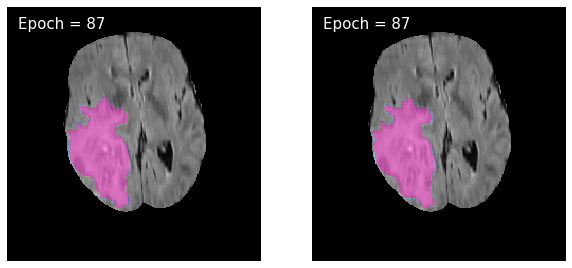

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 89: model 1 : train_loss : 0.0021821918674136283, valid_loss : 0.0025408402119193787


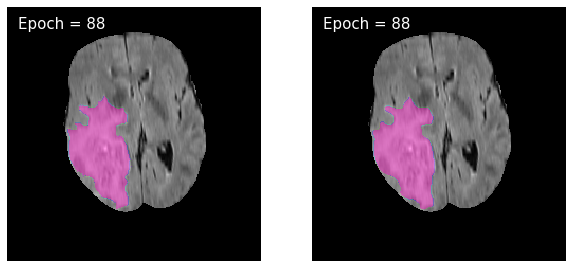

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 90: model 1 : train_loss : 0.001926619750703705, valid_loss : 0.002502377898841368


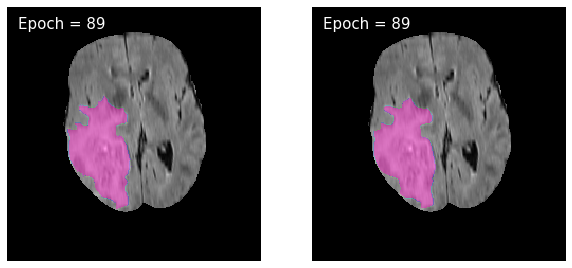

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 91: model 1 : train_loss : 0.001961208473635991, valid_loss : 0.0023710254339558245


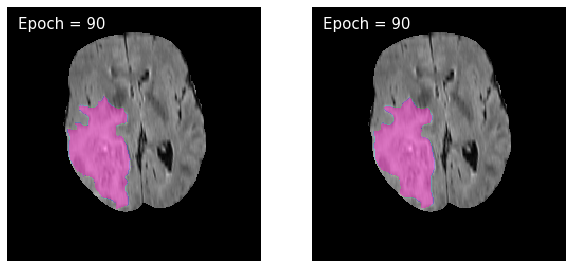

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 92: model 1 : train_loss : 0.0018184074557344987, valid_loss : 0.0024836513808397147


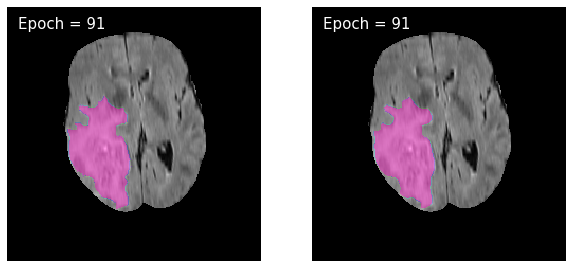

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 93: model 1 : train_loss : 0.0018866915215502715, valid_loss : 0.0023388342383694805


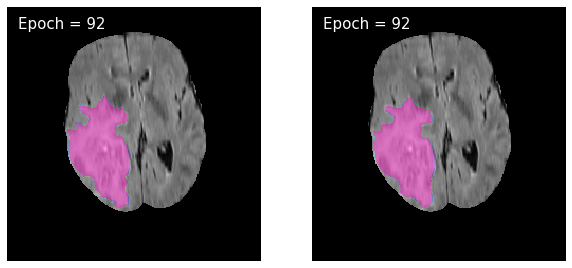

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 94: model 1 : train_loss : 0.0022919387658020133, valid_loss : 0.0028607120107398093


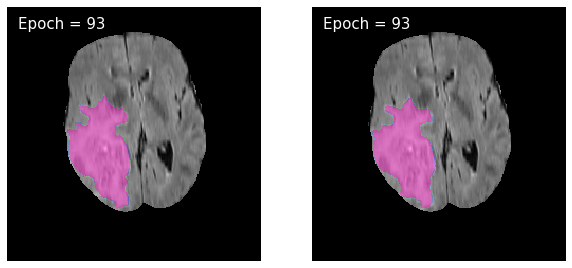

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 95: model 1 : train_loss : 0.002036659542265576, valid_loss : 0.0025743704229978185


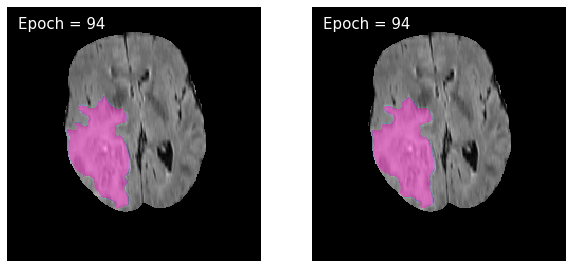

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 96: model 1 : train_loss : 0.0018645485467530072, valid_loss : 0.0023587139086557627


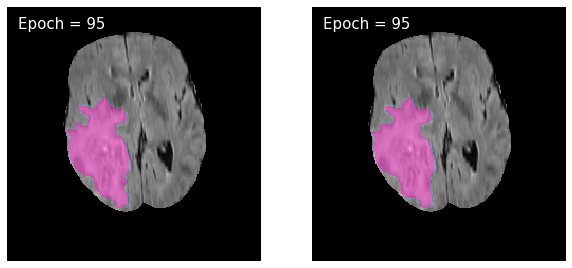

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 97: model 1 : train_loss : 0.0017552728821196729, valid_loss : 0.0024293661299166717


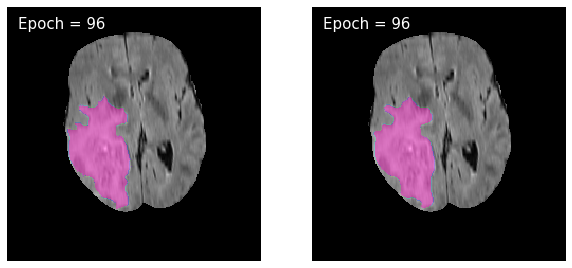

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 98: model 1 : train_loss : 0.0018017982725950787, valid_loss : 0.0022359882867119592


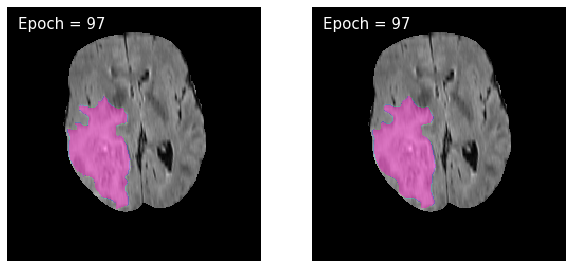

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 99: model 1 : train_loss : 0.0018450804390192106, valid_loss : 0.0025623519334096725


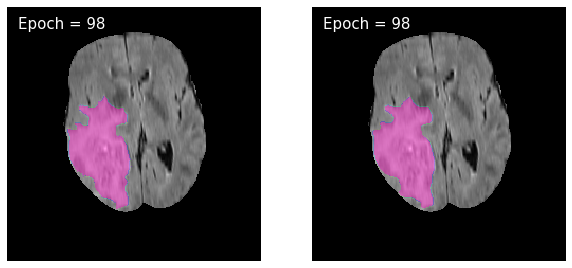

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 100: model 1 : train_loss : 0.0018918182531948023, valid_loss : 0.0024908489211787972


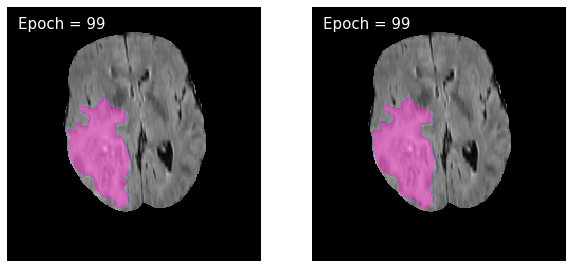

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 101: model 1 : train_loss : 0.0017000709842566353, valid_loss : 0.0024289013876070222


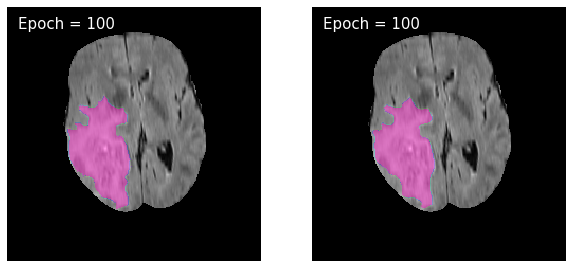

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 102: model 1 : train_loss : 0.0017314529873709043, valid_loss : 0.002434229083292703


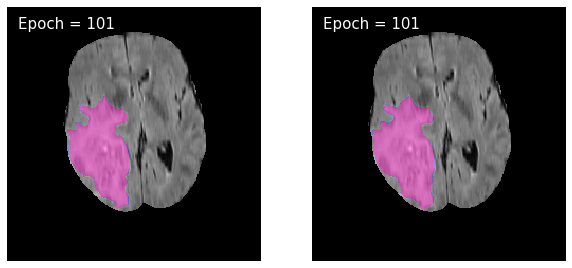

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 103: model 1 : train_loss : 0.0017710594110704767, valid_loss : 0.0025138498224850057


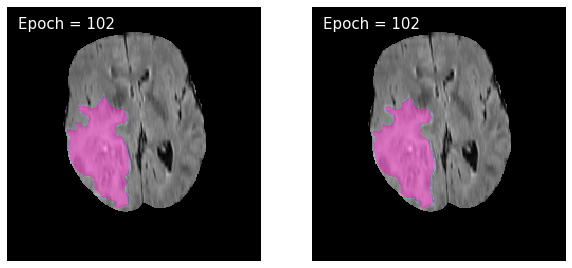

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 104: model 1 : train_loss : 0.005802893931868098, valid_loss : 0.009416130128014288


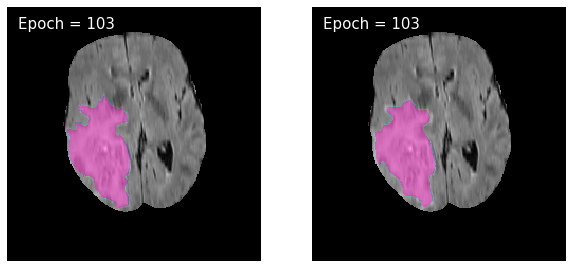

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 105: model 1 : train_loss : 0.0038043027223921963, valid_loss : 0.0028343396687151605


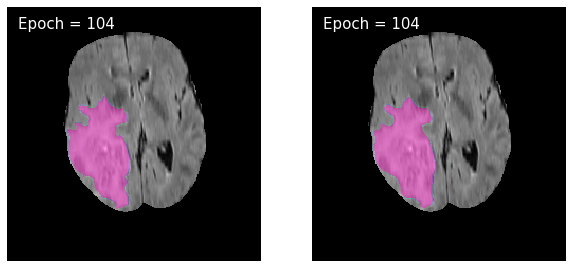

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 106: model 1 : train_loss : 0.0020815210830629352, valid_loss : 0.0027107130544800394


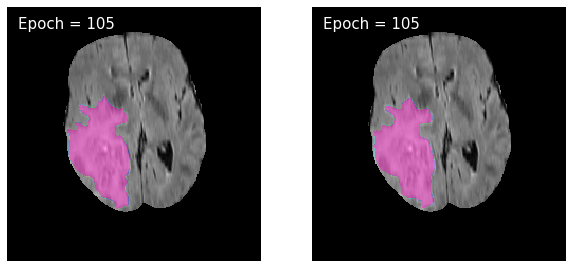

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 107: model 1 : train_loss : 0.0017601845368678127, valid_loss : 0.0022476156177294437


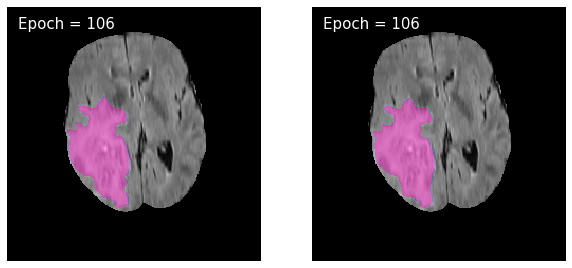

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 108: model 1 : train_loss : 0.0016354915113949739, valid_loss : 0.002329877801988107


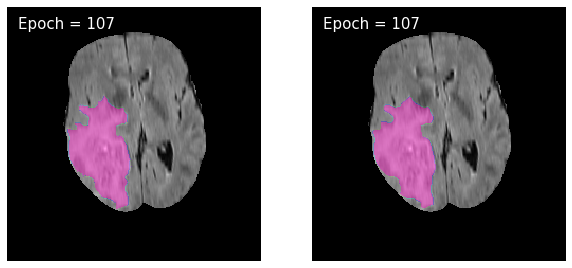

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 109: model 1 : train_loss : 0.0016044687828318611, valid_loss : 0.0023420189798084075


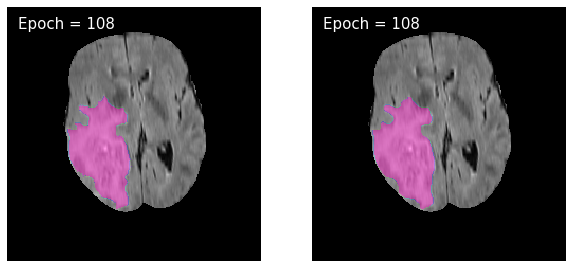

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 110: model 1 : train_loss : 0.001678466799739298, valid_loss : 0.002303712269155412


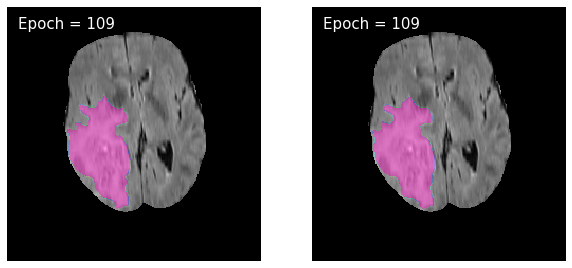

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 111: model 1 : train_loss : 0.0015392850994347352, valid_loss : 0.002238398543307142


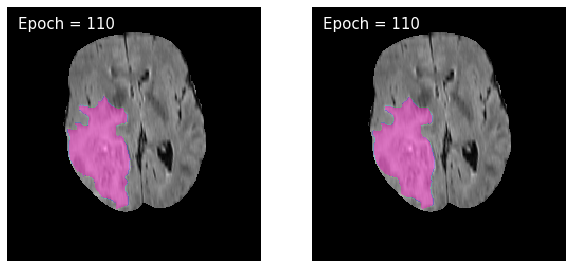

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 112: model 1 : train_loss : 0.0015116524995011347, valid_loss : 0.0022149499646560524


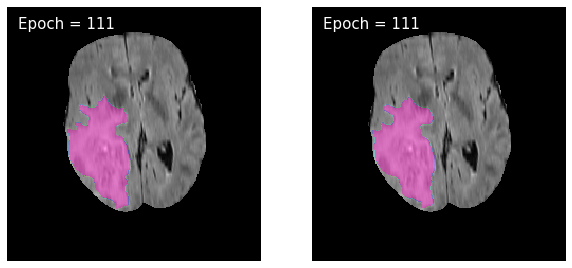

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 113: model 1 : train_loss : 0.0015543783331972724, valid_loss : 0.002494540714652406


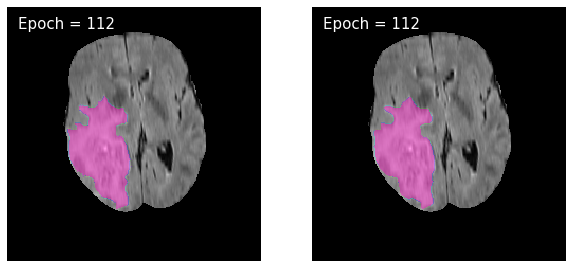

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 114: model 1 : train_loss : 0.001544302760654294, valid_loss : 0.0021832717645607364


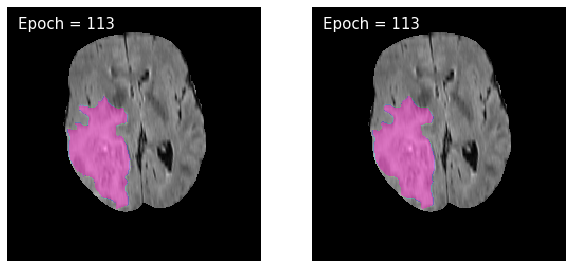

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 115: model 1 : train_loss : 0.0016522521827601734, valid_loss : 0.0022579573389093018


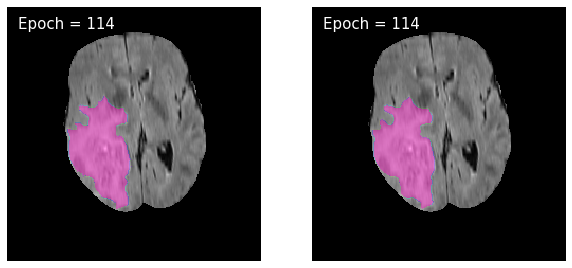

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 116: model 1 : train_loss : 0.001594360154601959, valid_loss : 0.0023230122297226144


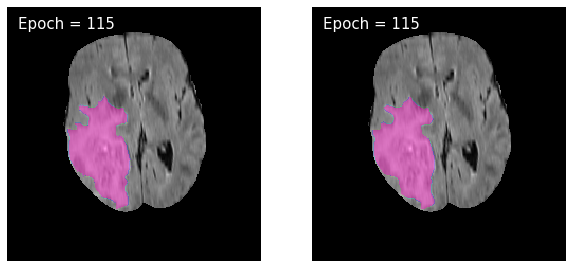

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 117: model 1 : train_loss : 0.001841912454090061, valid_loss : 0.05181124300946699


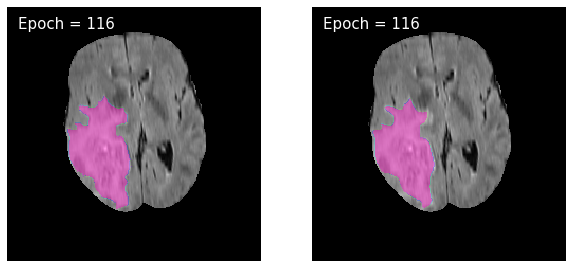

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 118: model 1 : train_loss : 0.004289279523144385, valid_loss : 0.0025366389946129483


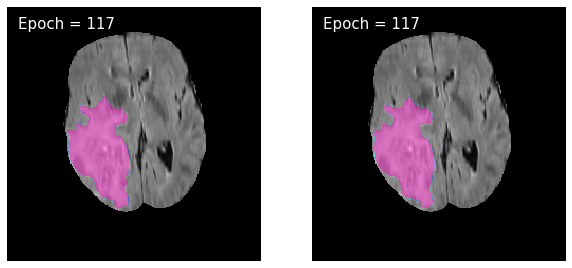

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 119: model 1 : train_loss : 0.001781799683996451, valid_loss : 0.0024377469267015534


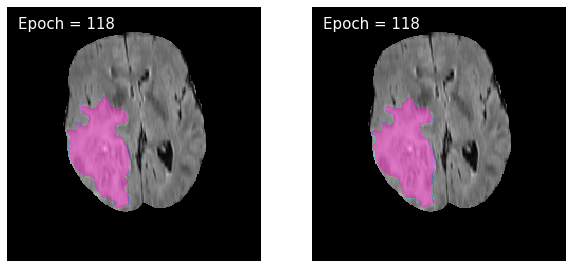

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 120: model 1 : train_loss : 0.0016256590342400424, valid_loss : 0.00218935838922741


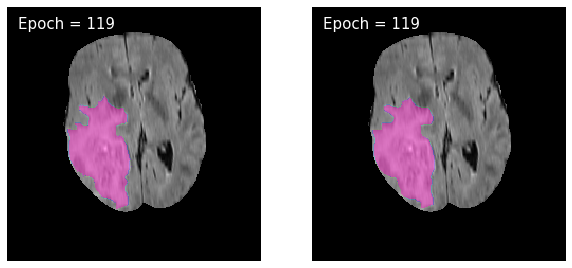

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 121: model 1 : train_loss : 0.0015662496952981969, valid_loss : 0.002344077366079867


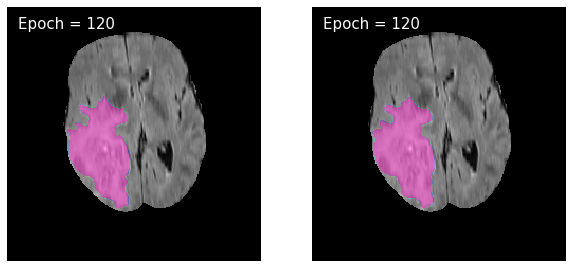

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 122: model 1 : train_loss : 0.001560886708545514, valid_loss : 0.0022186806558362453


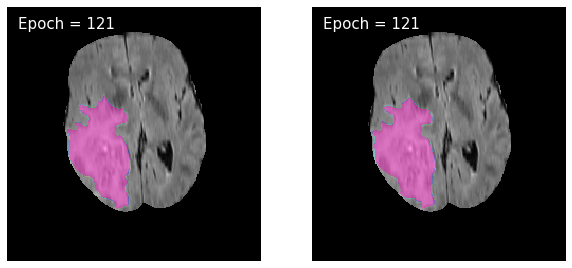

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 123: model 1 : train_loss : 0.001533985785101904, valid_loss : 0.002401816239818569


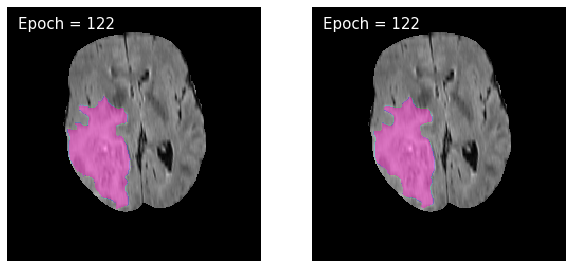

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 124: model 1 : train_loss : 0.0014374132292598119, valid_loss : 0.0023876639228157357


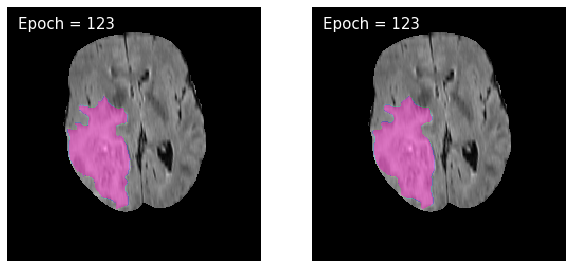

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 125: model 1 : train_loss : 0.0014804946903835665, valid_loss : 0.002220977567627405


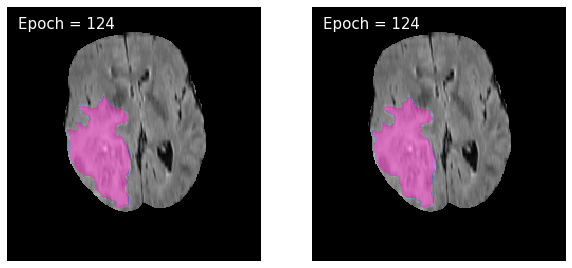

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 126: model 1 : train_loss : 0.0016644554247895187, valid_loss : 0.002751579156383893


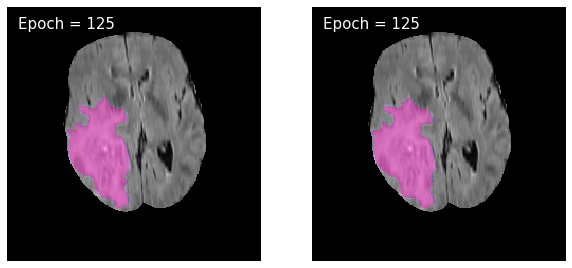

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 127: model 1 : train_loss : 0.001618495583002405, valid_loss : 0.0024281197951083315


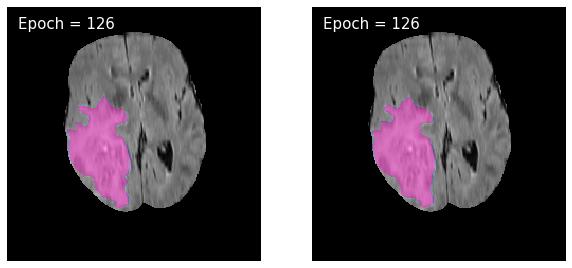

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 128: model 1 : train_loss : 0.0037003976334167867, valid_loss : 0.010591161395818598


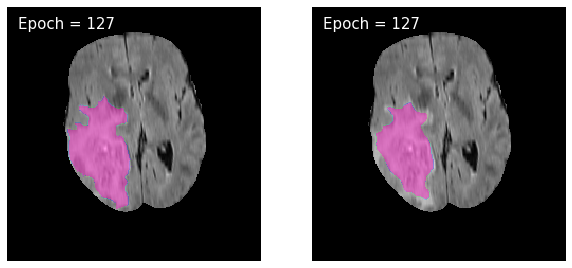

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 129: model 1 : train_loss : 0.004884755176450886, valid_loss : 0.0029316173995606663


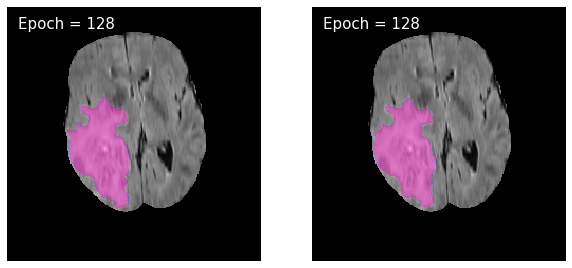

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 130: model 1 : train_loss : 0.0020543725868163295, valid_loss : 0.0022847847963896766


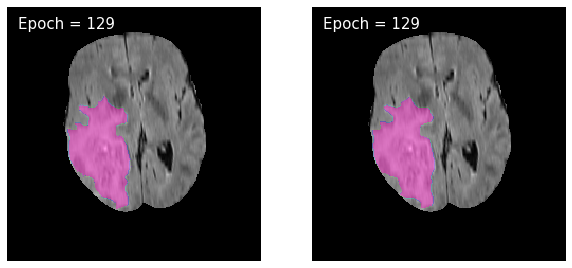

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 131: model 1 : train_loss : 0.0016600030482124965, valid_loss : 0.0022226496631670106


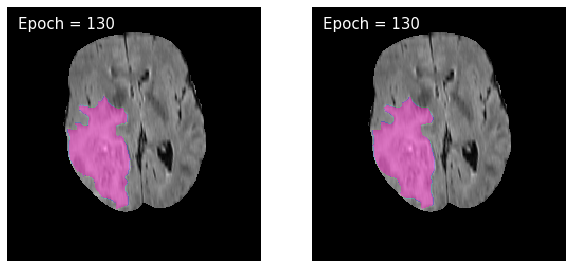

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 132: model 1 : train_loss : 0.0015598158625144145, valid_loss : 0.00224370354661367


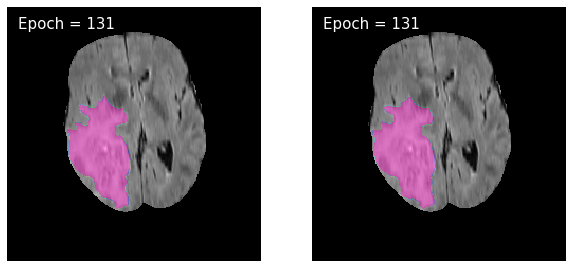

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 133: model 1 : train_loss : 0.0014302917775300661, valid_loss : 0.002160160312077531


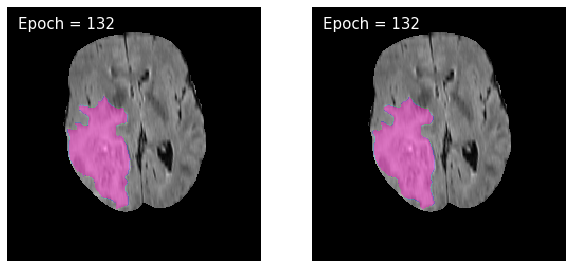

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 134: model 1 : train_loss : 0.0014259090309581713, valid_loss : 0.0022912775244747726


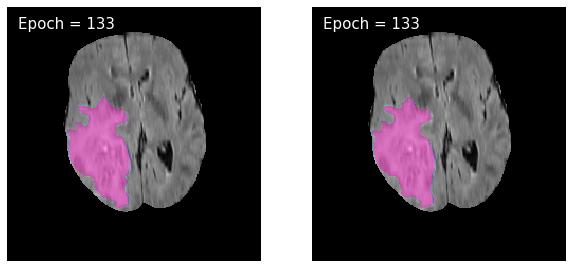

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 135: model 1 : train_loss : 0.0014584607096363549, valid_loss : 0.002273556725285323


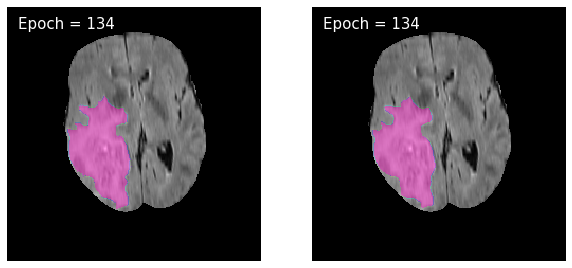

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 136: model 1 : train_loss : 0.0014223393581277576, valid_loss : 0.002321070150619264


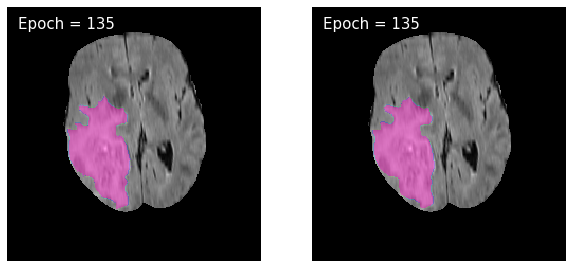

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 137: model 1 : train_loss : 0.0015163036205494771, valid_loss : 0.0029842481571413612


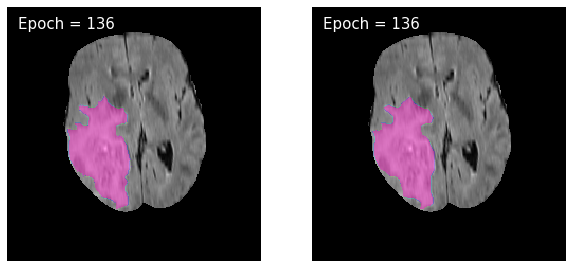

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 138: model 1 : train_loss : 0.0016234409461481293, valid_loss : 0.002752359890081494


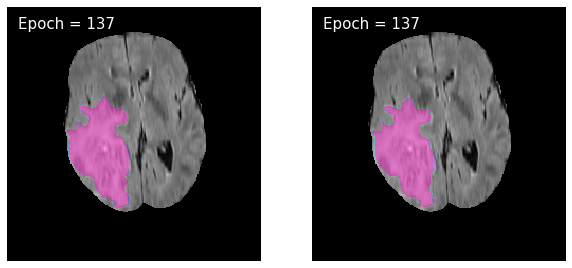

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 139: model 1 : train_loss : 0.007352655960542728, valid_loss : 0.009395567186465899


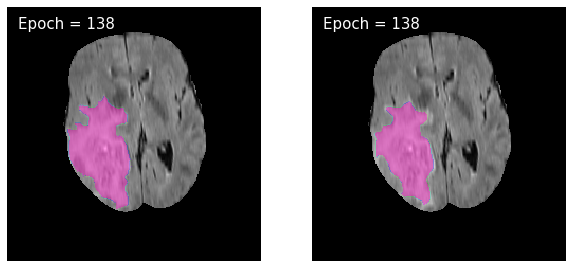

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 140: model 1 : train_loss : 0.006908154342181864, valid_loss : 0.004018363303187556


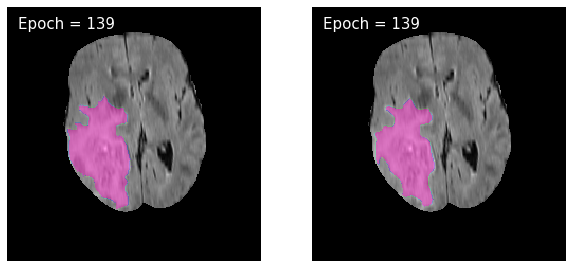

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 141: model 1 : train_loss : 0.0028038687694267803, valid_loss : 0.002960368292779351


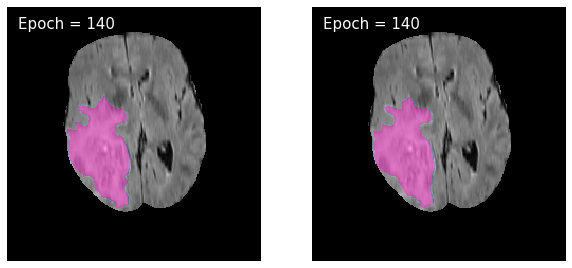

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 142: model 1 : train_loss : 0.0019010350960825418, valid_loss : 0.00218994296558469


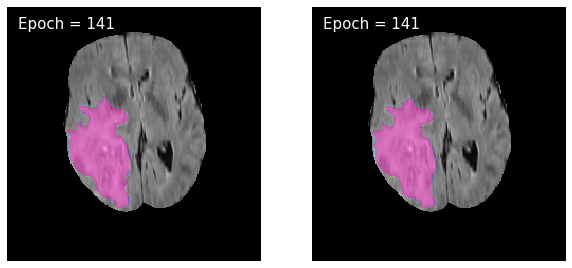

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 143: model 1 : train_loss : 0.001706712748586614, valid_loss : 0.0023664856656501927


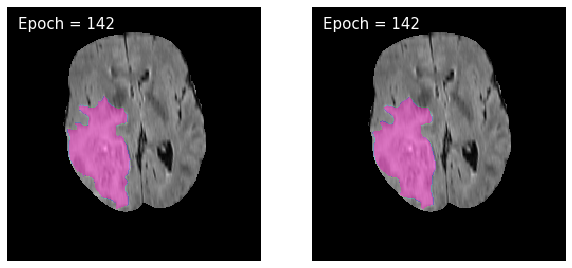

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 144: model 1 : train_loss : 0.0016970035940358996, valid_loss : 0.0025564372717118244


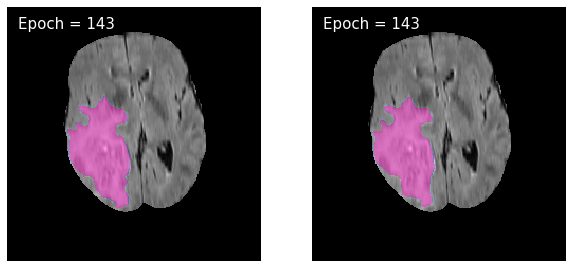

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 145: model 1 : train_loss : 0.001612085020271186, valid_loss : 0.0025154902299860627


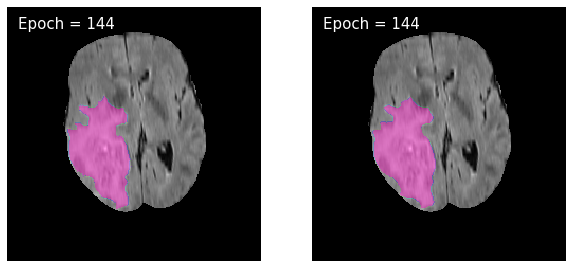

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 146: model 1 : train_loss : 0.0014801607208007799, valid_loss : 0.002236750787630427


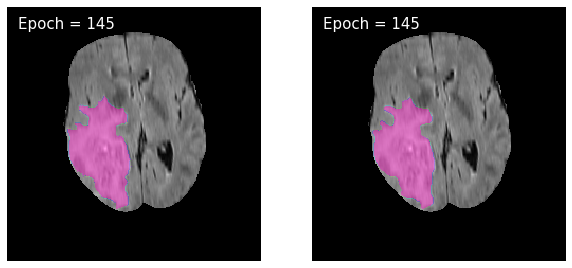

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 147: model 1 : train_loss : 0.0014868351230916742, valid_loss : 0.002208179035659609


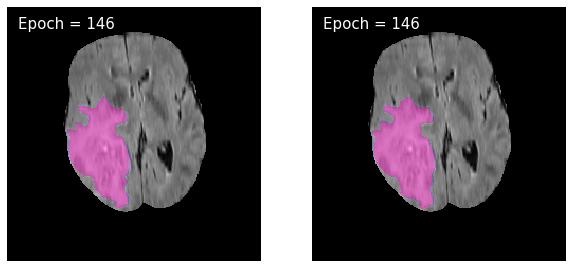

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 148: model 1 : train_loss : 0.0014521727522081, valid_loss : 0.0023253226062431532


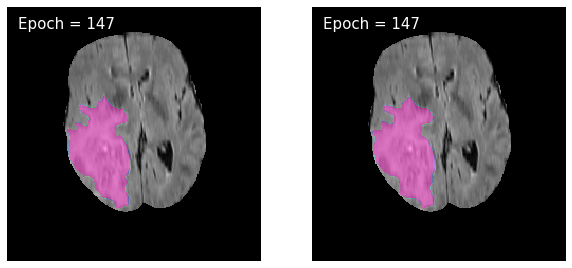

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 149: model 1 : train_loss : 0.0014887680103390188, valid_loss : 0.0022594968102213316


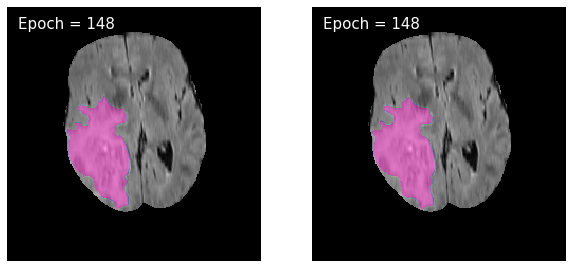

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 150: model 1 : train_loss : 0.001855416916885311, valid_loss : 0.0024362958290351055


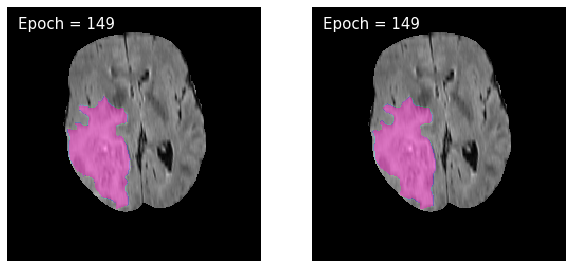

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 151: model 1 : train_loss : 0.0015357466595581873, valid_loss : 0.00239964794033455


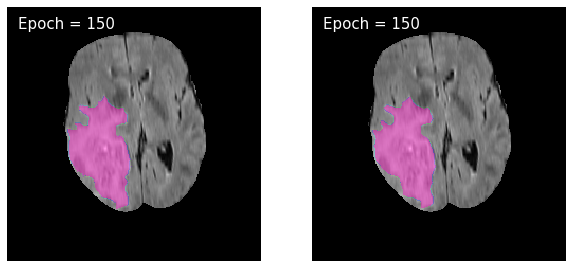

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 152: model 1 : train_loss : 0.0014923076829580634, valid_loss : 0.0022688158734490526


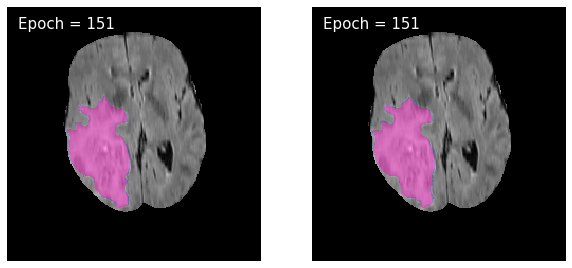

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 153: model 1 : train_loss : 0.0014958318721485554, valid_loss : 0.003271398114837552


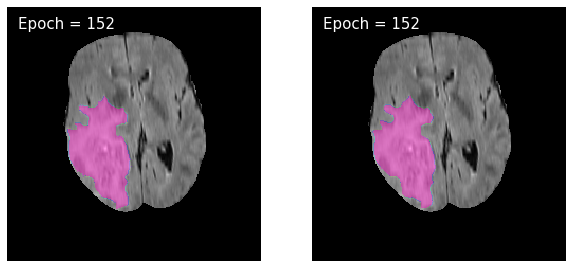

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 154: model 1 : train_loss : 0.0045743013048154335, valid_loss : 0.004207428555683466


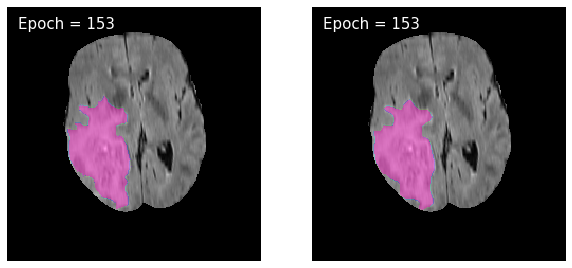

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 155: model 1 : train_loss : 0.0028559614587684093, valid_loss : 0.0025782950743882213


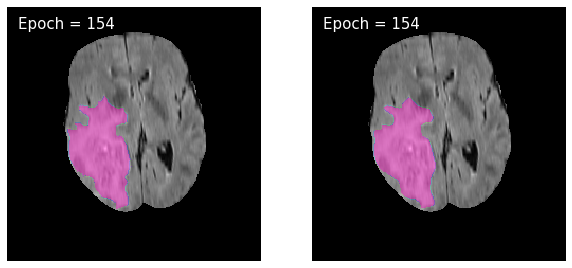

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 156: model 1 : train_loss : 0.0020600242924535372, valid_loss : 0.0023356139828385734


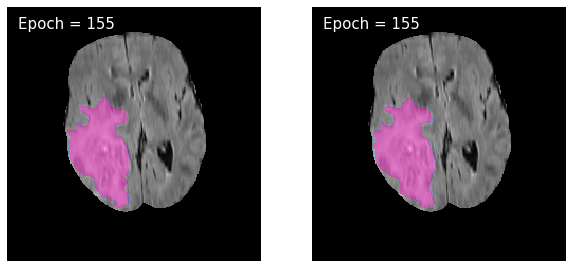

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 157: model 1 : train_loss : 0.0017563489462239605, valid_loss : 0.002216644574515333


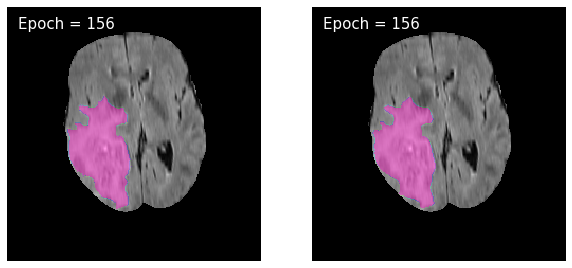

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 158: model 1 : train_loss : 0.0015751150283327454, valid_loss : 0.00216671837010565


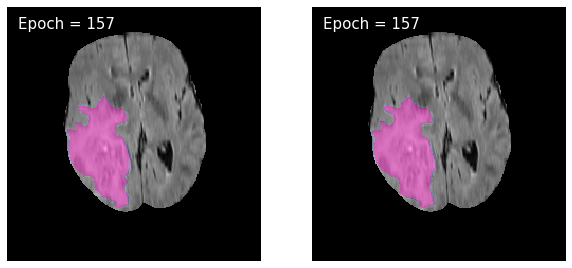

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 159: model 1 : train_loss : 0.001464830774511226, valid_loss : 0.002137830989843188


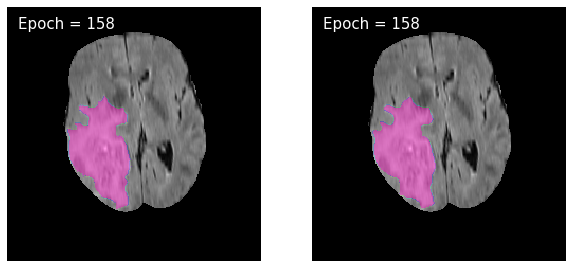

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 160: model 1 : train_loss : 0.00137104373859646, valid_loss : 0.002168097333892313


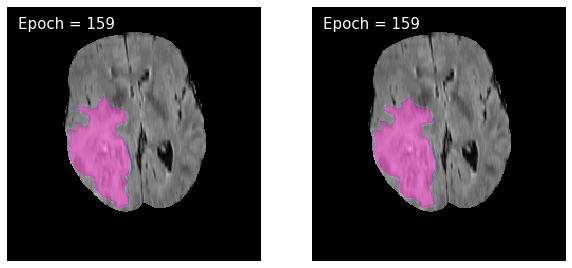

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 161: model 1 : train_loss : 0.0013073093942923876, valid_loss : 0.0021200909743302986


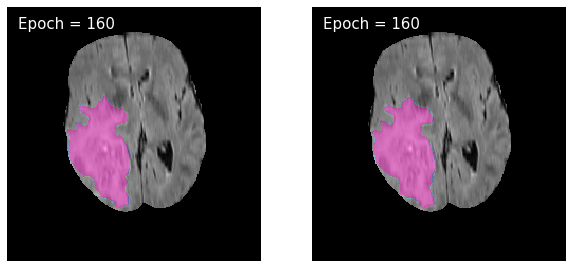

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 162: model 1 : train_loss : 0.0012515813908288553, valid_loss : 0.0021286829599447875


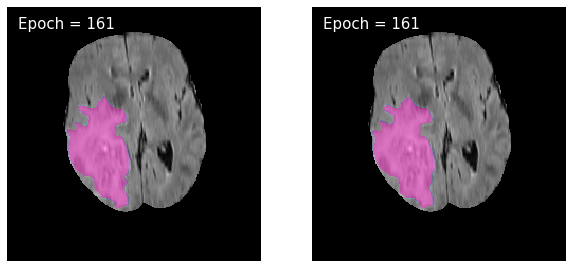

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 163: model 1 : train_loss : 0.0012125932811289874, valid_loss : 0.002152418827703669


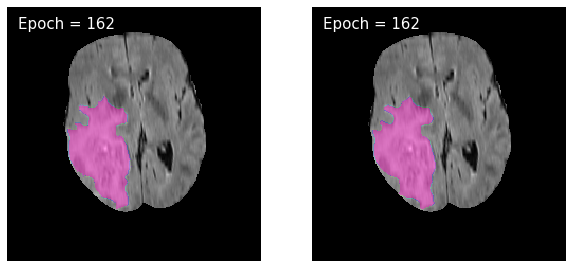

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 164: model 1 : train_loss : 0.0011808440318437255, valid_loss : 0.002156845244511321


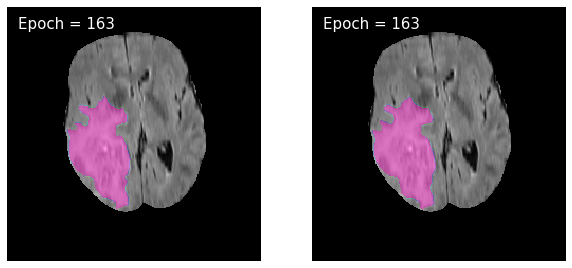

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 165: model 1 : train_loss : 0.0011496968257992096, valid_loss : 0.0022027868601627704


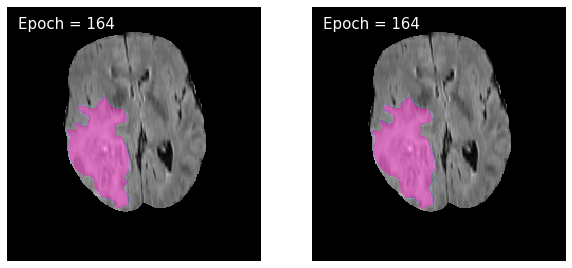

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 166: model 1 : train_loss : 0.0011193484355789239, valid_loss : 0.002151074290533543


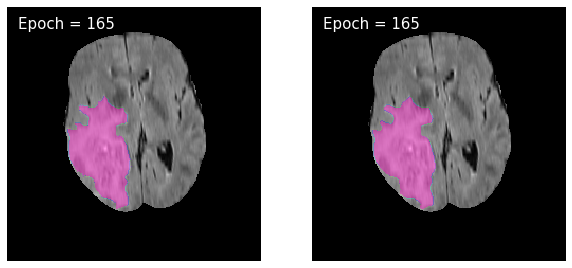

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 167: model 1 : train_loss : 0.0010992317574216582, valid_loss : 0.0022115962089801176


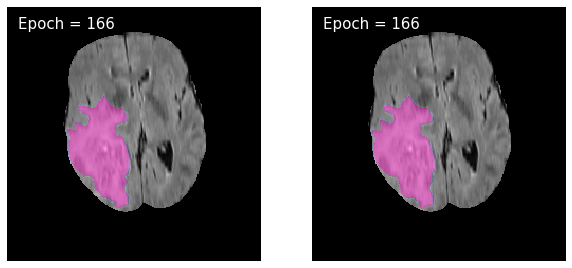

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 168: model 1 : train_loss : 0.0010826572238461644, valid_loss : 0.0022193603860031015


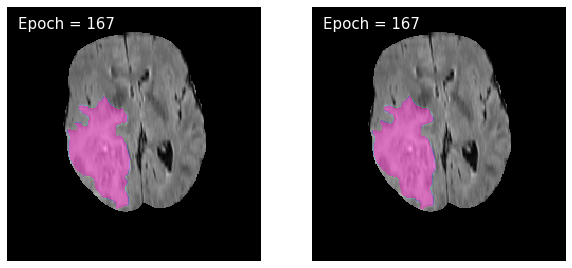

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 169: model 1 : train_loss : 0.001061529677258477, valid_loss : 0.0022060903349870125


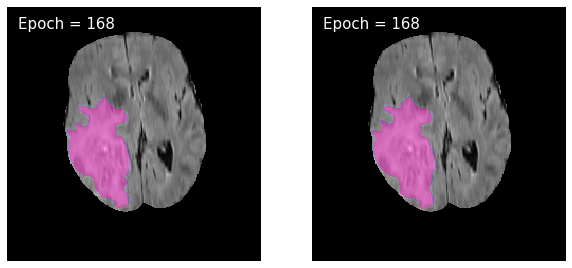

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 170: model 1 : train_loss : 0.0010469885012387636, valid_loss : 0.002232595918989934


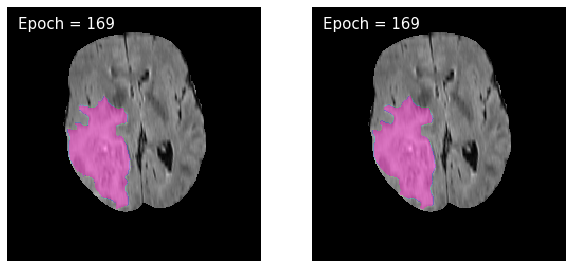

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 171: model 1 : train_loss : 0.0010198576111678647, valid_loss : 0.002252552532040978


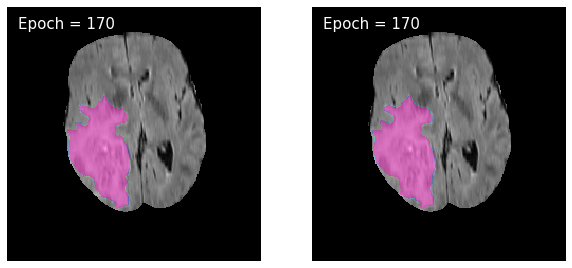

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 172: model 1 : train_loss : 0.001009447925650824, valid_loss : 0.00226263215102221


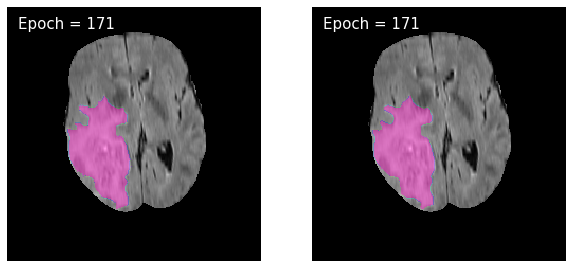

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 173: model 1 : train_loss : 0.000996445044886773, valid_loss : 0.00224738932451696


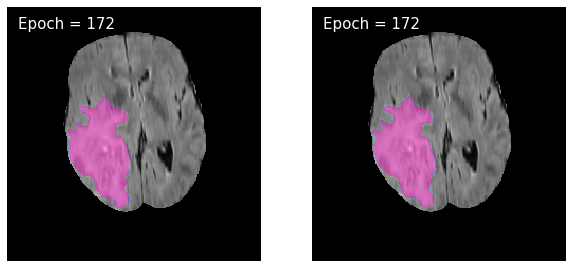

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 174: model 1 : train_loss : 0.0009839269084028106, valid_loss : 0.0022769268522488425


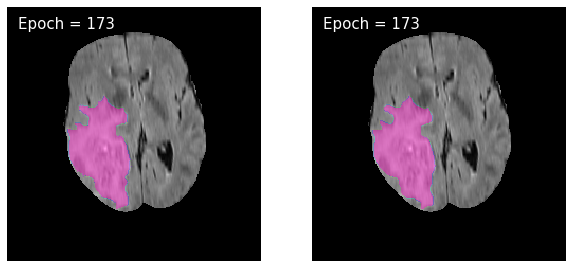

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 175: model 1 : train_loss : 0.0009656868275239363, valid_loss : 0.0022735994460843603


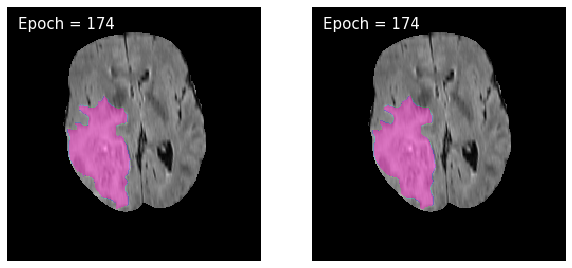

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 176: model 1 : train_loss : 0.0009589936059640949, valid_loss : 0.0022727540019013945


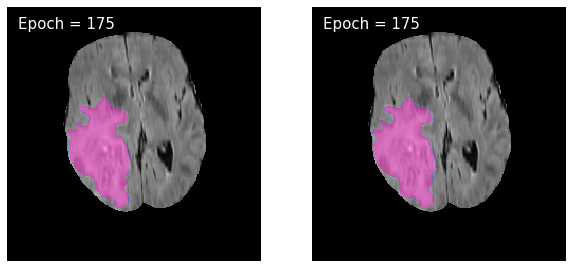

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 177: model 1 : train_loss : 0.0009476588909707169, valid_loss : 0.002311197666760854


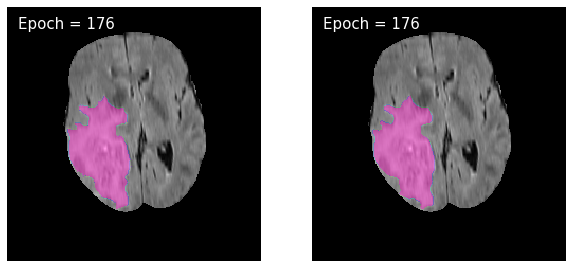

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 178: model 1 : train_loss : 0.0009236035728180248, valid_loss : 0.002329170766034786


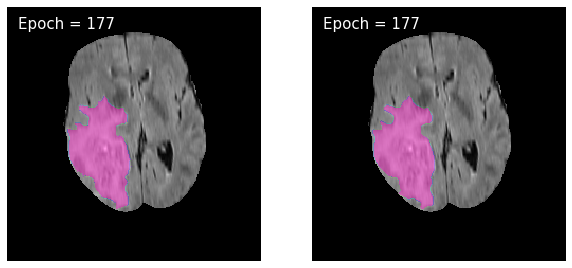

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 179: model 1 : train_loss : 0.0009267604844483846, valid_loss : 0.0023764906041117187


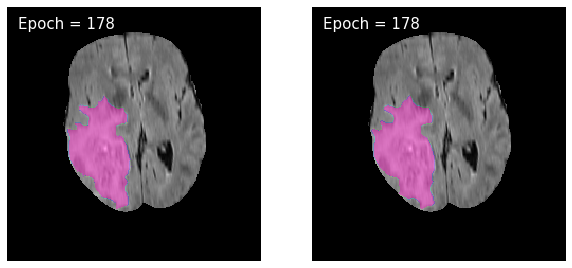

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 180: model 1 : train_loss : 0.000910666046017114, valid_loss : 0.002368451077738045


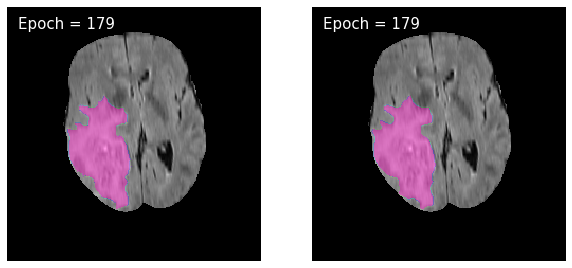

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 181: model 1 : train_loss : 0.0009030885538882042, valid_loss : 0.0023673446322085524


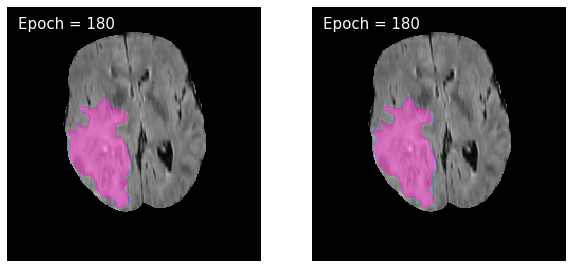

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 182: model 1 : train_loss : 0.0008867948295803432, valid_loss : 0.0023680776881168284


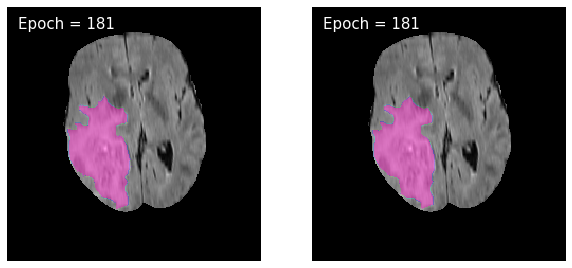

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 183: model 1 : train_loss : 0.0008467824424404311, valid_loss : 0.0023975419386030442


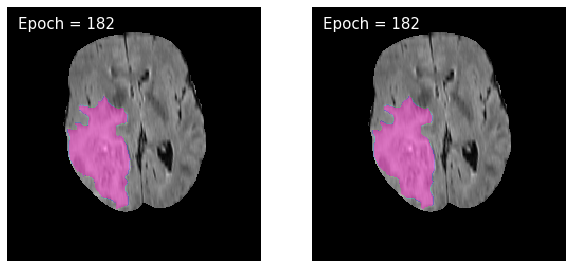

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 184: model 1 : train_loss : 0.0008319063554906952, valid_loss : 0.002410078161934217


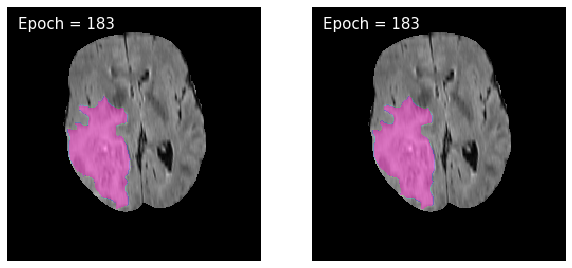

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 185: model 1 : train_loss : 0.0008246268469692965, valid_loss : 0.0024588803795759164


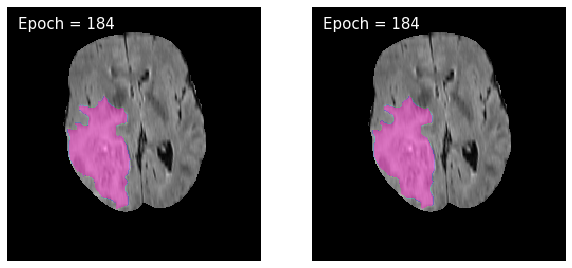

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 186: model 1 : train_loss : 0.0008306206743181379, valid_loss : 0.0024599160487009954


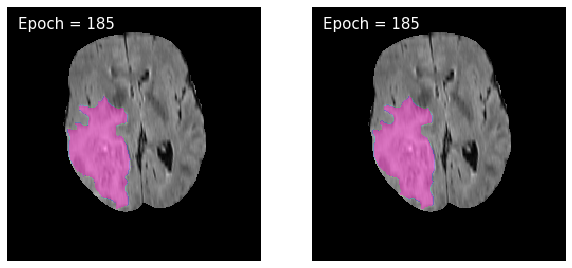

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 187: model 1 : train_loss : 0.0008184376251053271, valid_loss : 0.002481485338355704


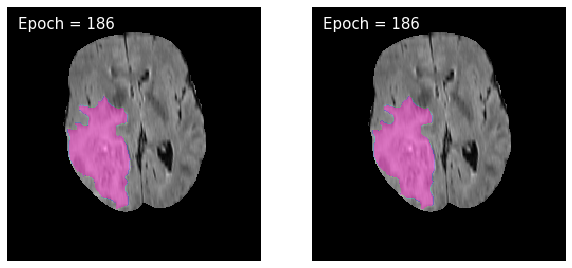

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 188: model 1 : train_loss : 0.0008207059462500954, valid_loss : 0.002490065891395738


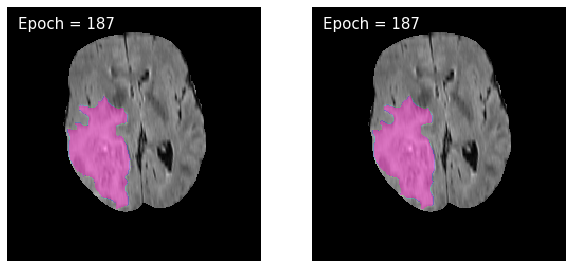

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 189: model 1 : train_loss : 0.0008179085094596321, valid_loss : 0.0024641527644183596


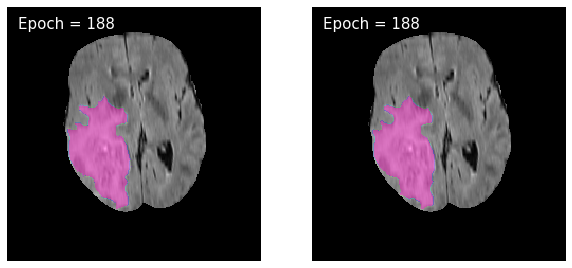

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 190: model 1 : train_loss : 0.0008115469381628691, valid_loss : 0.0024976349094463666


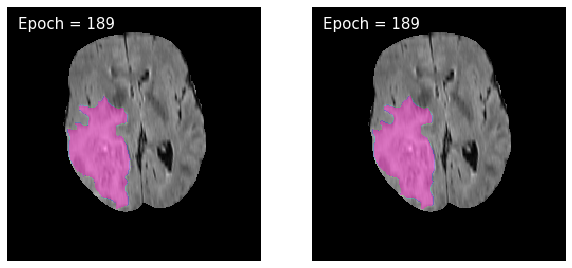

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 191: model 1 : train_loss : 0.00080916456251988, valid_loss : 0.0024929171406825913


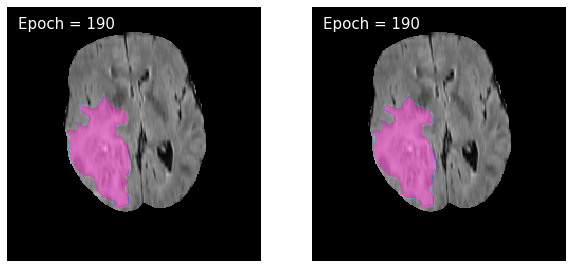

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 192: model 1 : train_loss : 0.0008080609028776313, valid_loss : 0.00248608203611036


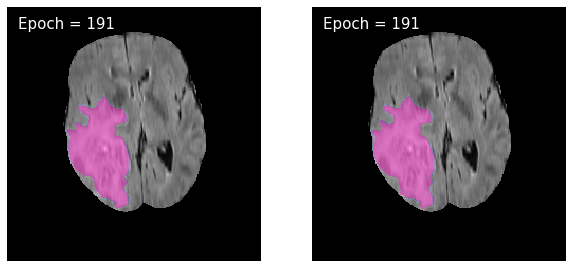

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 193: model 1 : train_loss : 0.0008114116380732801, valid_loss : 0.0025061881521152834


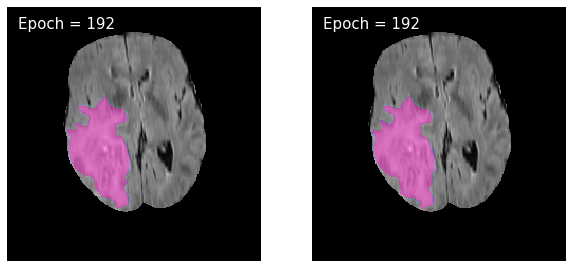

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 194: model 1 : train_loss : 0.0008066419999795013, valid_loss : 0.00249643044674008


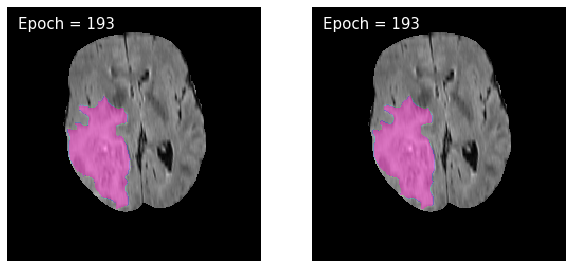

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 195: model 1 : train_loss : 0.0008078754809924455, valid_loss : 0.0024886814815238217


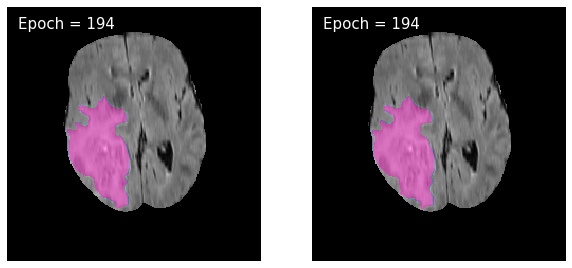

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 196: model 1 : train_loss : 0.0007998223333099255, valid_loss : 0.002521482594441181


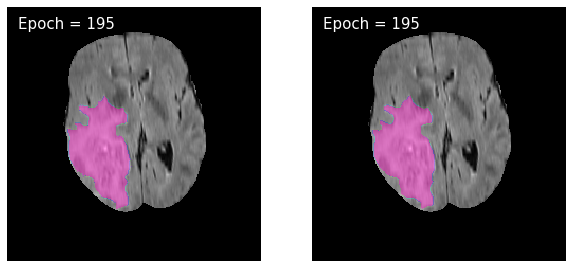

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 197: model 1 : train_loss : 0.0007963714544980355, valid_loss : 0.0025556443539056003


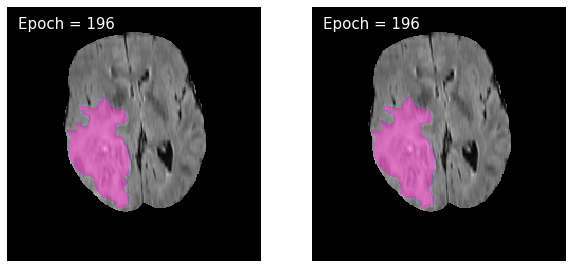

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 198: model 1 : train_loss : 0.0007978433919396913, valid_loss : 0.0025427904805600614


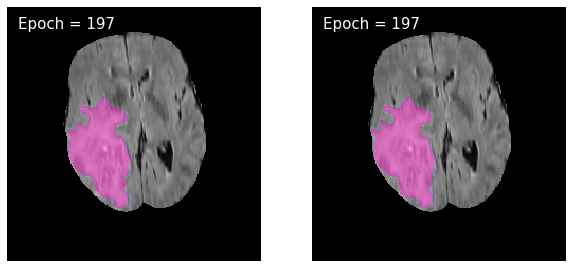

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 199: model 1 : train_loss : 0.0007956588420840161, valid_loss : 0.0025181966322661464


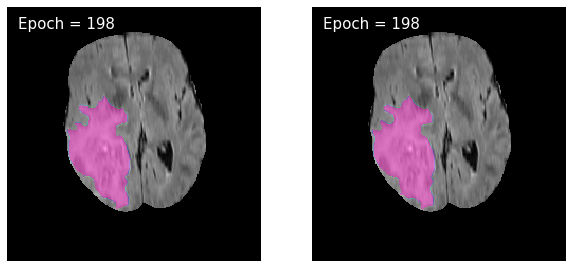

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 200: model 1 : train_loss : 0.0008029284685201082, valid_loss : 0.0025186382777627877


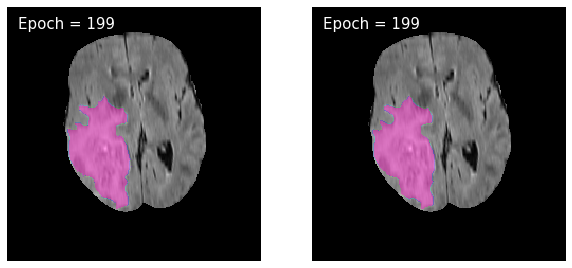

In [21]:
###### model 1 train


loss_1 = 0.
train_loss_1 = 0.
train_loss_2 = 0.

min_valid_loss = np.inf
train_loss_list_1 = []
valid_loss_list_1 = []

for i in tqdm(range(num_epoch)):
    train_loss_1 = 0.0
    valid_loss_1 = 0.0
    model_1.train()
    for image,label in tqdm(train_loader, leave=False):
        ########################
        # model 1 
        #######################
        
        image,label= image.to(device), label.to(device)
     
        optimizer_1.zero_grad()
        output = model_1(image)

        
        loss_1 = loss_func(output, (torch.sum(label[:,1:], axis = 1).unsqueeze(1)))  #0:normal data 
        # loss_1 += loss_func(output[:,0], label[:, 0])
     
        loss_1.backward()        
        optimizer_1.step()

        train_loss_1 += loss_1.item()*image.size(0)#
        
        
        
    ##### model valide        
    model_1.eval()
    
    for image, label in tqdm(valid_loader, leave=False):
      
        image ,label = image.to(device), label.to(device)
        
        output = model_1(image)
        loss_1 = loss_func(output, (torch.sum(label[:,1:], axis = 1).unsqueeze(1)))  #0:normal data 
        # loss_1 += loss_func(output[:,0], label[:, 0])
        valid_loss_1 += loss_1.item()*image.size(0)
        
    scheduler_1.step(valid_loss_1)
    
    if min_valid_loss>=valid_loss_1:
        # torch.save(model.module.state_dict(),'model_best_'+ str(fold) + '.pt')
        # torch.save(model.state_dict(), './model/3x3_model_{}.pt'.format(i+1))
        torch.save(model_1.state_dict(), f'./model/{save_1}.pt')
    

    
    
    train_loss_1 = train_loss_1/len(train_loader.sampler)
                                               
    valid_loss_1 = valid_loss_1/len(valid_loader.sampler)
    print('Epoch {}: model 1 : train_loss : {}, valid_loss : {}'.format(i+1, train_loss_1, valid_loss_1))
    train_loss_list_1.append(train_loss_1)
    valid_loss_list_1.append(valid_loss_1)
    
    
    
        ## 실시간으로 결과를 보여주려고 진행하는 이미지 
    pltimage = pltimage.to(device) # 4stack이미지를 
    pltout = model_1(pltimage)     # 일단 넣고 
    pltout = threshold_img(pltout) # 0.5 매핑 
    pltout = pltout.squeeze().detach().cpu().numpy()
    
    # imshow1(plt1)
    # Bimshow(pltout, i)  
    # param = pltout[1] + pltout[2]*2 +pltout[3]*3 +pltout[4]*4
    # Bimshow_2(plt1,show_label,pltout,i)
    Bimshow_2(plt1,np.sum(plt2,axis=0),pltout,i)

    plt.savefig('./image/model_1/model_1_{}th_result.png'.format(i), dpi=300, facecolor='None')
    plt.show()
    

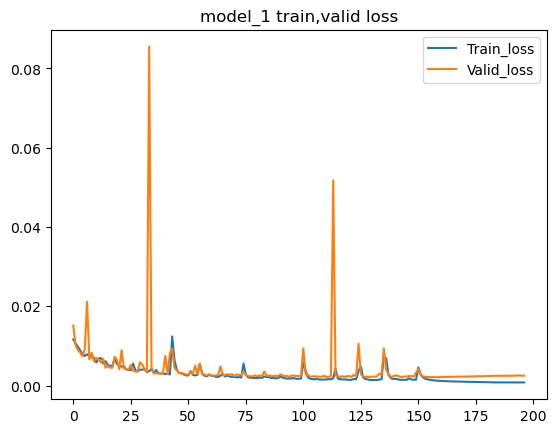

best epoch:  159


<Figure size 640x480 with 0 Axes>

In [23]:
plt.style.use('default')
plt.title('model_1 train,valid loss')
plt.plot(train_loss_list_1[3:],label = 'Train_loss')
plt.plot(valid_loss_list_1[3:],label = 'Valid_loss')
plt.legend()
plt.show()
print('best epoch: ',np.argmin(valid_loss_list_1)-1)
best=  np.argmin(valid_loss_list_1)-1
plt.savefig('./png/model_1 train,valid loss.png', dpi=300, facecolor='w')

Text(0.5, 1.0, 'label[0] reshape')

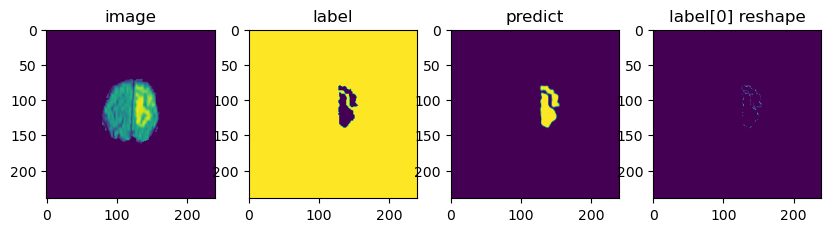

In [24]:
image , label = train_dataset.__getitem__(1200)
# image,label = pltimage , pltlabel
image, label = image.unsqueeze(0).cuda() , label.unsqueeze(0).cuda()
model_1.load_state_dict(torch.load(f"./model/{save_1}.pt"))
model_1.eval()
output = model_1(image)
# image.shape, label.shape
la = label.clone()
l = output*label
la[:,0] = l[:,0]
f, (ax1,ax2,ax3,ax4) = plt.subplots(1,4,figsize = (10,20))
ax1.imshow(image[0][0].detach().cpu().numpy())
ax1.set_title('image')
ax2.imshow(label[0,0].detach().cpu().numpy())
ax2.set_title('label')
ax3.imshow(output[0,0].detach().cpu().numpy())
ax3.set_title('predict')
ax4.imshow(la[0][0].detach().cpu().numpy())
ax4.set_title('label[0] reshape')


In [29]:
def Bimshow_2(original, label,param,i):
    f , (ax1,ax2) = plt.subplots(1,2,figsize = (10,10))
    ax1.imshow(original*0.01, cmap='gray',  interpolation='none')
    ax1.imshow(label, cmap=map_object, alpha=0.4)  
    
    ax1.axis('off')
    ax1.text(10, 20, f'GT',color = 'white',size = 20)

    ax2.imshow(original, cmap='gray',  interpolation='none')
    ax2.imshow(param, cmap=map_object, alpha=0.4)  

    ax2.axis('off')
   
    ax2.text(10, 20, f'Epoch = {i+1}',color = 'white',size = 20)


model_2 = AttentionUNet_2(4,5).to(device)
optimizer_2 = torch.optim.AdamW(model_2.parameters(), lr=learning_rate)
scheduler_2 = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_2,mode='min',patience=20)
num_epoch =120

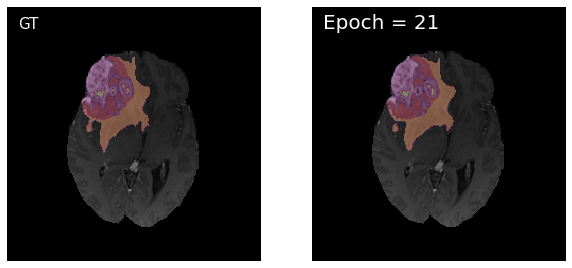

In [32]:
def Bimshow_2(original, label,param,i):
    f , (ax1,ax2) = plt.subplots(1,2,figsize = (10,10))
    ax1.imshow(original*0.01, cmap='gray',  interpolation='none')
    ax1.imshow(label, cmap=map_object, alpha=0.4)  
    
    ax1.axis('off')
    ax1.text(10, 20, f'GT',color = 'white',size = 15)

    ax2.imshow(original, cmap='gray',  interpolation='none')
    ax2.imshow(param, cmap=map_object, alpha=0.4)  

    ax2.axis('off')
   
    ax2.text(10, 20, f'Epoch = {i+1}',color = 'white',size = 20)

with torch.no_grad():
    pltimage = pltimage.to(device) # 4stack이미지를 
    output_1 = model_1(pltimage)     # 일단 넣고 
    pltout = model_2(pltimage)

    check = threshold_img(output_1) # 0.5 매핑
    pltout = pltout*check
    pltout[:,0] = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).squeeze().float()        
    pltout = threshold_img(pltout)
    # imshow1(plt1)
    pltout = pltout.squeeze().detach().cpu().numpy()
    param = pltout[1]*5+ pltout[2]*4 +pltout[3]*3 +pltout[4]*2 
    # Bimshow(param, i)    
    Bimshow_2(plt1*0.01,show_label,param,i)
    # plt.savefig('./image/model_2/macro_4_to_5_{}th_result.png'.format(i), dpi=300, facecolor='None')
    plt.show()     

  0%|          | 0/120 [00:00<?, ?it/s]

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 1: model 2 : train_loss : 0.021270056632795357, valid_loss : 0.021432262364068002


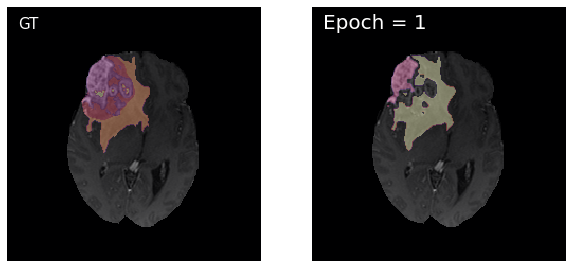

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 2: model 2 : train_loss : 0.020855360066464018, valid_loss : 0.02258005133039513


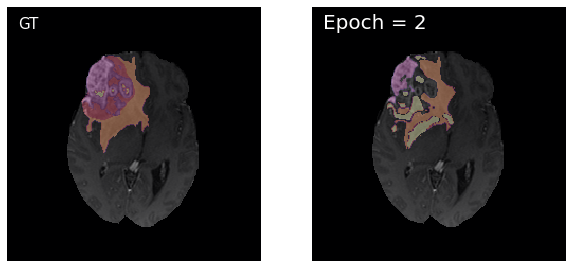

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 3: model 2 : train_loss : 0.02053865261888444, valid_loss : 0.021269720600841577


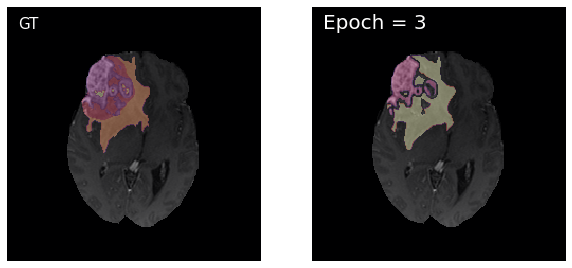

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 4: model 2 : train_loss : 0.020447865069137525, valid_loss : 0.021360468162373598


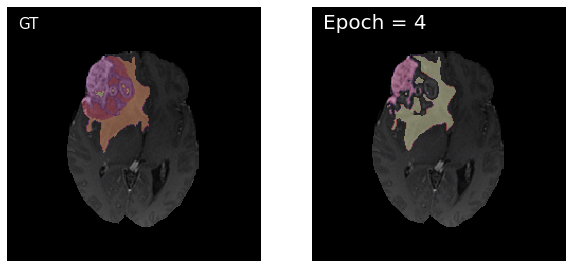

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 5: model 2 : train_loss : 0.020324693145792955, valid_loss : 0.020844186488517075


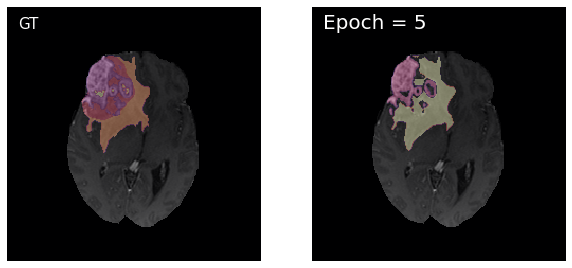

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 6: model 2 : train_loss : 0.020199447309924394, valid_loss : 0.02077594549767235


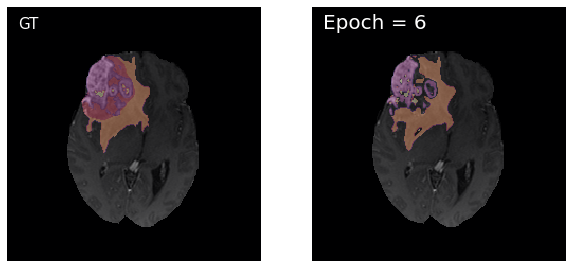

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 7: model 2 : train_loss : 0.02008154835640265, valid_loss : 0.020428746851354835


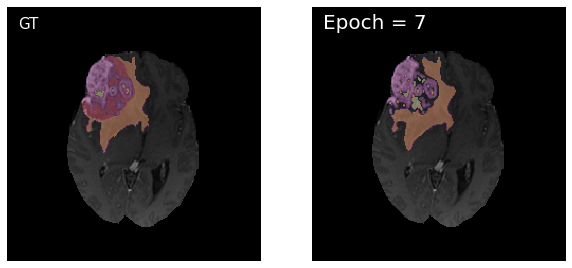

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 8: model 2 : train_loss : 0.02007150097429269, valid_loss : 0.02115440065550032


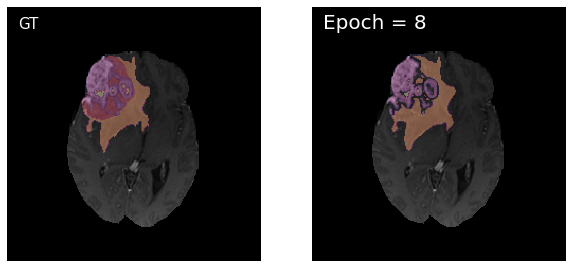

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 9: model 2 : train_loss : 0.019930585155990683, valid_loss : 0.02082764379973855


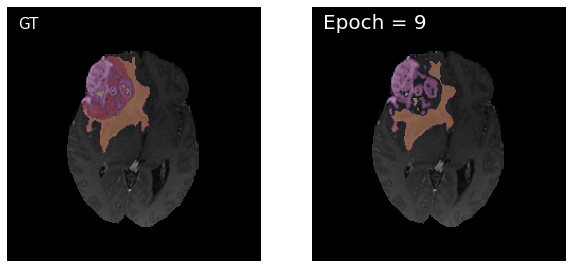

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 10: model 2 : train_loss : 0.01993071187081303, valid_loss : 0.020538113500171228


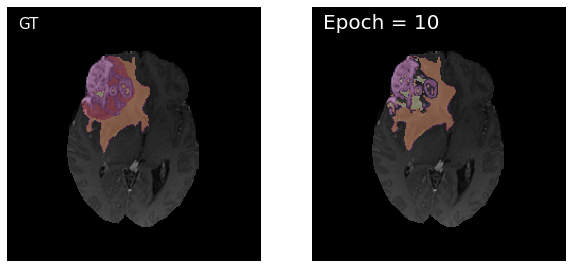

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 11: model 2 : train_loss : 0.019809620805976442, valid_loss : 0.02029244217156966


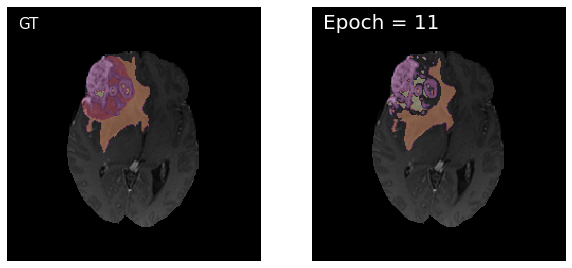

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 12: model 2 : train_loss : 0.019885359423118382, valid_loss : 0.020432338405366717


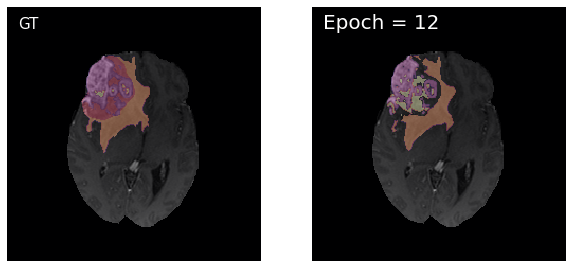

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 13: model 2 : train_loss : 0.019789480114349434, valid_loss : 0.020242998311787427


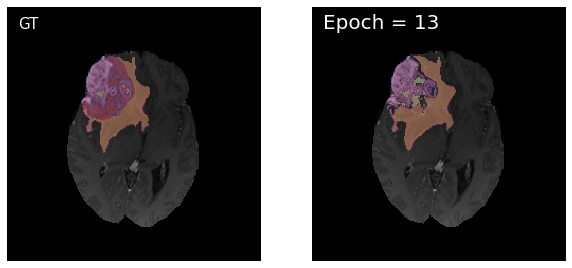

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 14: model 2 : train_loss : 0.01968346341639149, valid_loss : 0.02006795248630086


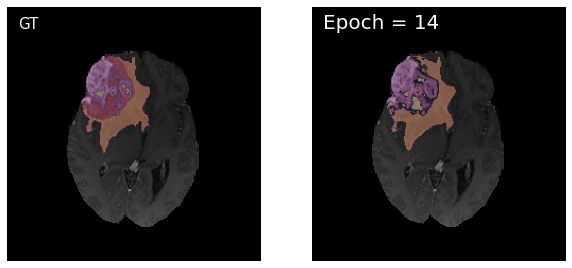

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 15: model 2 : train_loss : 0.01963551944760831, valid_loss : 0.02011738106281677


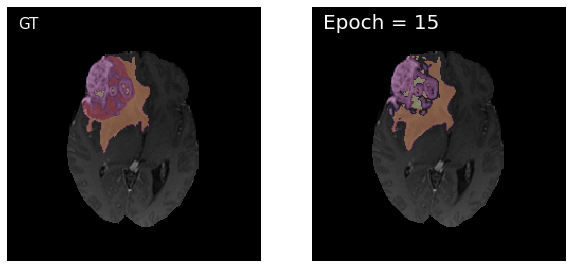

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 16: model 2 : train_loss : 0.019548998390880708, valid_loss : 0.020101548518806505


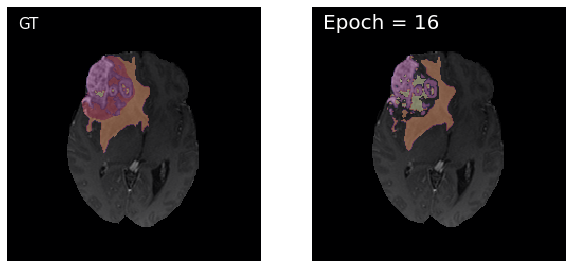

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 17: model 2 : train_loss : 0.019534656872776997, valid_loss : 0.02108196396249539


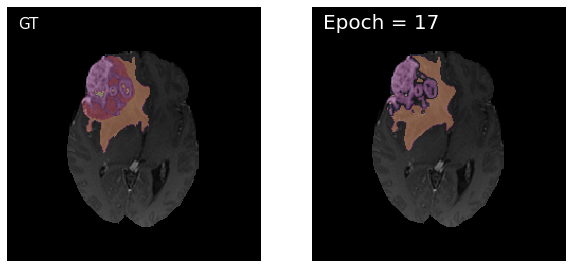

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 18: model 2 : train_loss : 0.019578583913821918, valid_loss : 0.019874596083912278


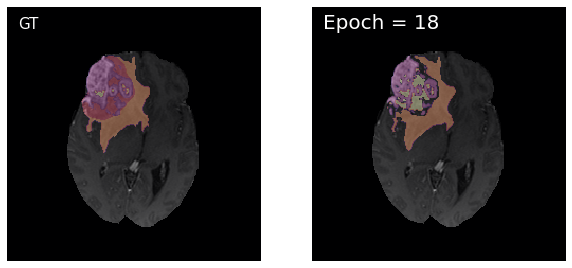

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 19: model 2 : train_loss : 0.019377299698780163, valid_loss : 0.020232383182594023


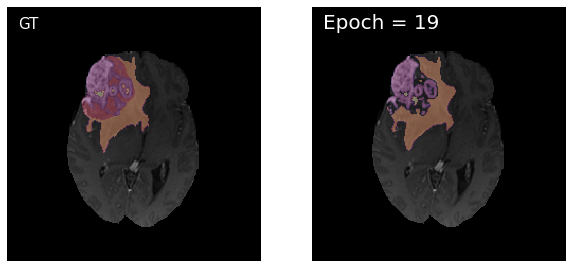

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 20: model 2 : train_loss : 0.019316992425032677, valid_loss : 0.019787531753849258


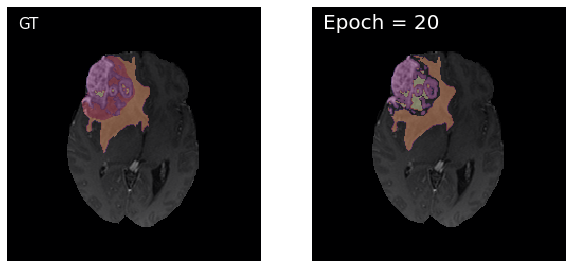

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 21: model 2 : train_loss : 0.019340918829244765, valid_loss : 0.020188285764766813


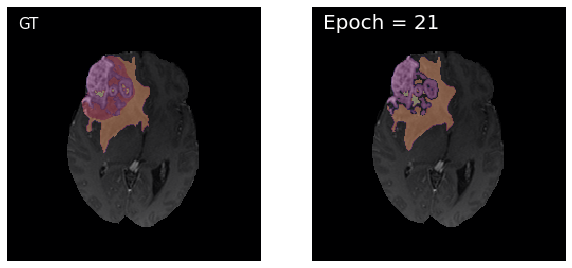

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 22: model 2 : train_loss : 0.01927580427840952, valid_loss : 0.01982293454808138


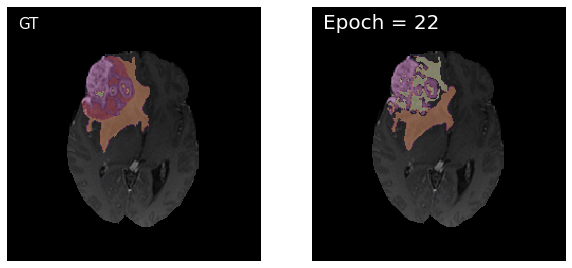

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 23: model 2 : train_loss : 0.019274672453231292, valid_loss : 0.01970615049355328


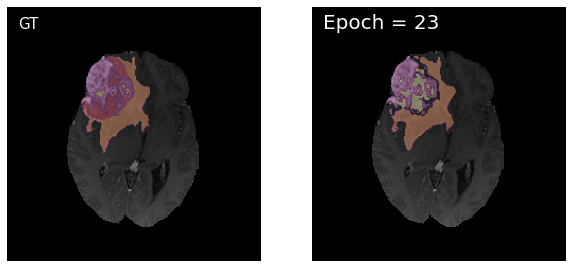

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 24: model 2 : train_loss : 0.019172375439405774, valid_loss : 0.019845872828286263


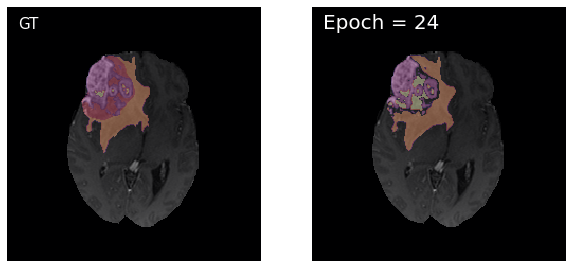

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 25: model 2 : train_loss : 0.01931096385576881, valid_loss : 0.021019676206408128


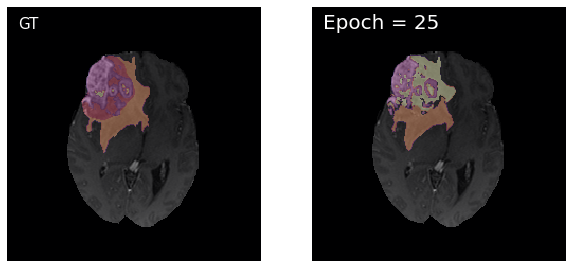

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 26: model 2 : train_loss : 0.01934138590822067, valid_loss : 0.020173905005722973


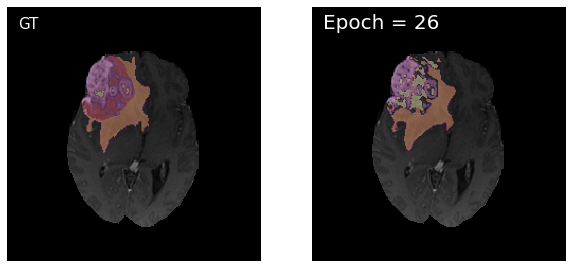

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 27: model 2 : train_loss : 0.019259764339151882, valid_loss : 0.020061527339543493


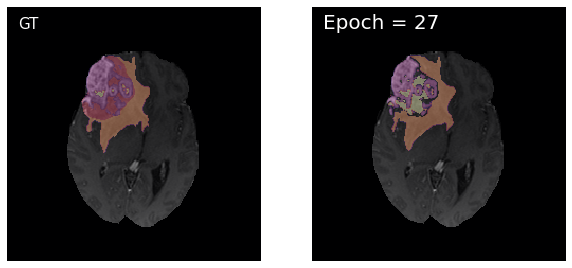

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 28: model 2 : train_loss : 0.019061965287883894, valid_loss : 0.019657784895874404


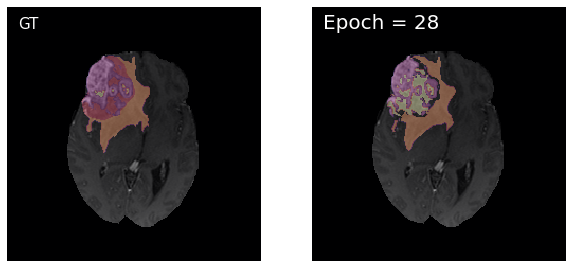

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 29: model 2 : train_loss : 0.019099586106257584, valid_loss : 0.019517415323637686


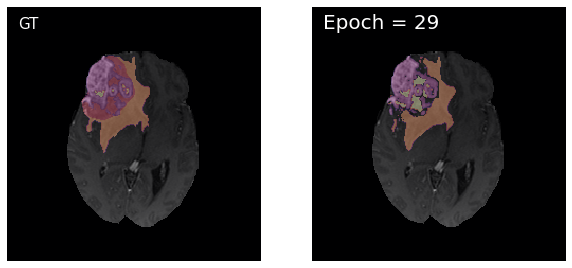

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 30: model 2 : train_loss : 0.01916431813288305, valid_loss : 0.019852791157014722


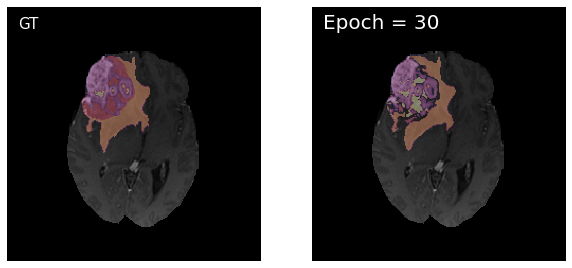

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 31: model 2 : train_loss : 0.019121317521583546, valid_loss : 0.019636286795014134


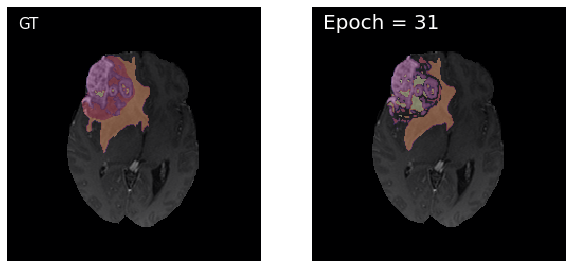

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 32: model 2 : train_loss : 0.019028854608469096, valid_loss : 0.01956013657141856


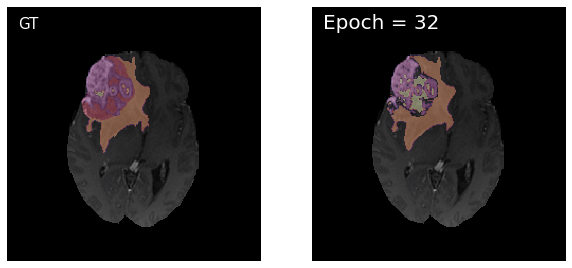

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 33: model 2 : train_loss : 0.018972521929082855, valid_loss : 0.01971813078962832


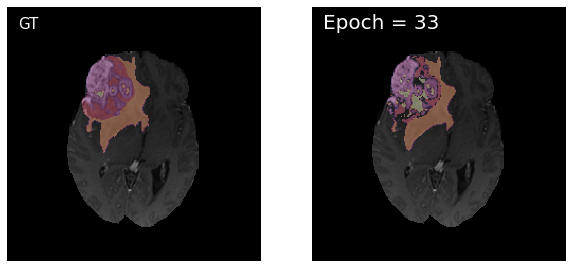

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 34: model 2 : train_loss : 0.018925954272628862, valid_loss : 0.01941805258418323


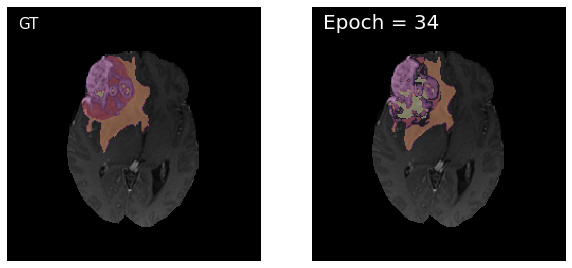

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 35: model 2 : train_loss : 0.018932977126665432, valid_loss : 0.019309768137831543


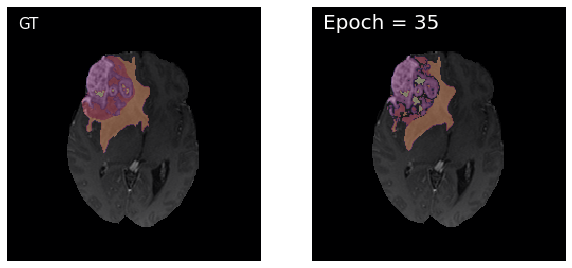

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 36: model 2 : train_loss : 0.018879699559571844, valid_loss : 0.019382644881026805


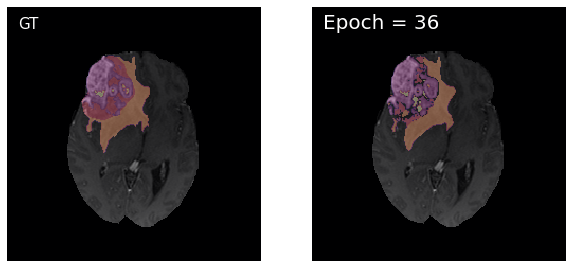

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 37: model 2 : train_loss : 0.018876420297780777, valid_loss : 0.019293127968119987


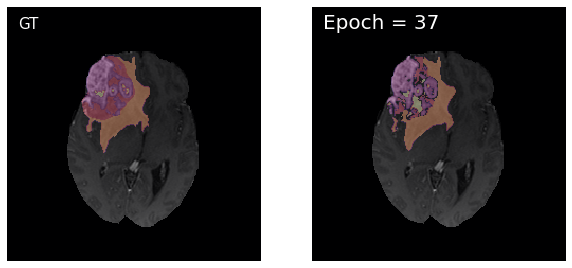

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 38: model 2 : train_loss : 0.01887052246031895, valid_loss : 0.019193467429744565


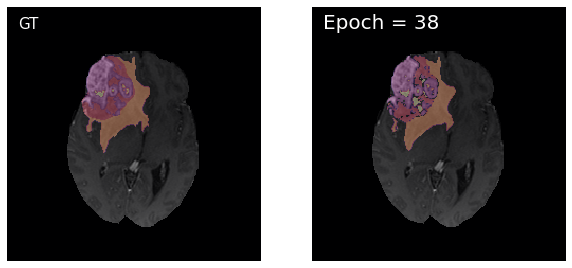

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 39: model 2 : train_loss : 0.01888859913485454, valid_loss : 0.01930889792919349


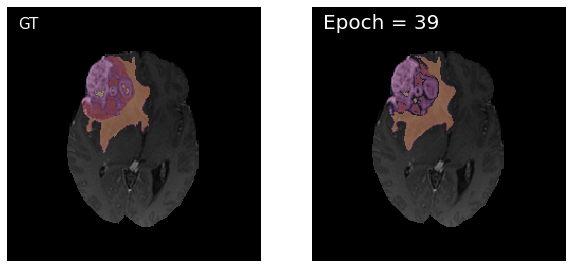

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 40: model 2 : train_loss : 0.018794978942234544, valid_loss : 0.019216694190324613


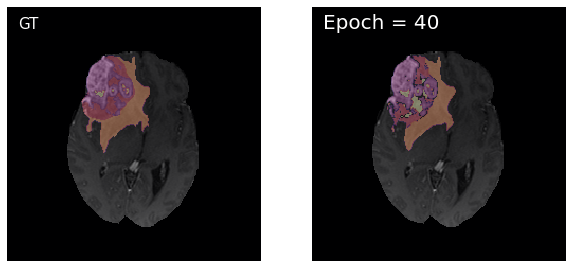

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 41: model 2 : train_loss : 0.018757944864635532, valid_loss : 0.019362084004872788


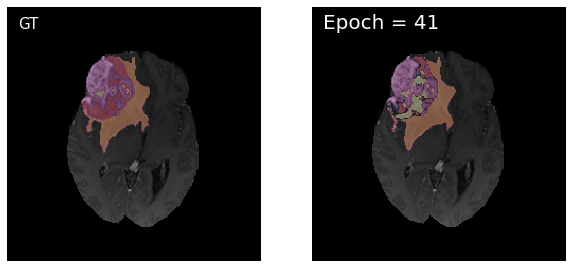

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 42: model 2 : train_loss : 0.018835965437206212, valid_loss : 0.020485327502096733


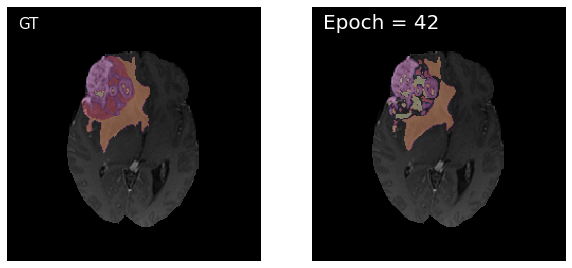

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 43: model 2 : train_loss : 0.018893480480735043, valid_loss : 0.019255387747781703


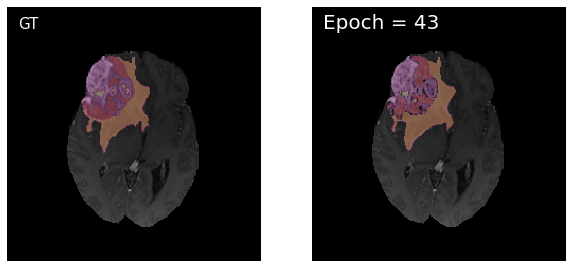

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 44: model 2 : train_loss : 0.01869066767079414, valid_loss : 0.01915358254602755


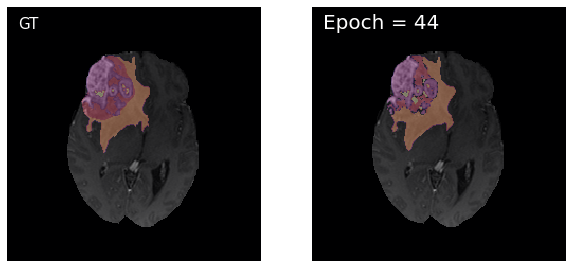

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 45: model 2 : train_loss : 0.01867745280402798, valid_loss : 0.01907739183599172


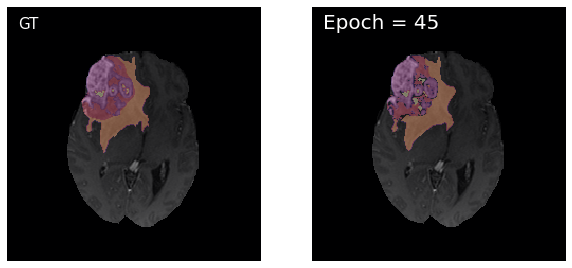

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 46: model 2 : train_loss : 0.01865083265969409, valid_loss : 0.0191185570628115


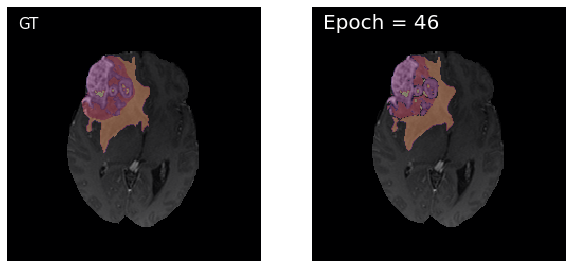

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 47: model 2 : train_loss : 0.018765570983911555, valid_loss : 0.019104645136863954


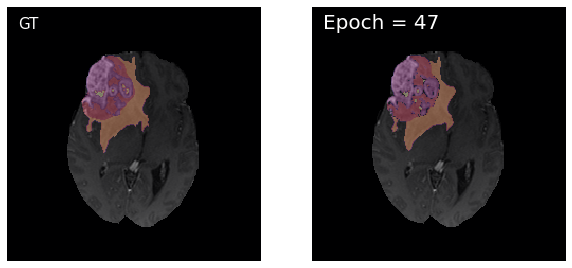

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 48: model 2 : train_loss : 0.018646142633930808, valid_loss : 0.01913189867189685


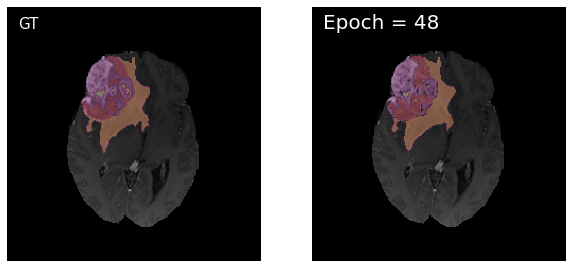

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 49: model 2 : train_loss : 0.018636482166281592, valid_loss : 0.019222118877380165


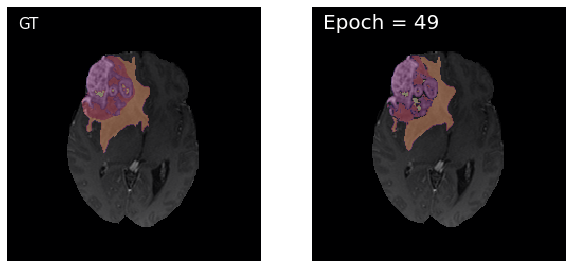

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 50: model 2 : train_loss : 0.018627713995118953, valid_loss : 0.019024245540398017


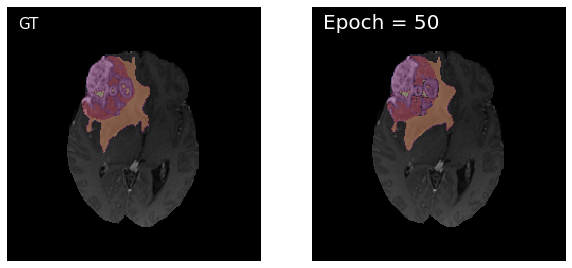

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 51: model 2 : train_loss : 0.018578503231395045, valid_loss : 0.01908754951149095


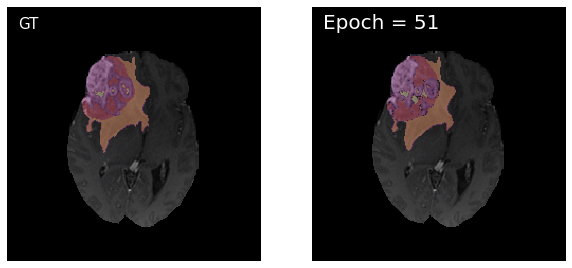

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 52: model 2 : train_loss : 0.018725561186665008, valid_loss : 0.019113019337925825


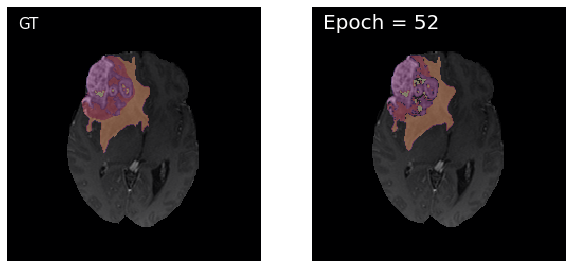

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 53: model 2 : train_loss : 0.018601338853080334, valid_loss : 0.019288692569941587


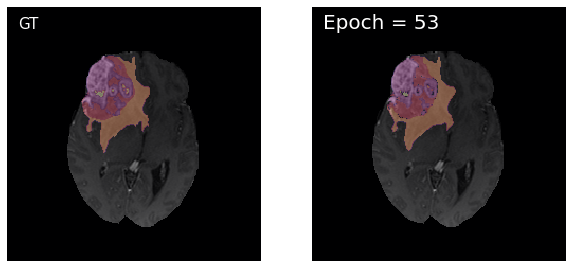

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 54: model 2 : train_loss : 0.018580814469313995, valid_loss : 0.01908728860003213


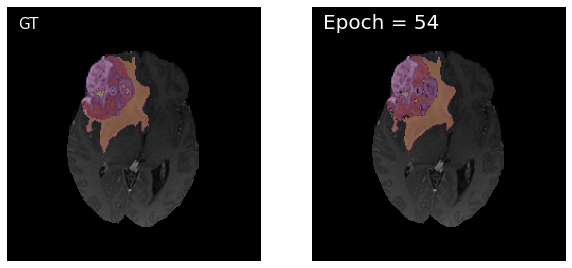

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 55: model 2 : train_loss : 0.018545022354902952, valid_loss : 0.019060994794516214


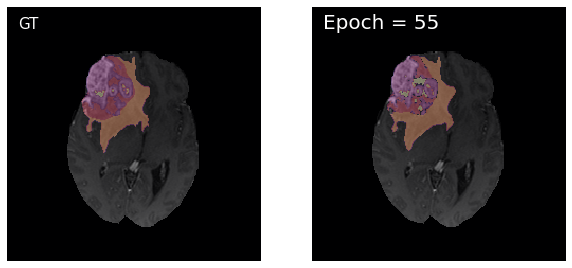

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 56: model 2 : train_loss : 0.01851778381654651, valid_loss : 0.019122255053521404


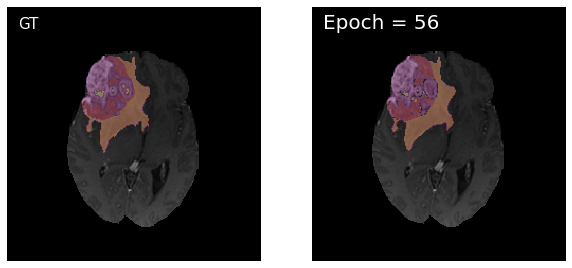

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 57: model 2 : train_loss : 0.018546170319359692, valid_loss : 0.01925379839475906


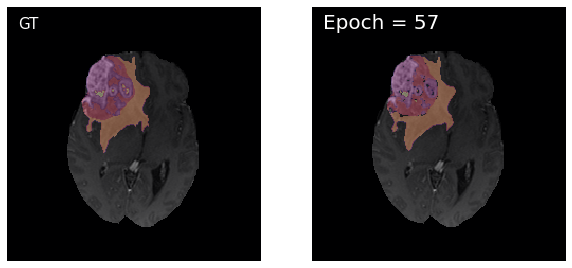

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 58: model 2 : train_loss : 0.018631105189590862, valid_loss : 0.019141483066715575


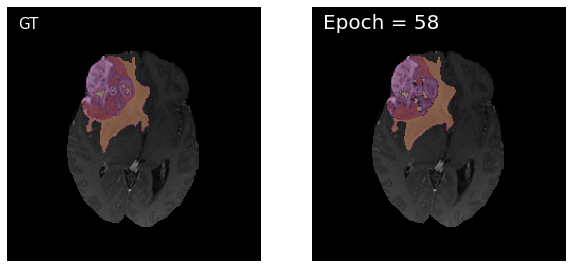

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 59: model 2 : train_loss : 0.018665634648836898, valid_loss : 0.018994723090614687


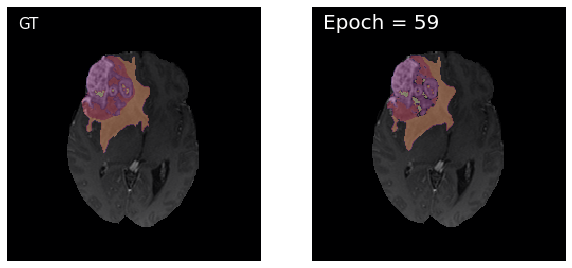

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 60: model 2 : train_loss : 0.01856200913877812, valid_loss : 0.019320732005120765


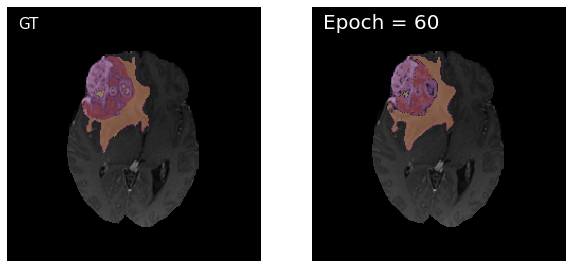

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 61: model 2 : train_loss : 0.01859628654166356, valid_loss : 0.01908567785581146


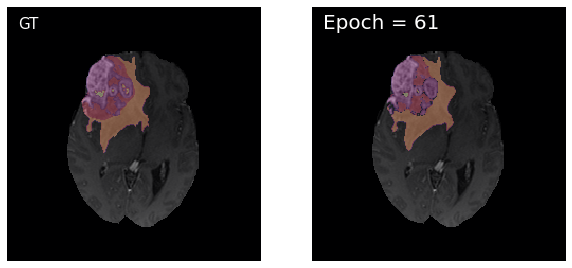

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 62: model 2 : train_loss : 0.018518679908641367, valid_loss : 0.019068705498304105


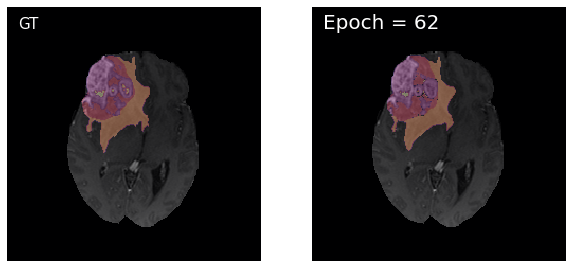

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 63: model 2 : train_loss : 0.018457897433540232, valid_loss : 0.018983168605876517


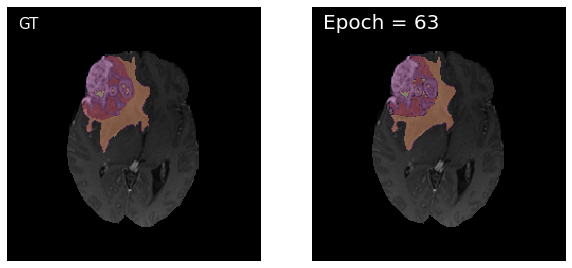

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 64: model 2 : train_loss : 0.018502624051216197, valid_loss : 0.01915600831508987


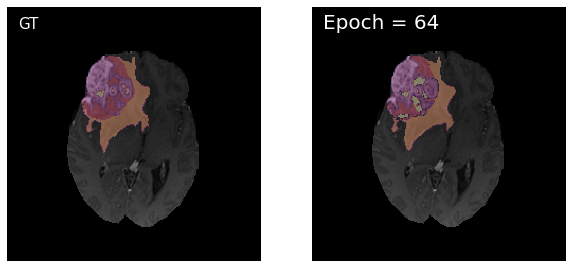

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 65: model 2 : train_loss : 0.018464160101775755, valid_loss : 0.018945296261815094


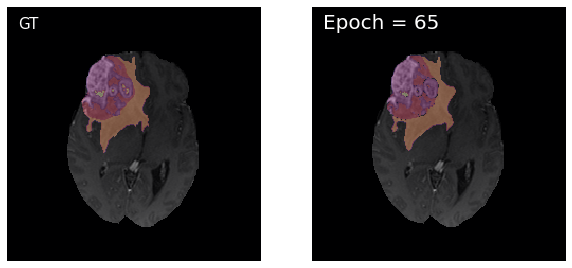

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 66: model 2 : train_loss : 0.01847006968728848, valid_loss : 0.01895135413399667


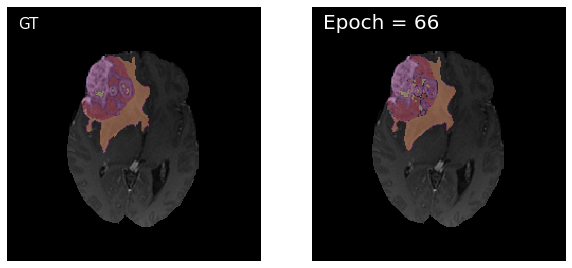

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 67: model 2 : train_loss : 0.018487401531646717, valid_loss : 0.01905849462593167


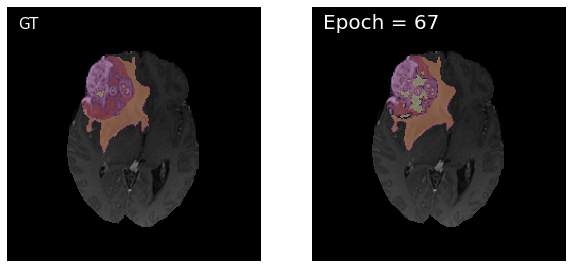

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 68: model 2 : train_loss : 0.01847805790900059, valid_loss : 0.019134257349001947


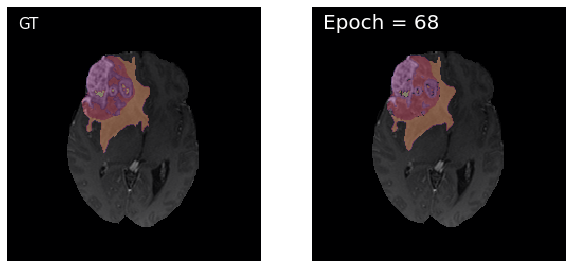

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 69: model 2 : train_loss : 0.01850601991519261, valid_loss : 0.019327725719654888


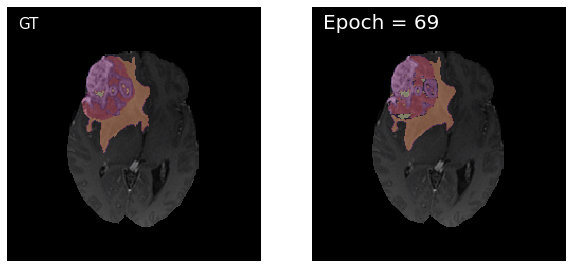

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 70: model 2 : train_loss : 0.01869343310374229, valid_loss : 0.019937485703770998


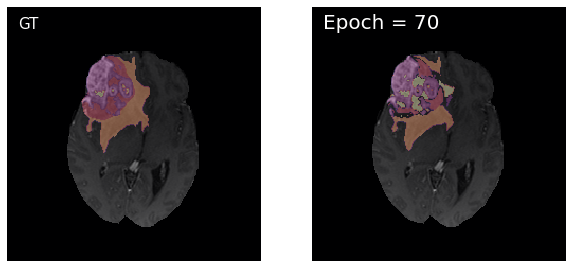

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 71: model 2 : train_loss : 0.01864152794841352, valid_loss : 0.018980335659987132


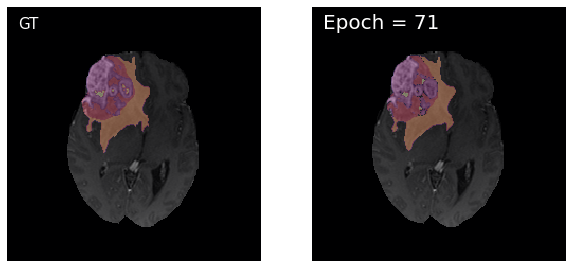

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 72: model 2 : train_loss : 0.01847542068708513, valid_loss : 0.0189966999835545


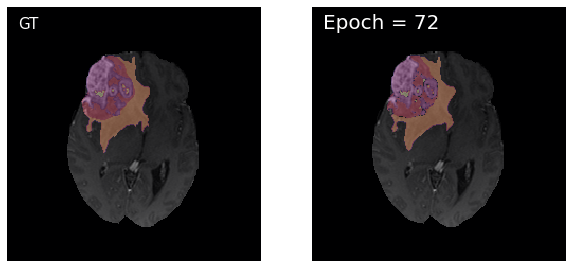

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 73: model 2 : train_loss : 0.018444124106588612, valid_loss : 0.018952863598530312


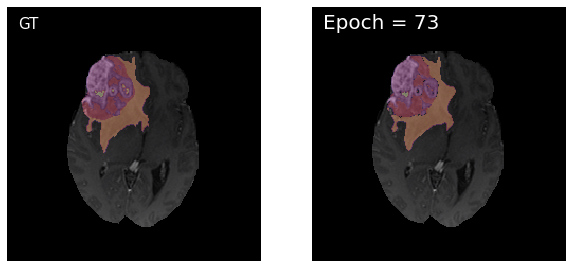

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 74: model 2 : train_loss : 0.018441585417611886, valid_loss : 0.01890294915218512


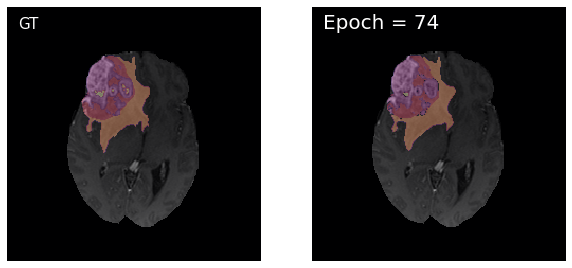

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 75: model 2 : train_loss : 0.018407783779014586, valid_loss : 0.018946568617911417


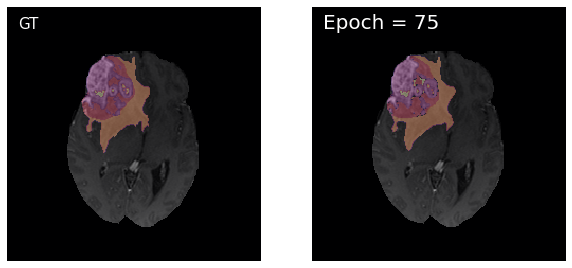

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 76: model 2 : train_loss : 0.018395876934099734, valid_loss : 0.019184248457379233


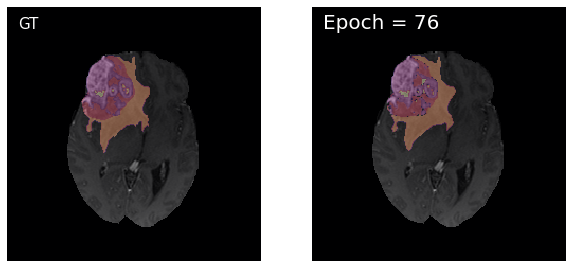

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 77: model 2 : train_loss : 0.018470634331289155, valid_loss : 0.019075562180973143


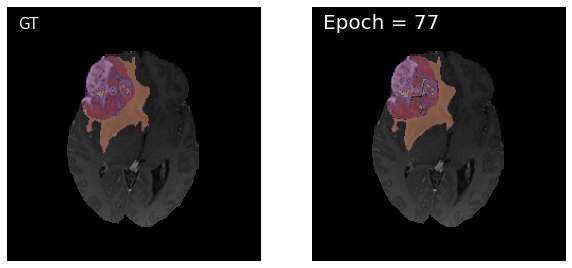

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 78: model 2 : train_loss : 0.018445077600161768, valid_loss : 0.01887251225946207


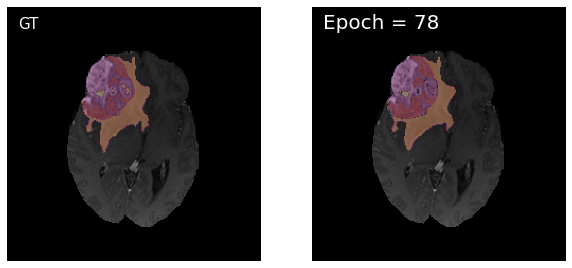

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 79: model 2 : train_loss : 0.0184140783613256, valid_loss : 0.01899076696868325


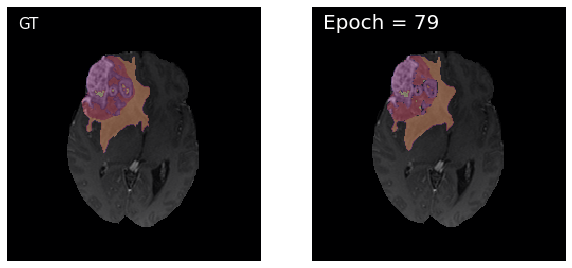

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 80: model 2 : train_loss : 0.018425332028647965, valid_loss : 0.018974016923601338


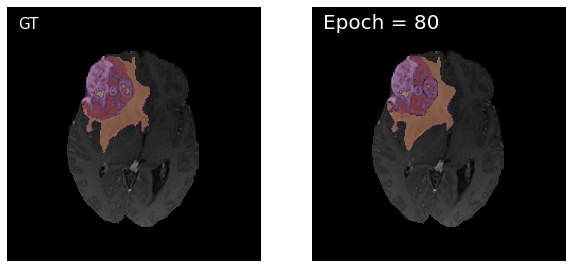

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 81: model 2 : train_loss : 0.018396076964791574, valid_loss : 0.019149589998266093


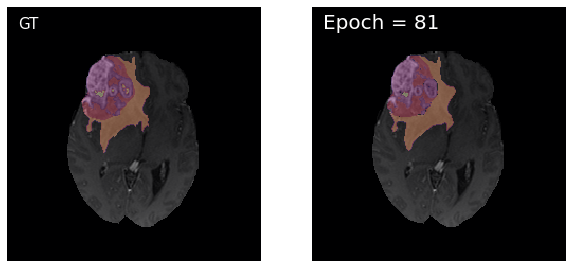

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 82: model 2 : train_loss : 0.01841350617402877, valid_loss : 0.01894108457421954


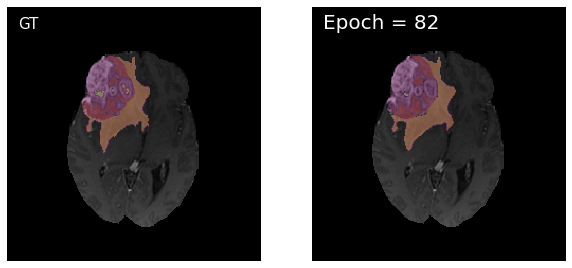

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 83: model 2 : train_loss : 0.018605270920429687, valid_loss : 0.020720777426494575


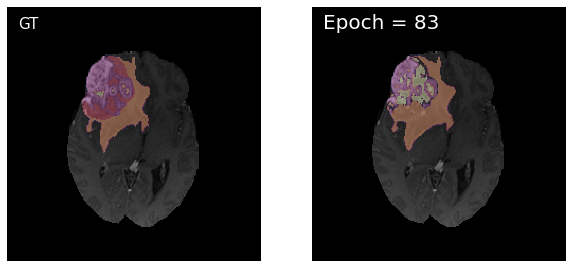

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 84: model 2 : train_loss : 0.01872880480583482, valid_loss : 0.01896104535301684


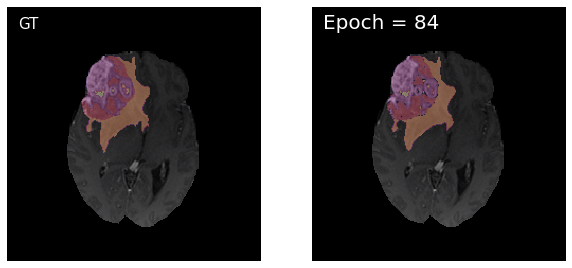

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 85: model 2 : train_loss : 0.018422899930008688, valid_loss : 0.018920418232746962


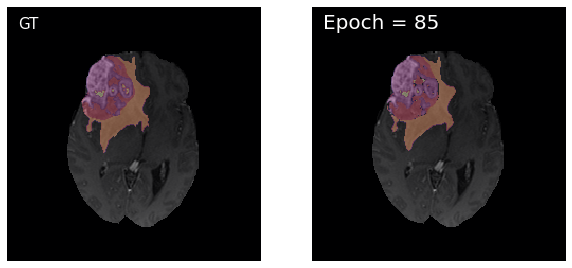

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 86: model 2 : train_loss : 0.01837193915543357, valid_loss : 0.01892697797713129


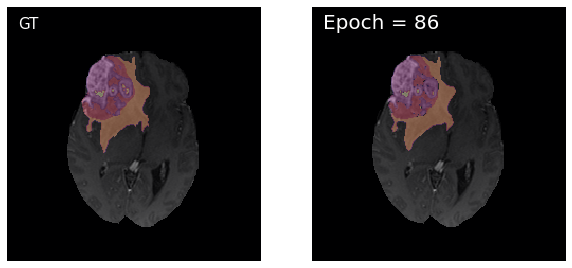

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 87: model 2 : train_loss : 0.01841490686260647, valid_loss : 0.018915530037017843


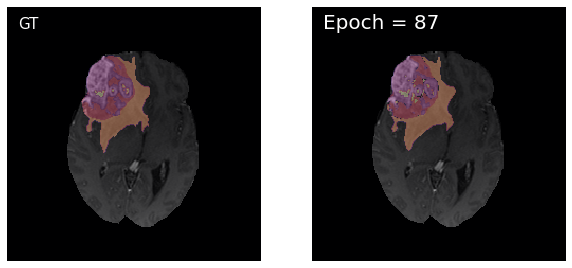

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 88: model 2 : train_loss : 0.018360386148378486, valid_loss : 0.018888239151521546


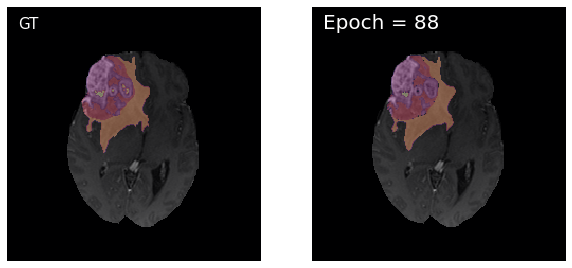

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 89: model 2 : train_loss : 0.01837080614735066, valid_loss : 0.019012911929714528


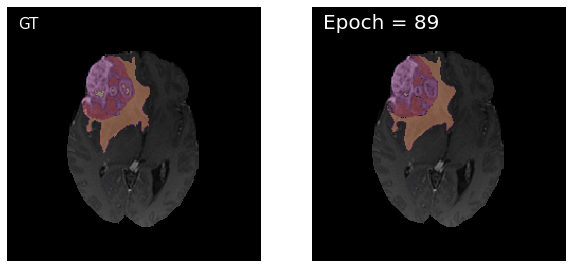

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 90: model 2 : train_loss : 0.018367060854972677, valid_loss : 0.01885156059440198


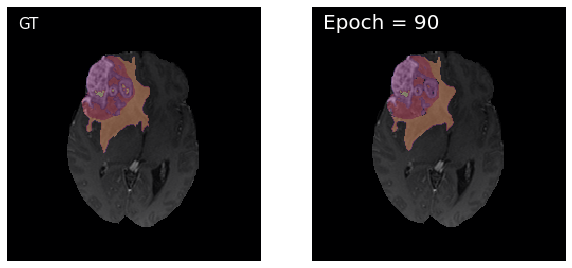

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 91: model 2 : train_loss : 0.018351487379929497, valid_loss : 0.018976388988155502


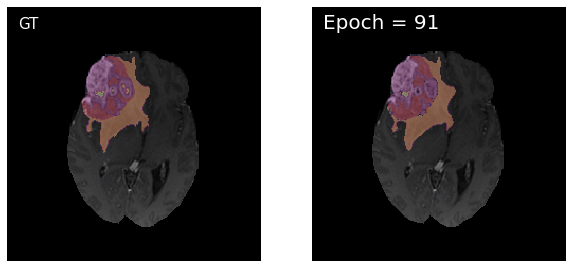

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 92: model 2 : train_loss : 0.018353327238928085, valid_loss : 0.018938055483025677


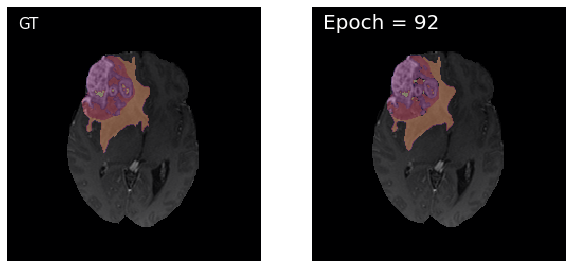

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 93: model 2 : train_loss : 0.01836034153201107, valid_loss : 0.018999399191084048


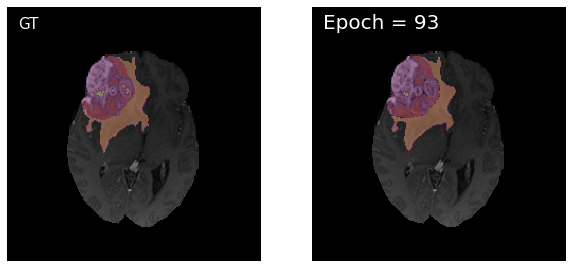

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 94: model 2 : train_loss : 0.018393001325378484, valid_loss : 0.01901862137381085


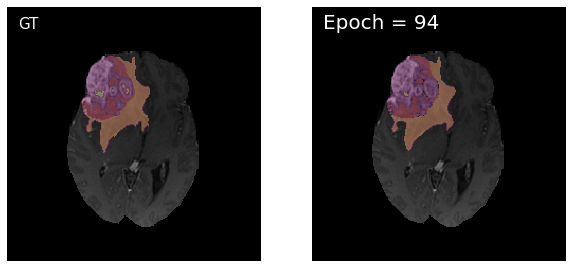

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 95: model 2 : train_loss : 0.018368766028736144, valid_loss : 0.018939034636845934


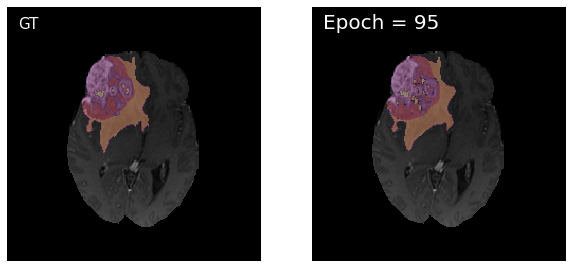

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 96: model 2 : train_loss : 0.0183461503213234, valid_loss : 0.01892912651879102


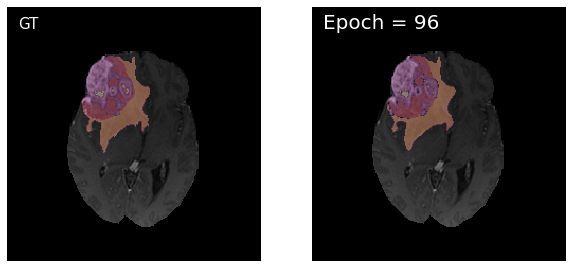

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 97: model 2 : train_loss : 0.018358687230310835, valid_loss : 0.018881499727950706


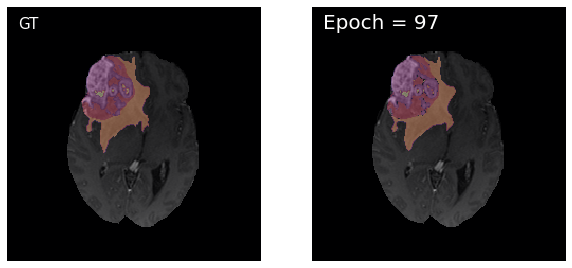

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 98: model 2 : train_loss : 0.018530010739268455, valid_loss : 0.02198775837298668


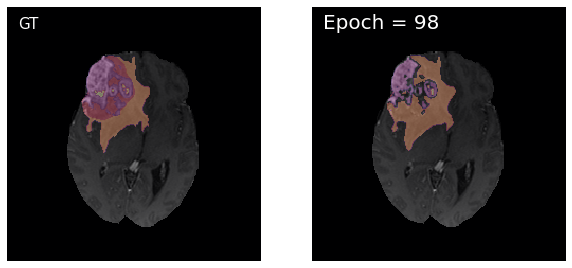

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 99: model 2 : train_loss : 0.018760301430045024, valid_loss : 0.018920980634266994


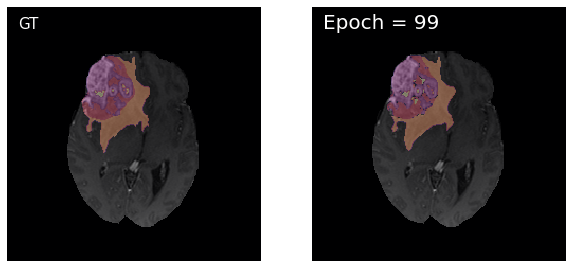

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 100: model 2 : train_loss : 0.018362227001595174, valid_loss : 0.01899442108634669


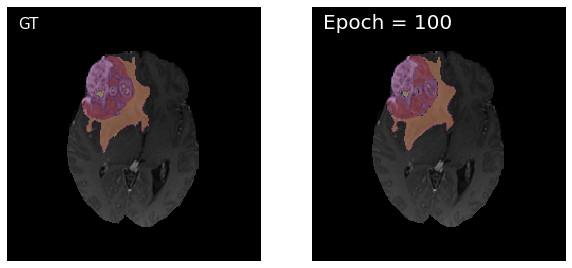

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 101: model 2 : train_loss : 0.01832785719528511, valid_loss : 0.01898133389868333


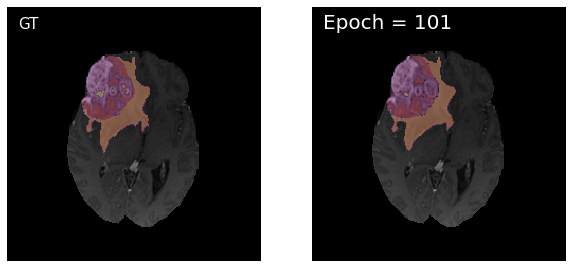

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 102: model 2 : train_loss : 0.018313902812948455, valid_loss : 0.01882858478645068


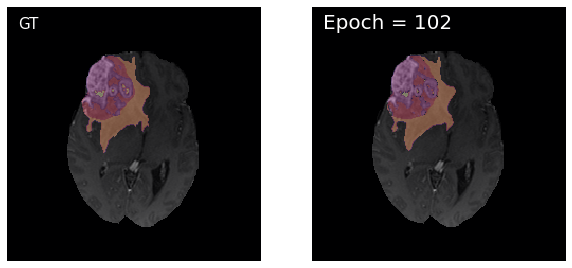

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 103: model 2 : train_loss : 0.01833448194980963, valid_loss : 0.018936573292575625


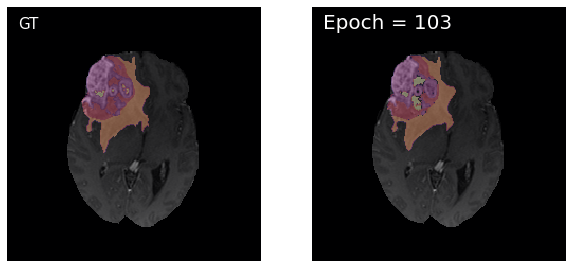

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 104: model 2 : train_loss : 0.018335078093400372, valid_loss : 0.018866265678943527


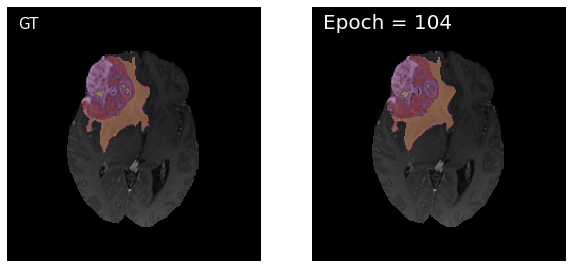

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 105: model 2 : train_loss : 0.01830276114484858, valid_loss : 0.018882016442207276


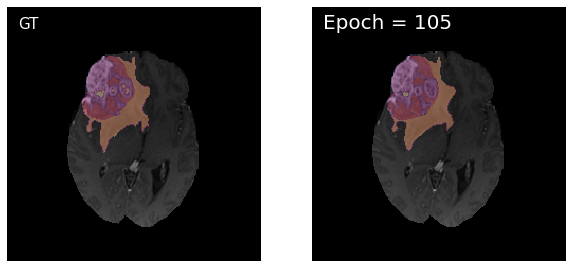

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 106: model 2 : train_loss : 0.018329242955355735, valid_loss : 0.01909836151722258


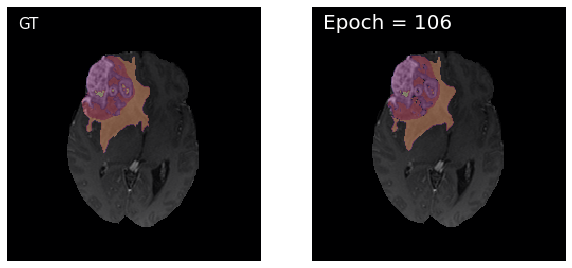

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 107: model 2 : train_loss : 0.018336846911706763, valid_loss : 0.019081628363941276


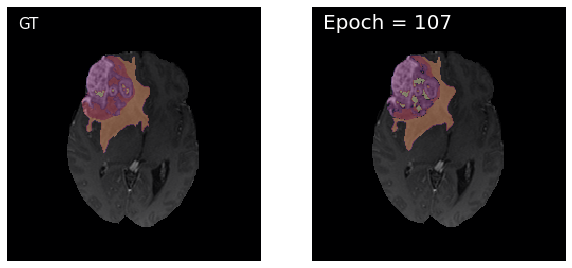

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 108: model 2 : train_loss : 0.018307521662693595, valid_loss : 0.018899103997135035


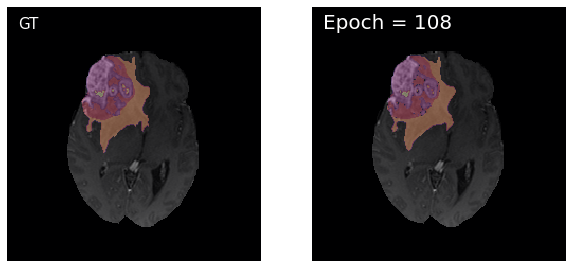

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 109: model 2 : train_loss : 0.018292156864068067, valid_loss : 0.01888438868142354


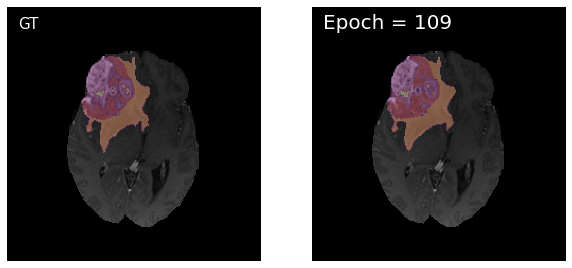

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 110: model 2 : train_loss : 0.01834459383414654, valid_loss : 0.018923829773817118


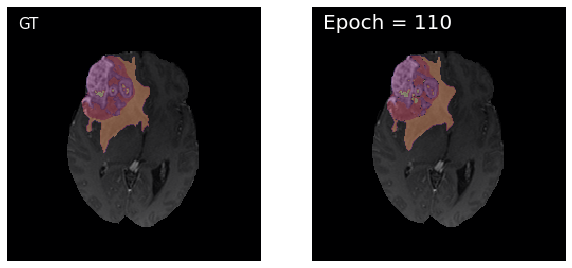

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 111: model 2 : train_loss : 0.01833767852156321, valid_loss : 0.019369567746780964


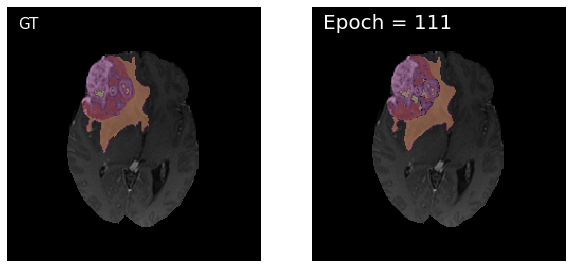

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 112: model 2 : train_loss : 0.019056947370553575, valid_loss : 0.019187057269386628


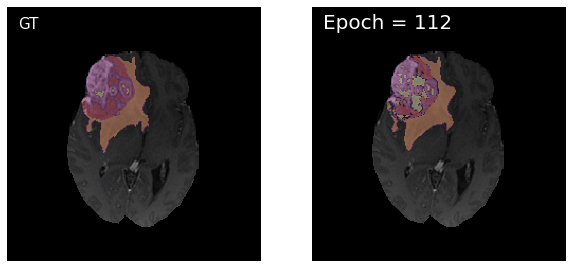

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 113: model 2 : train_loss : 0.018448374213825836, valid_loss : 0.018992044892764817


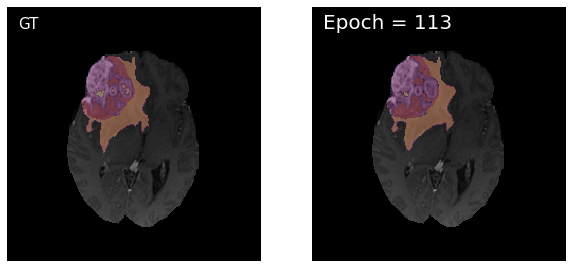

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 114: model 2 : train_loss : 0.018333413937156165, valid_loss : 0.01890278058475502


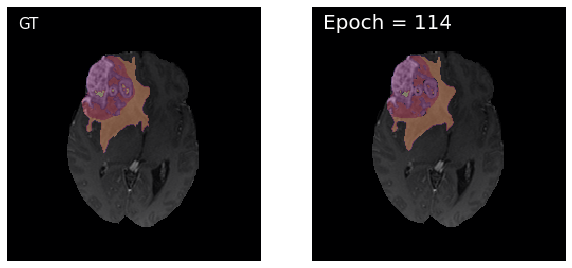

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 115: model 2 : train_loss : 0.018296192077736494, valid_loss : 0.01887773217247506


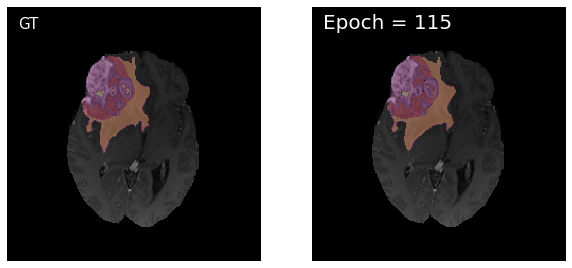

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 116: model 2 : train_loss : 0.018299446836836902, valid_loss : 0.018863062382117414


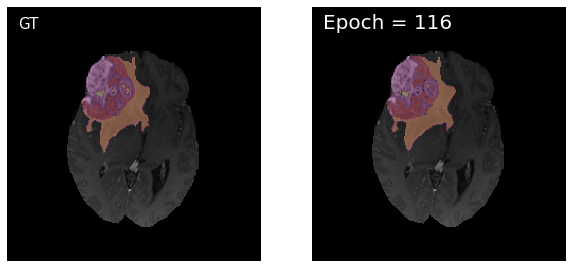

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 117: model 2 : train_loss : 0.018262922665900166, valid_loss : 0.018855069134314294


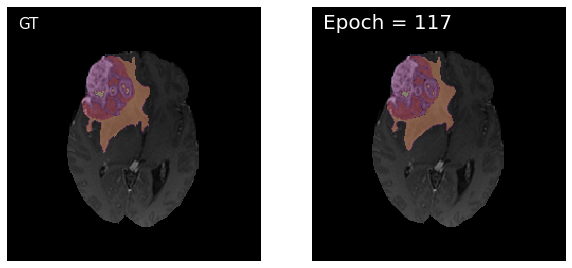

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 118: model 2 : train_loss : 0.018276346910180277, valid_loss : 0.01887712180138796


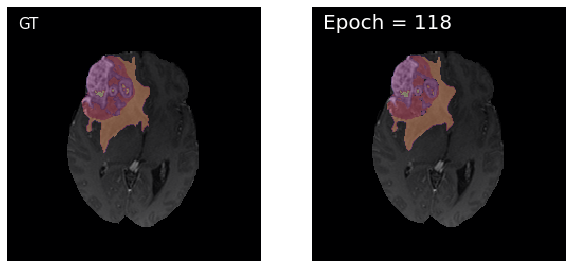

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 119: model 2 : train_loss : 0.018297158652797792, valid_loss : 0.01891939178805783


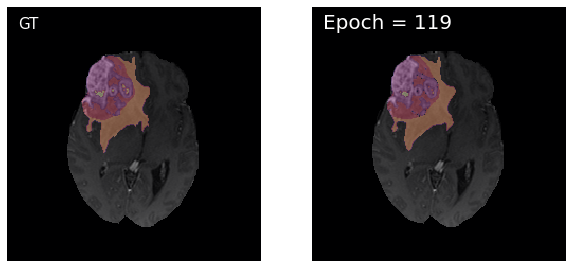

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 120: model 2 : train_loss : 0.018275097423489362, valid_loss : 0.018857788264354622


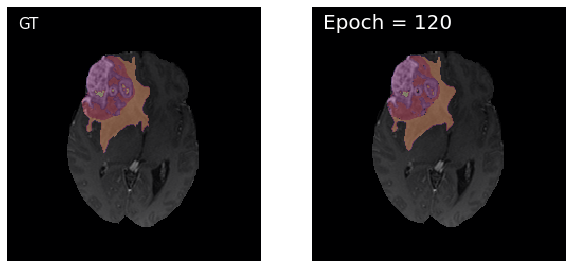

In [34]:
model_1.load_state_dict(torch.load(f"./model/{save_1}.pt"))
model_1.eval()
    
loss_2 =0.
min_valid_loss = np.inf
train_loss_list_2 = []
valid_loss_list_2 = []

for i in tqdm(range(num_epoch)):
    train_loss_2 = 0.0
    valid_loss_2 = 0.0
    model_2.train()
    
    for image,label in tqdm(train_loader, leave=False):
      
        optimizer_2.zero_grad()
        image,label= image.to(device), label.to(device)
        with torch.no_grad():
            output = model_1(image)
        output_2 = model_2(image)
        check = threshold_img(output)
        output_2 = output_2*check
        output_2[:,0] = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).squeeze().float()        
        loss_2   = loss_func(output_2, label)  #0:normal data 
       
        loss_2.backward()
        optimizer_2.step()
        train_loss_2 += loss_2.item()*image.size(0)#

    with torch.no_grad():
        model_2.eval()    

        for image, label in tqdm(valid_loader, leave=False):

            image,label = image.to(device),label.to(device)
            output = model_1(image)
            output_2 = model_2(image)
            check = threshold_img(output)
            output_2 = output_2*check
            output_2[:,0] = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).squeeze().float()        
            loss_2 = loss_func(output_2, label)  #0:normal data 
            valid_loss_2 += loss_2.item()*image.size(0)
        scheduler_2.step(valid_loss_2)
    if min_valid_loss>=valid_loss_2:
        torch.save(model_2.state_dict(), f'./model/{save_2}.pt')
    
    train_loss_2 = train_loss_2/len(train_loader.sampler)
    valid_loss_2 = valid_loss_2/len(valid_loader.sampler)
    
    print('Epoch {}: model 2 : train_loss : {}, valid_loss : {}'.format(i+1, train_loss_2, valid_loss_2))
    train_loss_list_2.append(train_loss_2)
    valid_loss_list_2.append(valid_loss_2)
    
    ##################show the image
    with torch.no_grad():
        pltimage = pltimage.to(device) # 4stack이미지를 
        output_1 = model_1(pltimage)     # 일단 넣고 
        pltout = model_2(pltimage)

        check = threshold_img(output_1) # 0.5 매핑
        pltout = pltout*check
        pltout[:,0] = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).squeeze().float()        
        pltout = threshold_img(pltout)
        # imshow1(plt1)
        pltout = pltout.squeeze().detach().cpu().numpy()
        param = pltout[1]*5+ pltout[2]*4 +pltout[3]*3 +pltout[4]*2
        # Bimshow(param, i)    
        Bimshow_2(plt1,show_label,param,i)
        plt.savefig('./image/model_1/macro_4_to_5_{}th_result.png'.format(i), dpi=300, facecolor='None')
        plt.show()        
    

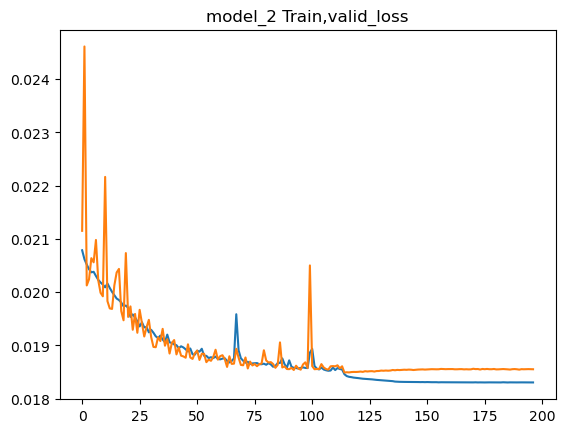

best epoch:  116


<Figure size 640x480 with 0 Axes>

In [22]:
plt.style.use('default')
plt.title('model_2 Train,valid_loss')
plt.plot(train_loss_list_2[3:])
plt.plot(valid_loss_list_2[3:])

plt.show()
print('best epoch: ',np.argmin(valid_loss_list_2)-1)
best=  np.argmin(valid_loss_list_2)-1
plt.savefig('./png/model_2 Train,valid_loss.png', dpi=300, facecolor='w')

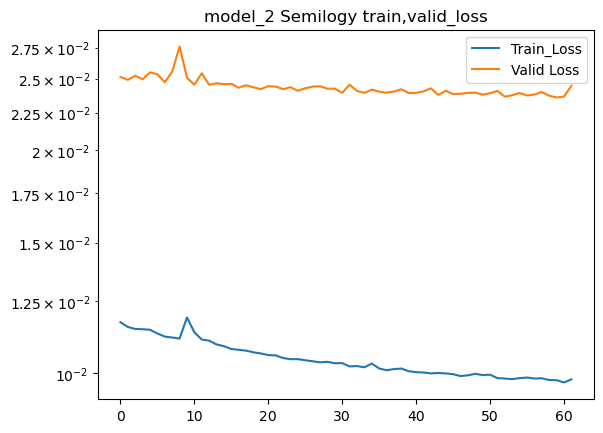

best epoch:  62


<Figure size 640x480 with 0 Axes>

In [45]:
plt.style.use('default')
plt.title('model_2 Semilogy train,valid_loss')
plt.semilogy(train_loss_list_2[3:],label = 'Train_Loss')
plt.semilogy(valid_loss_list_2[3:],label = "Valid Loss")
plt.legend()

plt.show()
print('best epoch: ',np.argmin(train_loss_list_2)-1)
best=  np.argmin(valid_loss_list_2)-1
plt.savefig('model_2 Semilogy train,valid_loss.png', dpi=300, facecolor='w')

In [16]:
def test(model_1,model_2, test_loader, loss_func,string, device):
    '''
    dataset shape -> [modality, h, d, w]
    dataset  -> data[0] : MR_Flair
    dataset  -> data[1] : MR_T1
    dataset  -> data[2] : MR_T1c
    dataset  -> data[3] : MR_T2
    one-hot: 
        [0] label necrosis
        [1] label edema
        [2] label non-enhancing tumor
        [3] label enhancing tumor
    '''
    enhancing = 0.0 # necrosis[1] + enhanced tumor[4]
    core = 0.0      # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3]
    complete = 0.0  # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3] + edema[2]
    enhancing_real_seg = 0.0
    core_real_seg = 0.0     
    complete_real_seg = 0.0 
    
    model_1 = model_1.to(device)
    model_2 = model_2.to(device)
    model_1.load_state_dict(torch.load(f"./model/{save_1}.pt"))
    model_2.load_state_dict(torch.load(f"./model/{save_2}.pt"))

    model_1.eval()
    model_2.eval()
    
    for image, label in tqdm(test_loader, leave=False):
        image , label= image.to(device), label.to(device)
        output = model_1(image)
        output_2 = model_2(image)
        check = threshold_img(output)
        output_2 = output_2*check
        output_2[:,0] = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).squeeze().float()
        output_2 = threshold_img(output_2)
        
        # pred = torch.topk(output_2, 1, dim=1).indices
        # target = torch.topk(label, 1, dim=1).indices
        
        en, co, com, en_real_seg, co_real_seg, com_real_seg  = loss_func(output_2.detach().cpu().numpy(), label.detach().cpu().numpy())
        
        enhancing += en
        core += co
        complete += com
        enhancing_real_seg += en_real_seg
        core_real_seg += co_real_seg
        complete_real_seg += com_real_seg
        
        
        
    enhancing, core, complete = enhancing/enhancing_real_seg, core/core_real_seg, complete/complete_real_seg
    
    return  complete, core, enhancing

In [19]:
model_1 = AttentionUNet_1(4, 1).to(device)
model_2 = AttentionUNet_2(4,5).to(device)
save_1 = '2_case_unet_ver_1'
save_2 = '2_case_Macro_Unet'
dice  =dice
sen=sensitivity
spec=specificity

In [20]:
# micro and macro model result 
print('DICE : ', test(model_1,model_2, test_loader, dice,'DICE', device))
print('Specificity : ', test(model_1,model_2, test_loader, sen,'Specificity', device))
print('Sensitivity : ', test(model_1,model_2, test_loader, spec,'Sensitivity', device))

  0%|          | 0/149 [00:00<?, ?it/s]

DICE :  (0.9447440523660252, 0.9367331954426592, 0.9537292931967498)


  0%|          | 0/149 [00:00<?, ?it/s]

Specificity :  (0.935307671111337, 0.9267836600378571, 0.9486063864808515)


  0%|          | 0/149 [00:00<?, ?it/s]

Sensitivity :  (0.9998662995526589, 0.9999117632030007, 0.9999134884461712)


In [21]:
def confusion_matrix(pred, target, class_name):
    
    cm_pred = np.zeros((len(class_name), len(class_name)))
    cm_target = np.zeros((len(class_name), len(class_name)))
    
    for i in range(len(class_name)):
        mask = target == i
        pred_mask = pred[mask]
        for j in range(len(class_name)):
            cm_pred[i, j] = torch.sum(pred_mask==j)
            cm_target[i, j] = torch.sum(mask)
            
    return cm_pred, cm_target

In [22]:
def test_confusion_matrix(model,model_2, test_loader, device):
    '''
    dataset shape -> [modality, h, d, w]
    dataset  -> data[0] : MR_Flair
    dataset  -> data[1] : MR_T1
    dataset  -> data[2] : MR_T1c
    dataset  -> data[3] : MR_T2
    one-hot: 
        [0] label normal
        [1] label necrosis
        [2] label edema
        [3] label non-enhancing tumor
        [4] label enhancing tumor
    '''
    class_name = ['Normal', 'Necrosis', 'Edema', 'Non-enhancing tumor', 'Enhancing tumor']

    model = model.to(device)
    model_2 = model_2.to(device)
    model.eval()
    model_2.eval()
    
    cm_pred = np.zeros((len(class_name), len(class_name)))
    cm_target = np.zeros((len(class_name), len(class_name)))
    for image, label in tqdm(test_loader, leave=False):
        image , label= image.to(device), label.to(device)
        output = model_1(image)
        output_2 = model_2(image)
        check = threshold_img(output)
        output_2 = output_2*check
        output_2[:,0] = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).squeeze().float()
        
        pred = torch.topk(output_2, 1, dim=1).indices
        target = torch.topk(label, 1, dim=1).indices
        
        cm_p, cm_t  = confusion_matrix(pred, target, class_name)
        cm_pred += cm_p
        cm_target += cm_t
        
    cm = np.round(cm_pred/cm_target, 2)

    return  cm

  0%|          | 0/149 [00:00<?, ?it/s]

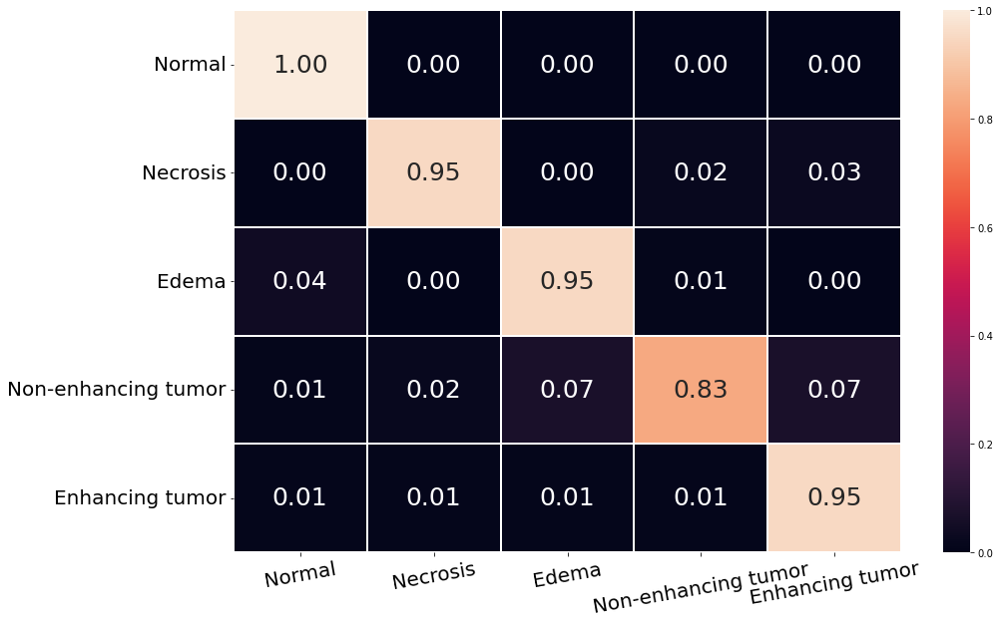

In [23]:
model_1 = AttentionUNet_1(4,1)
model_2 = AttentionUNet_2(4,5)
model_1.load_state_dict(torch.load(f'./model/{save_1}.pt'))
model_2.load_state_dict(torch.load(f'./model/{save_2}.pt'))


class_name = ['Normal', 'Necrosis', 'Edema', 'Non-enhancing tumor', 'Enhancing tumor']

cm = test_confusion_matrix(model_1,model_2, test_loader, device)

fig,ax = plt.subplots(1,1,figsize = (15,10))
ax = sns.heatmap(cm, annot=True,linewidths=0.1,fmt=".2f",annot_kws={"fontsize":25})
ax.set_yticklabels(class_name, rotation=0,fontsize =20,)
ax.set_xticklabels(class_name, rotation=10,fontsize =20)
plt.savefig('./png/macro_micro_2_path_4to5.png', dpi=200, facecolor='w',bbox_inches = 'tight')
plt.show()

################################################################ 
4to4에서 방법

In [17]:
num_epoch = 200
learning_rate = 1e-2

model_1 = AttentionUNet_1(4, 1).to(device)

# optimizer_1 = torch.optim.AdamW(model_1.parameters(), lr=learning_rate)
# scheduler_1 = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_1,mode='min',patience=10)
# save_1 = '2_case_unet_ver_1'


model_2 = AttentionUNet_2(4,4).to(device) # normal은 model_1이 확인한 상황 
optimizer_2 = torch.optim.AdamW(model_2.parameters(), lr=learning_rate)
scheduler_2 = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_2,mode='min',patience=10)
save_3 = '2_case_Macro_Unet_4to4'

loss_func = torch.nn.BCELoss().to(device)
model_1,model_2 = model_1.to(device), model_2.to(device)
    
plt2 = pltlabel[0].detach().cpu().numpy()
plt1 = pltimage[0][0].detach().cpu().numpy()
show_label = plt2[0]+plt2[1]*2+plt2[2]*3+plt2[3]*4
# model

In [50]:
################################ 여기는 4,4 실험

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 1: model 2 : train_loss : 0.28990979289315155, valid_loss : 0.2902392280758709


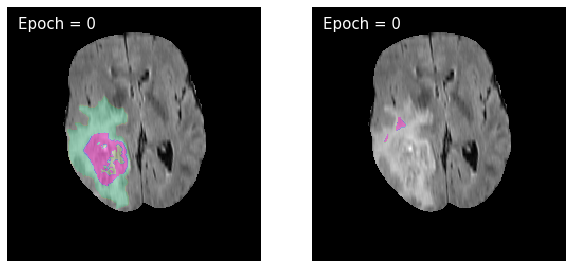

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 2: model 2 : train_loss : 0.2894310597205322, valid_loss : 0.28967554582863725


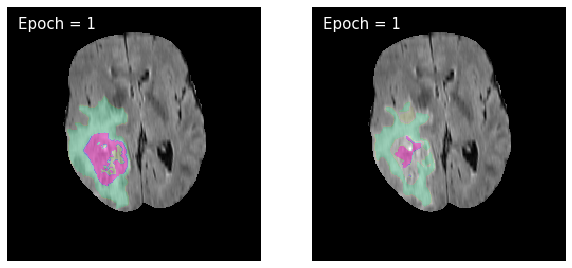

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 3: model 2 : train_loss : 0.2890941870025874, valid_loss : 0.28946204823992583


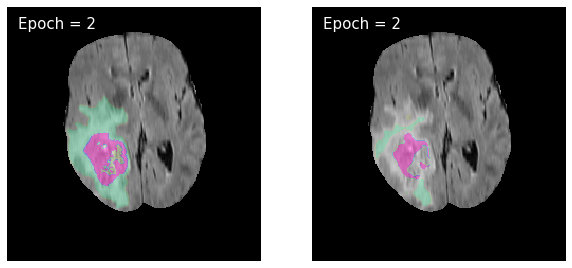

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 4: model 2 : train_loss : 0.28887255633170705, valid_loss : 0.29003008731430574


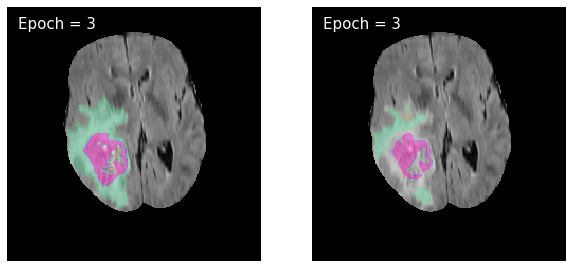

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 5: model 2 : train_loss : 0.2887429436981278, valid_loss : 0.28932555432441415


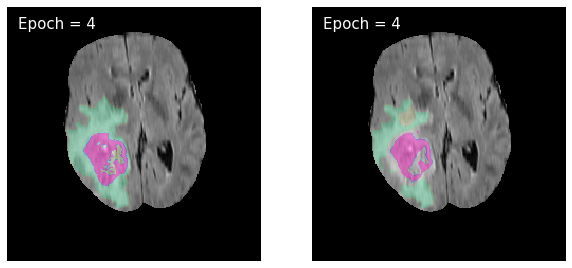

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 6: model 2 : train_loss : 0.2886223489006094, valid_loss : 0.28902665645845477


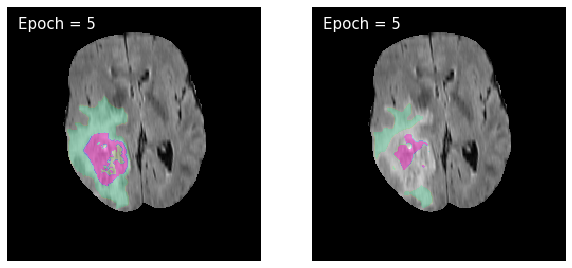

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 7: model 2 : train_loss : 0.2885324890314866, valid_loss : 0.2887906910831569


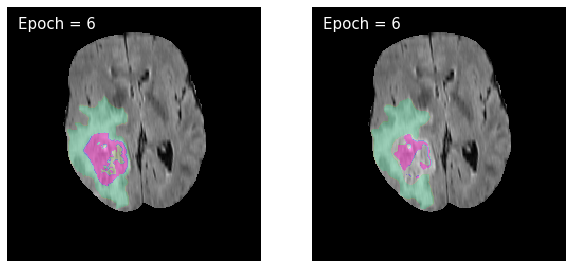

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 8: model 2 : train_loss : 0.2885557144413592, valid_loss : 0.288792042762682


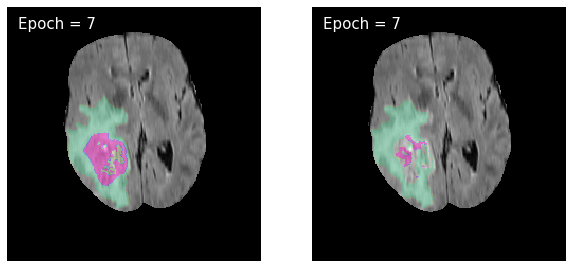

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 9: model 2 : train_loss : 0.28832736638035017, valid_loss : 0.2895869882276622


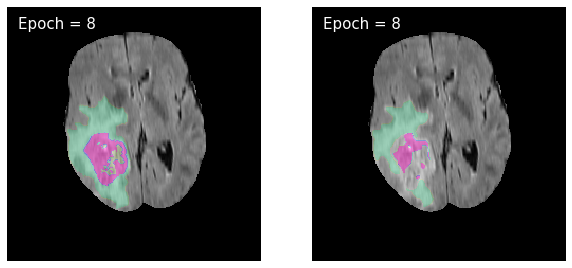

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 10: model 2 : train_loss : 0.2881960354795392, valid_loss : 0.28825983449175796


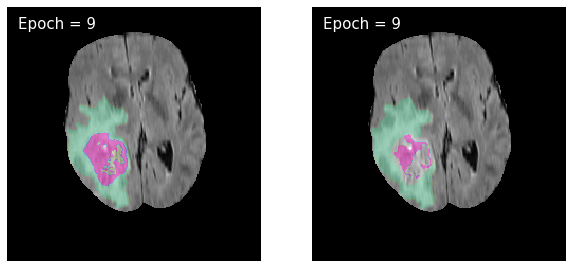

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 11: model 2 : train_loss : 0.2881061028714148, valid_loss : 0.28827932845520715


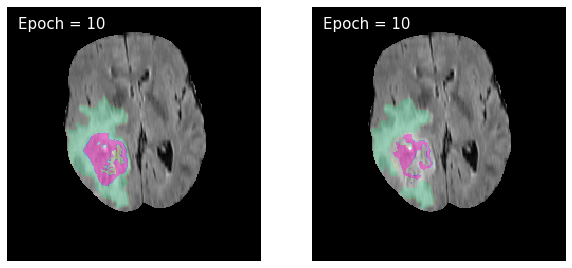

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 12: model 2 : train_loss : 0.2880013935784632, valid_loss : 0.2882598997444235


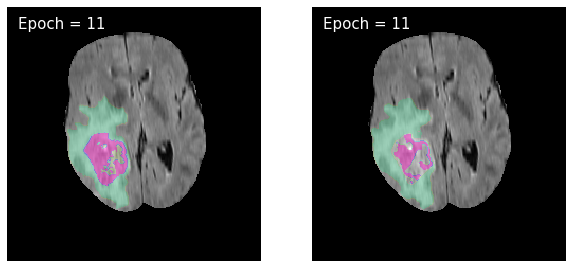

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 13: model 2 : train_loss : 0.2878292480971189, valid_loss : 0.2879966626805003


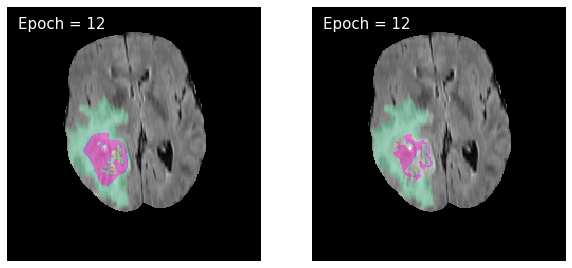

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 14: model 2 : train_loss : 0.2877561886038556, valid_loss : 0.2880938844254581


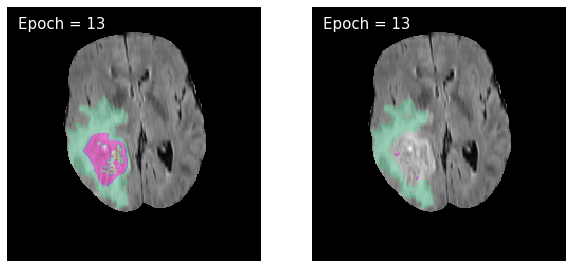

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 15: model 2 : train_loss : 0.2875598747724921, valid_loss : 0.28792964502848606


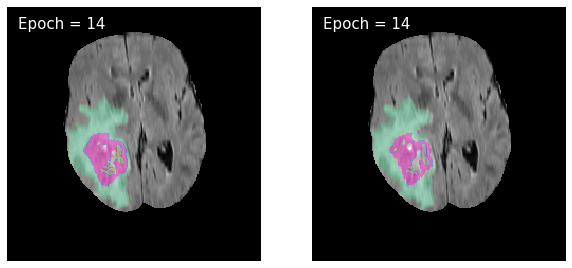

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 16: model 2 : train_loss : 0.28751379051464515, valid_loss : 0.28774524576240973


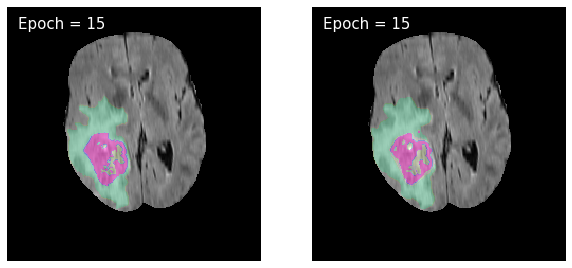

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 17: model 2 : train_loss : 0.28749018540851756, valid_loss : 0.2877893404614541


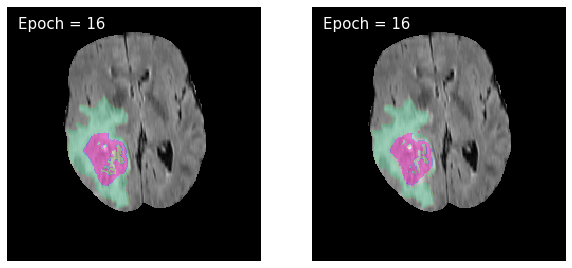

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 18: model 2 : train_loss : 0.2872502427106469, valid_loss : 0.2875764257004184


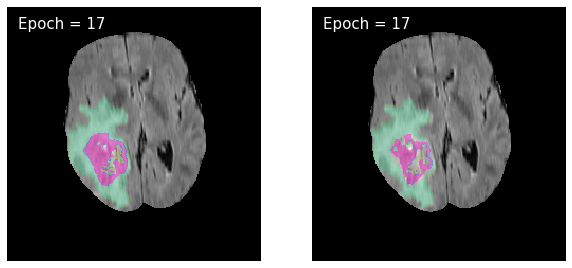

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 19: model 2 : train_loss : 0.2873041751800767, valid_loss : 0.2877433199475529


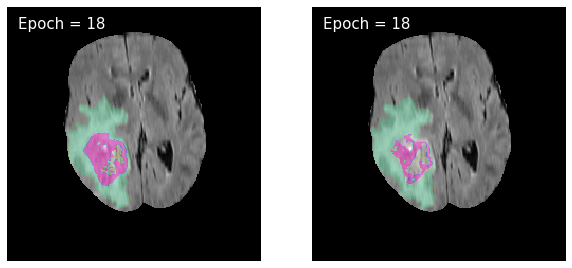

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 20: model 2 : train_loss : 0.28705976246720727, valid_loss : 0.28700304447963676


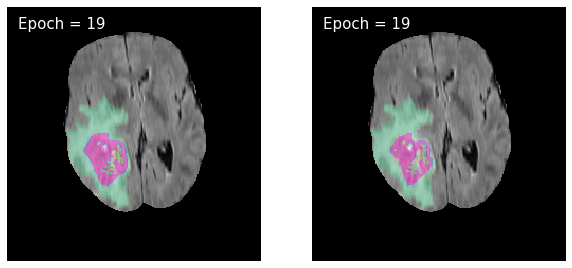

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 21: model 2 : train_loss : 0.287075640771213, valid_loss : 0.2877583643121104


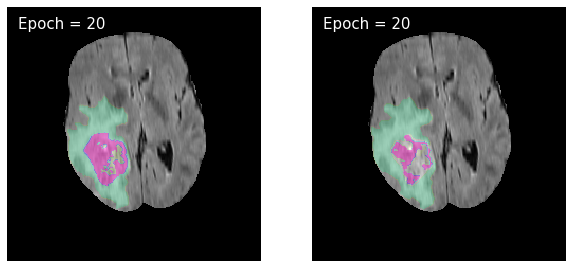

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 22: model 2 : train_loss : 0.28696716105111225, valid_loss : 0.28716004006965185


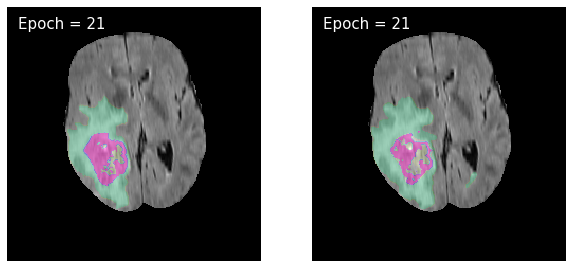

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 23: model 2 : train_loss : 0.2868202209339313, valid_loss : 0.28690355787834815


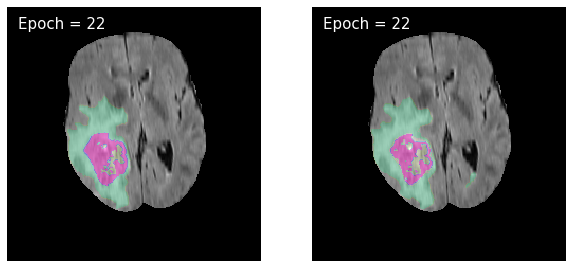

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 24: model 2 : train_loss : 0.286777647549674, valid_loss : 0.2866855156758139


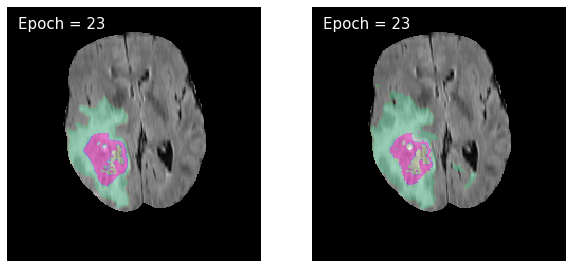

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 25: model 2 : train_loss : 0.2868305422048974, valid_loss : 0.2868875562744115


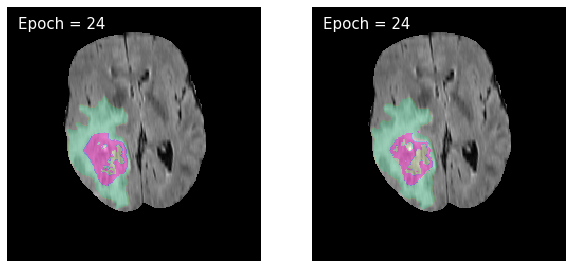

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 26: model 2 : train_loss : 0.28662145437810244, valid_loss : 0.28674078628581057


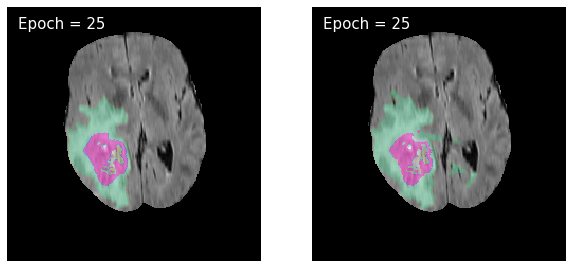

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 27: model 2 : train_loss : 0.2866958806445401, valid_loss : 0.2866048816070762


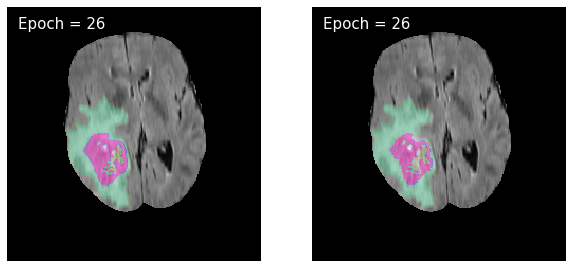

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 28: model 2 : train_loss : 0.28660882439389324, valid_loss : 0.28662886294305967


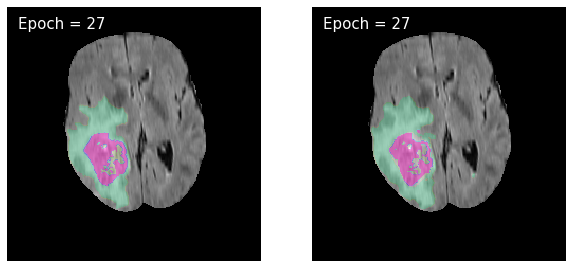

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 29: model 2 : train_loss : 0.28650687298252014, valid_loss : 0.2869784806764895


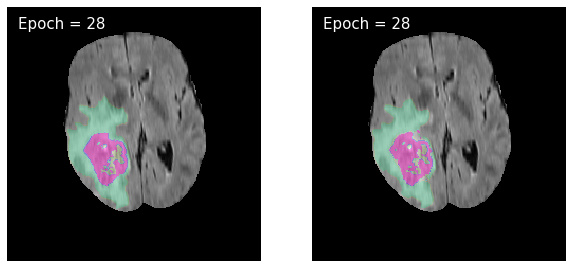

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 30: model 2 : train_loss : 0.2863759639812529, valid_loss : 0.28636289992800323


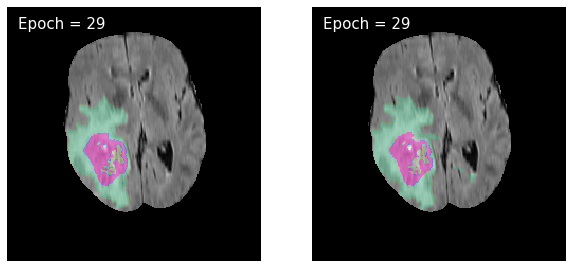

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 31: model 2 : train_loss : 0.28641194471843556, valid_loss : 0.2865389861486932


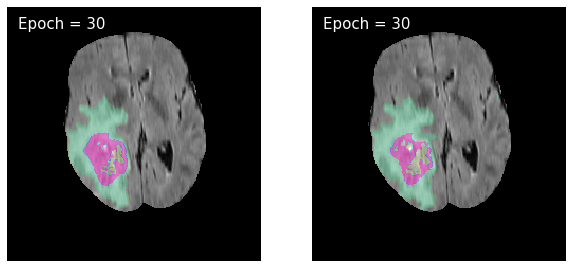

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 32: model 2 : train_loss : 0.2862920157061327, valid_loss : 0.2863585738645446


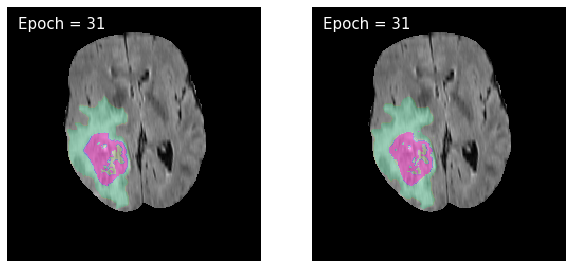

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 33: model 2 : train_loss : 0.28652505079905194, valid_loss : 0.2863997222995886


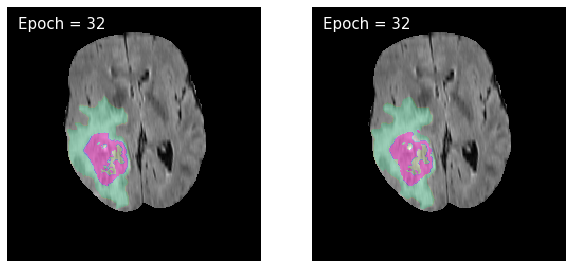

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 34: model 2 : train_loss : 0.28629766427963904, valid_loss : 0.28604846131256834


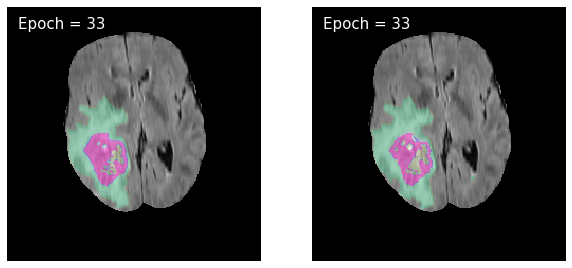

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 35: model 2 : train_loss : 0.2861924611482044, valid_loss : 0.2862561263384358


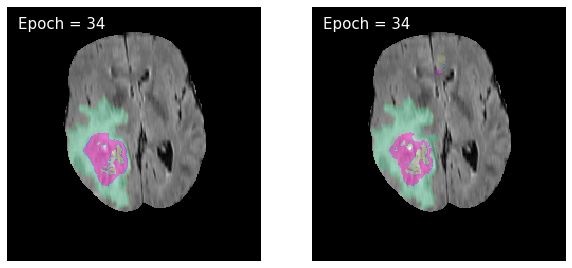

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 36: model 2 : train_loss : 0.2861988610469255, valid_loss : 0.28623895467289034


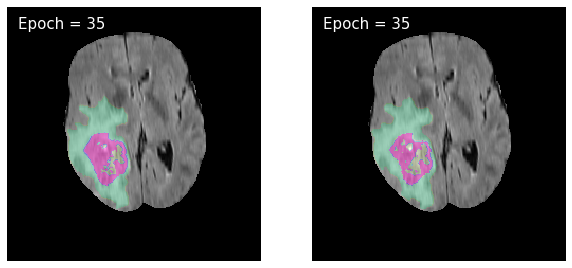

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 37: model 2 : train_loss : 0.2861484443848032, valid_loss : 0.2870712072778774


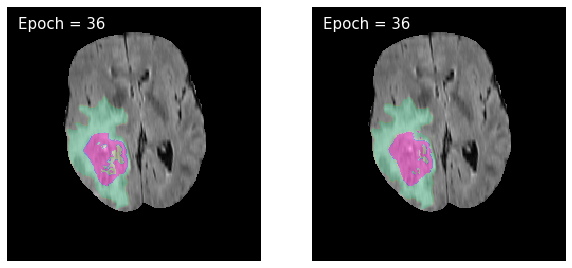

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 38: model 2 : train_loss : 0.28615970186205786, valid_loss : 0.28655949659565444


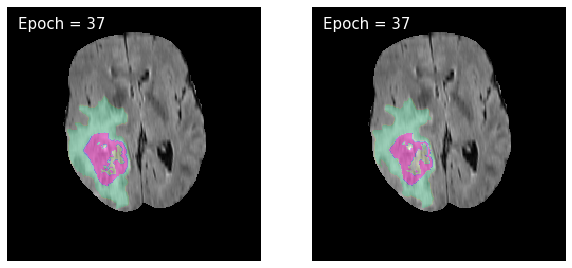

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 39: model 2 : train_loss : 0.28609683809664427, valid_loss : 0.2860619934896628


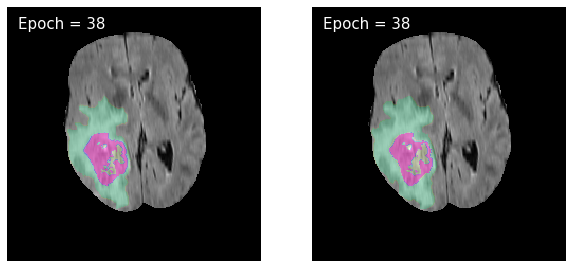

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 40: model 2 : train_loss : 0.28611118334785135, valid_loss : 0.2867818538860608


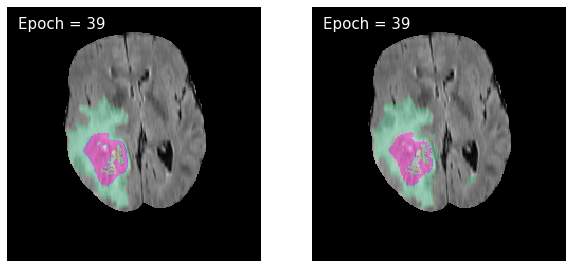

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 41: model 2 : train_loss : 0.28616344788730547, valid_loss : 0.2861078050267953


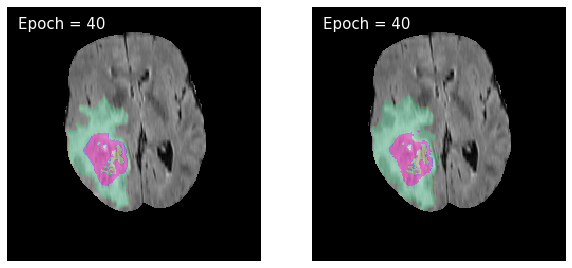

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 42: model 2 : train_loss : 0.28593364464623283, valid_loss : 0.28608531637057183


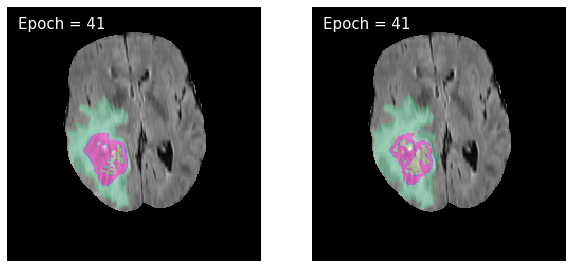

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 43: model 2 : train_loss : 0.2860159353255159, valid_loss : 0.28602654903486213


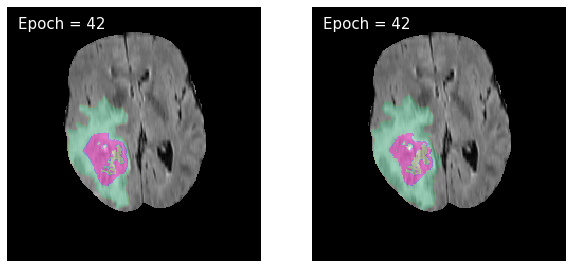

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 44: model 2 : train_loss : 0.28606043592662084, valid_loss : 0.2864013462057037


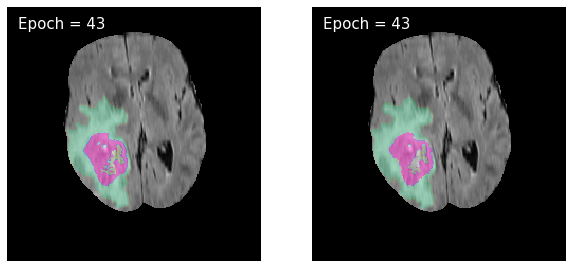

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 45: model 2 : train_loss : 0.2859465897883345, valid_loss : 0.28585043401327187


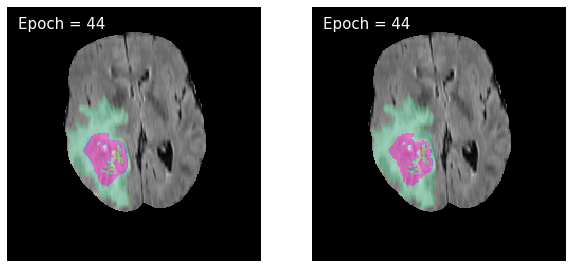

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 46: model 2 : train_loss : 0.28608904282251996, valid_loss : 0.28729687775335006


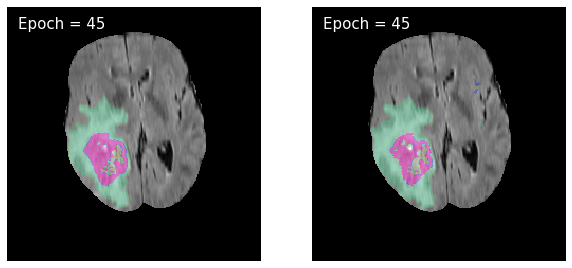

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 47: model 2 : train_loss : 0.28604868001052464, valid_loss : 0.28596115036196607


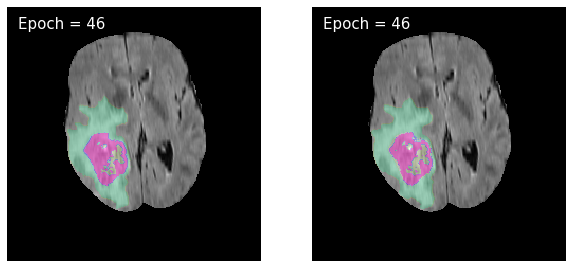

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 48: model 2 : train_loss : 0.2858950460383823, valid_loss : 0.2860255762133547


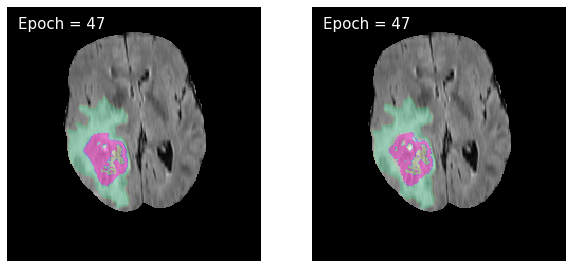

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 49: model 2 : train_loss : 0.2858717243543407, valid_loss : 0.2859331243220837


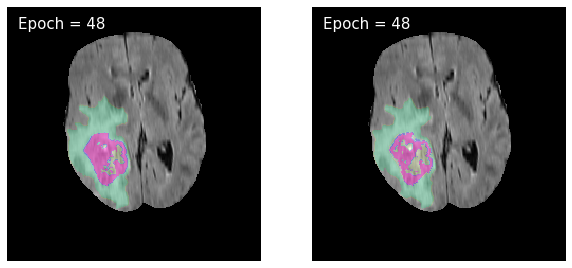

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 50: model 2 : train_loss : 0.2858403800451249, valid_loss : 0.286324828823087


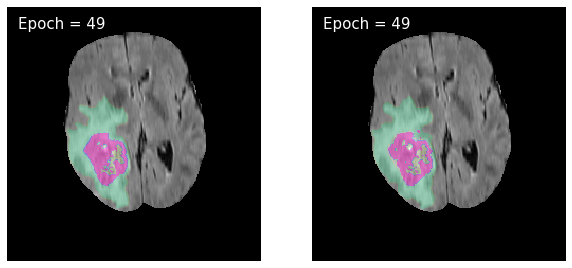

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 51: model 2 : train_loss : 0.2858603560684511, valid_loss : 0.28597357019942293


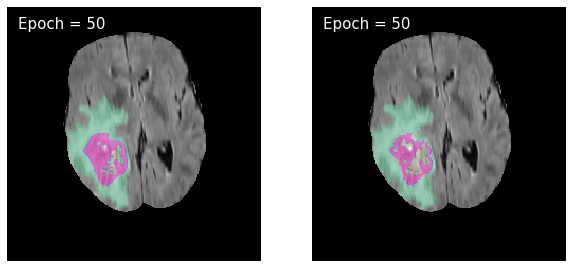

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 52: model 2 : train_loss : 0.2857927195311126, valid_loss : 0.2859417045468925


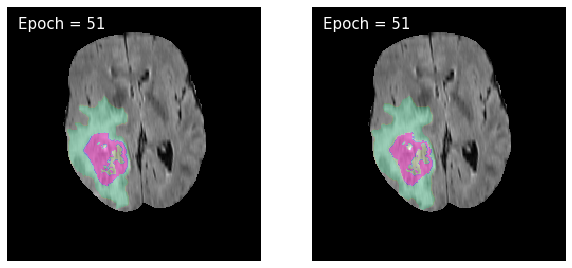

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 53: model 2 : train_loss : 0.2858018103061906, valid_loss : 0.2857514056627468


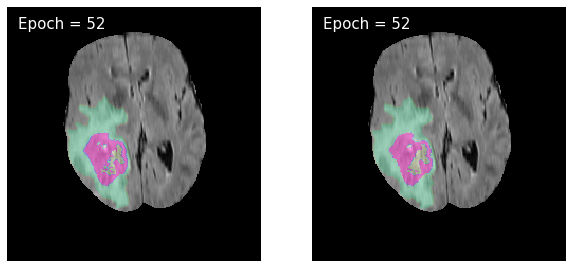

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 54: model 2 : train_loss : 0.28600725798265514, valid_loss : 0.2861746151440887


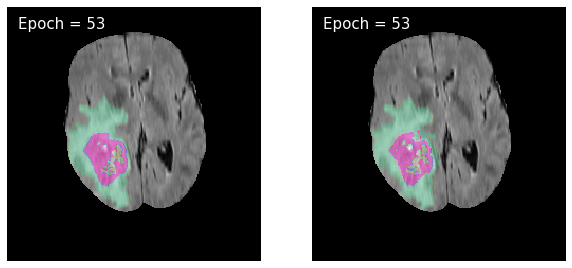

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 55: model 2 : train_loss : 0.28577071915003543, valid_loss : 0.2862557266508379


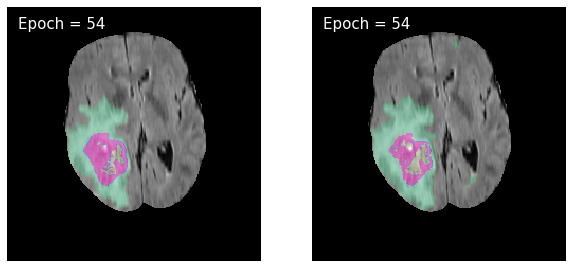

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 56: model 2 : train_loss : 0.28581137358475583, valid_loss : 0.28588851841707386


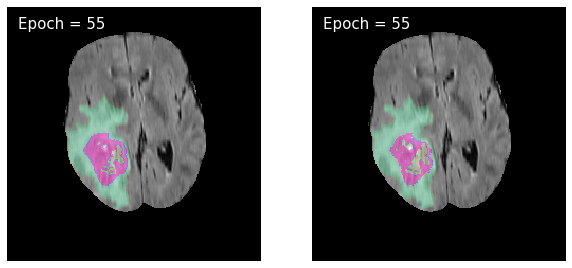

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 57: model 2 : train_loss : 0.2857030107404295, valid_loss : 0.28564934047960466


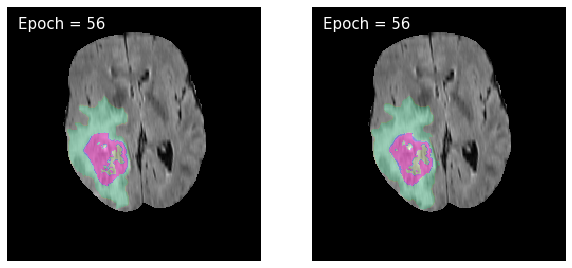

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 58: model 2 : train_loss : 0.2857308724449252, valid_loss : 0.28579221974297236


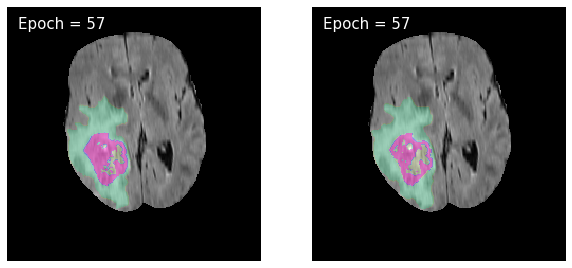

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 59: model 2 : train_loss : 0.28575336619778235, valid_loss : 0.28581547168313814


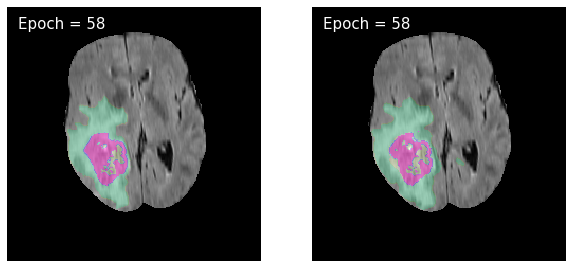

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 60: model 2 : train_loss : 0.2857050317645873, valid_loss : 0.2858934336772529


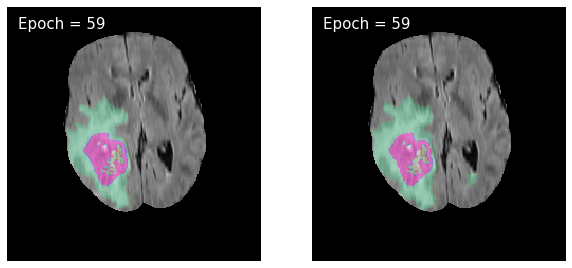

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 61: model 2 : train_loss : 0.28569883674849866, valid_loss : 0.28578142637527115


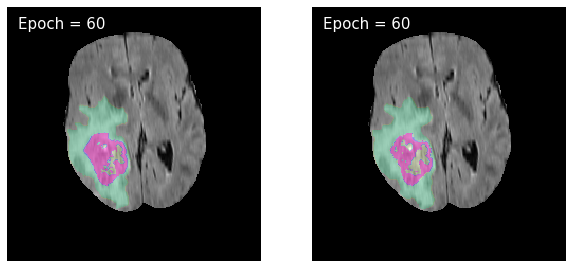

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 62: model 2 : train_loss : 0.2857522226420025, valid_loss : 0.28568020134523353


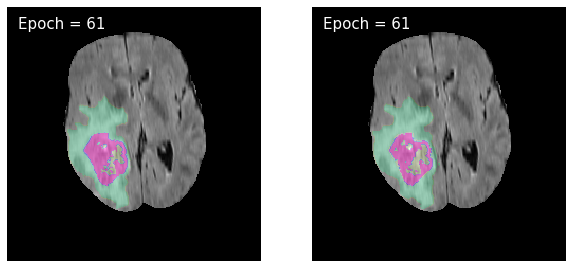

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 63: model 2 : train_loss : 0.2856494947701226, valid_loss : 0.2856958737216329


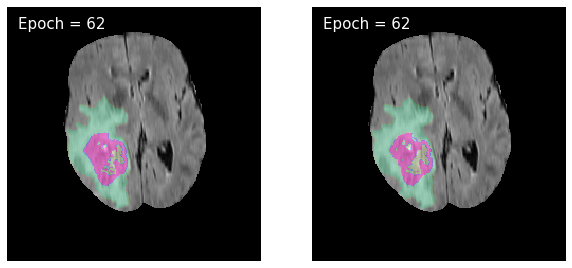

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 64: model 2 : train_loss : 0.2857173648589943, valid_loss : 0.28586588868050167


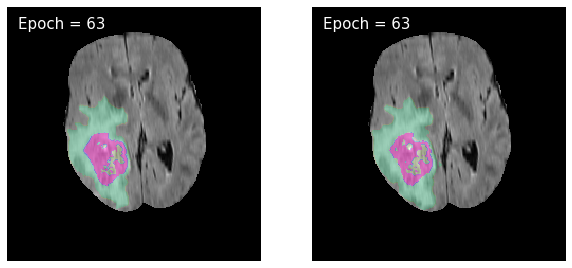

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 65: model 2 : train_loss : 0.2856738053312238, valid_loss : 0.28561924970758856


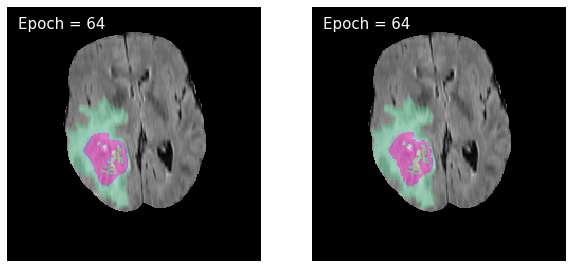

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 66: model 2 : train_loss : 0.28567381986568974, valid_loss : 0.28568202962157546


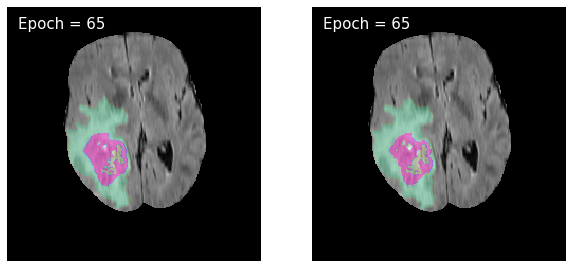

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 67: model 2 : train_loss : 0.28589695418707745, valid_loss : 0.28637307898331715


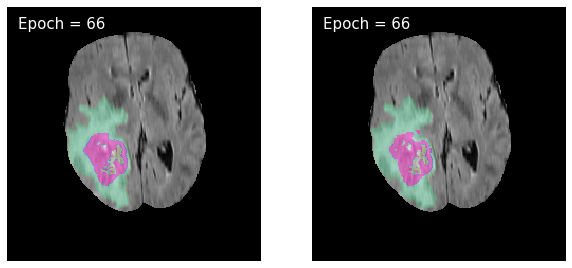

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 68: model 2 : train_loss : 0.28574140899933426, valid_loss : 0.2856353963975624


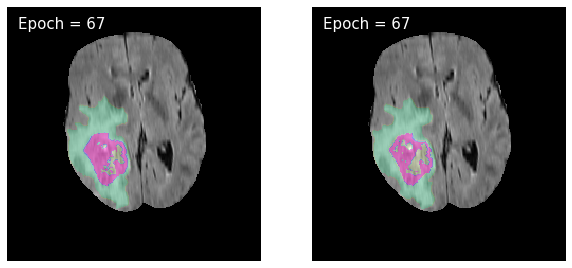

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 69: model 2 : train_loss : 0.28561536477716176, valid_loss : 0.28594922206254414


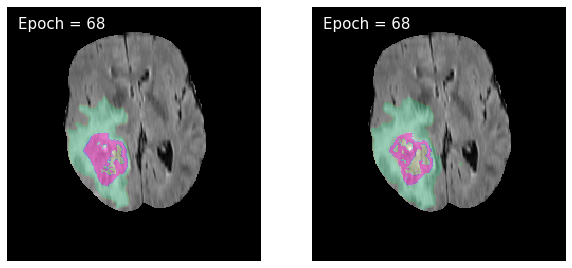

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 70: model 2 : train_loss : 0.2855947441702721, valid_loss : 0.285571860249645


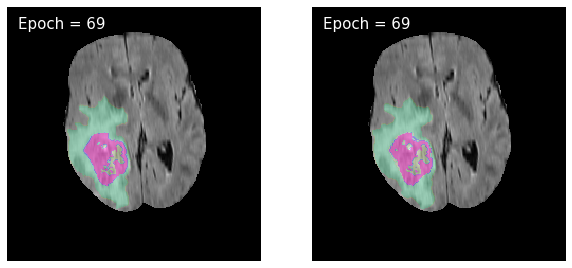

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 71: model 2 : train_loss : 0.28555336174548873, valid_loss : 0.28569950768223373


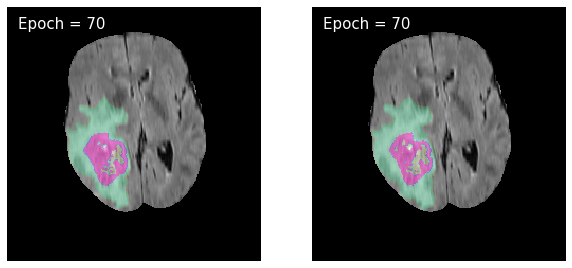

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 72: model 2 : train_loss : 0.28560929610425195, valid_loss : 0.2855743112903769


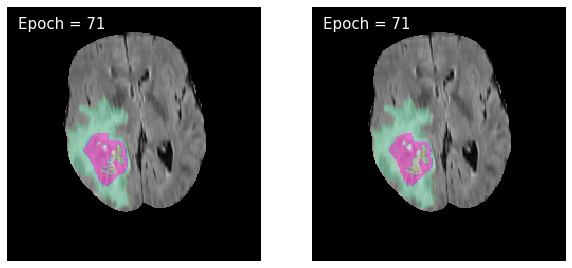

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 73: model 2 : train_loss : 0.28553413944756423, valid_loss : 0.2857975829592956


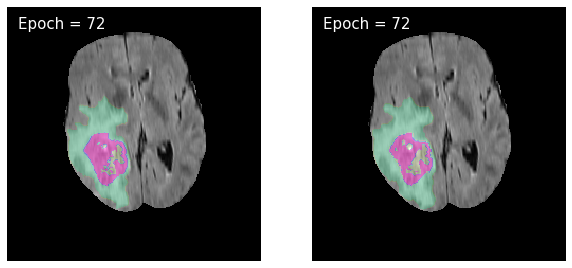

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 74: model 2 : train_loss : 0.2855805854002635, valid_loss : 0.285648481579878


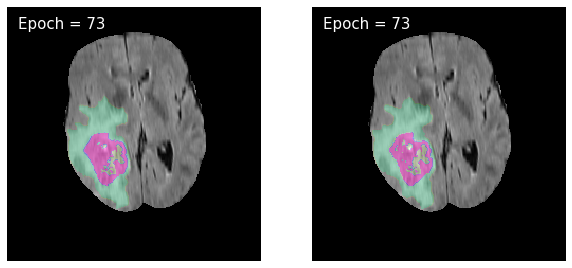

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 75: model 2 : train_loss : 0.28555603475378666, valid_loss : 0.2857281334938542


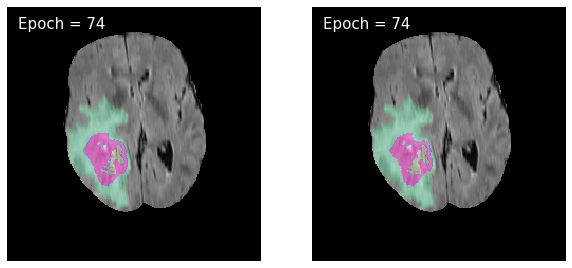

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 76: model 2 : train_loss : 0.2855631432410588, valid_loss : 0.28567180085566735


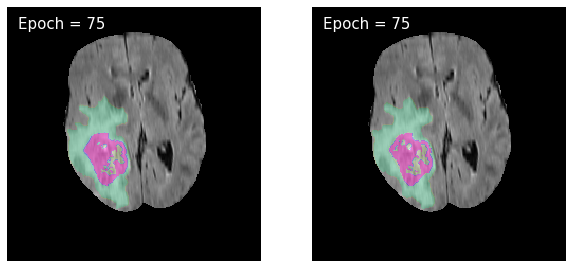

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 77: model 2 : train_loss : 0.2856799418760893, valid_loss : 0.285877496204389


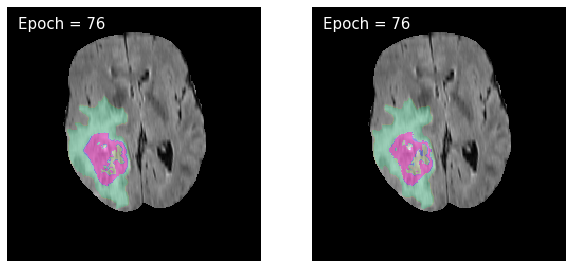

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 78: model 2 : train_loss : 0.2855542128784811, valid_loss : 0.28586339233543284


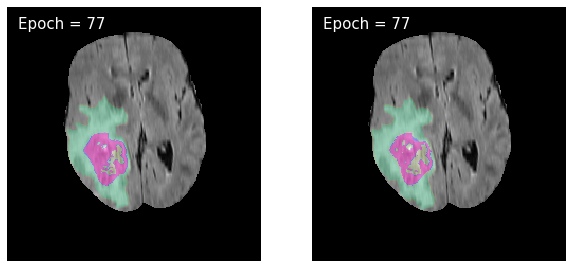

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 79: model 2 : train_loss : 0.28556383762850324, valid_loss : 0.28565879206183137


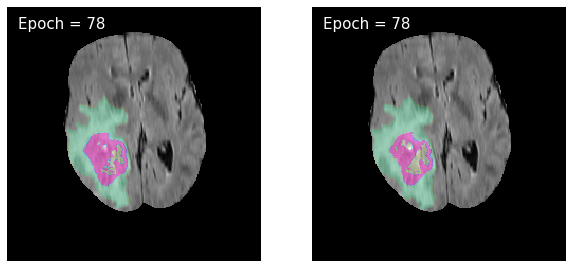

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 80: model 2 : train_loss : 0.2855515605384605, valid_loss : 0.286367740802547


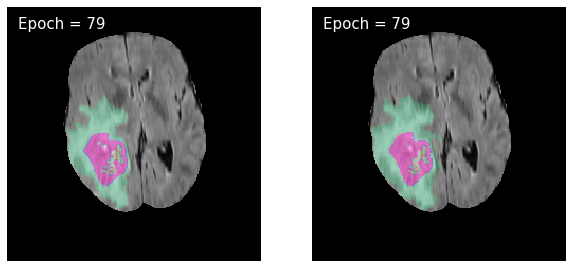

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 81: model 2 : train_loss : 0.2856987666096997, valid_loss : 0.2858378587150446


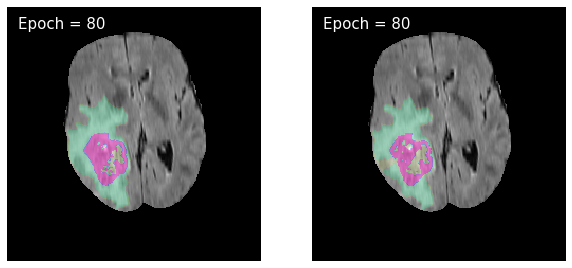

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 82: model 2 : train_loss : 0.2854402165284893, valid_loss : 0.28542841730579255


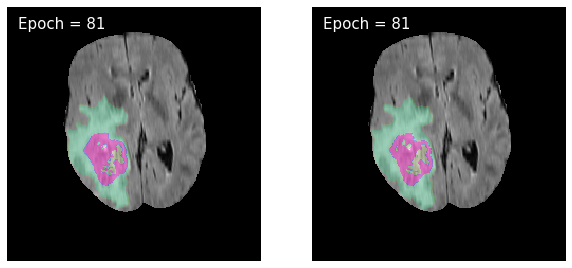

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 83: model 2 : train_loss : 0.2853461630659082, valid_loss : 0.28541050338616936


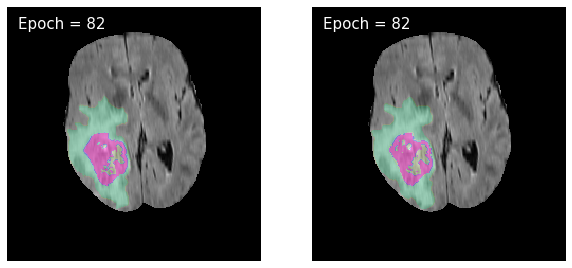

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 84: model 2 : train_loss : 0.28532805285464463, valid_loss : 0.2854061310169517


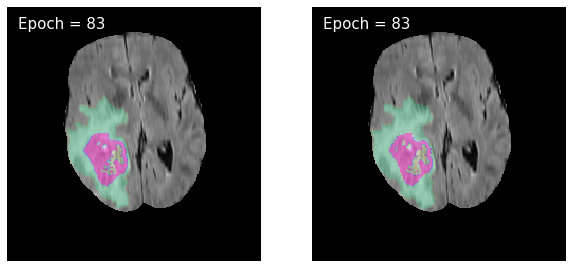

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 85: model 2 : train_loss : 0.2853004505036928, valid_loss : 0.285390496013626


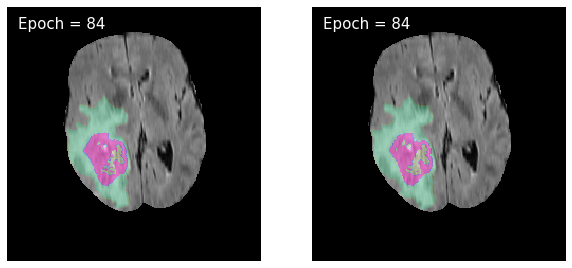

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 86: model 2 : train_loss : 0.2852912044498478, valid_loss : 0.285376645824922


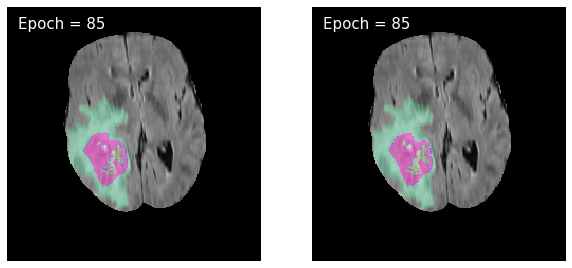

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 87: model 2 : train_loss : 0.2852734928696481, valid_loss : 0.285362190657085


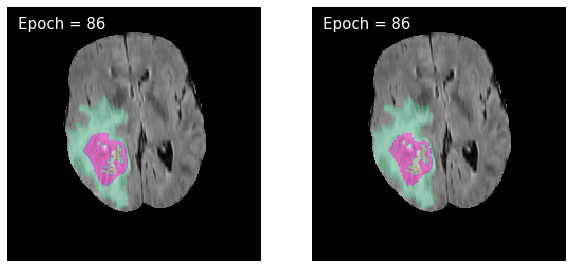

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 88: model 2 : train_loss : 0.28526428595218617, valid_loss : 0.2853683414718797


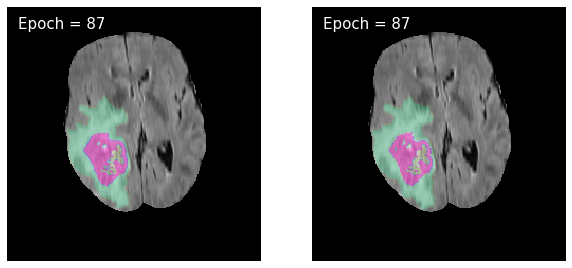

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 89: model 2 : train_loss : 0.2852562799949774, valid_loss : 0.2853668604086163


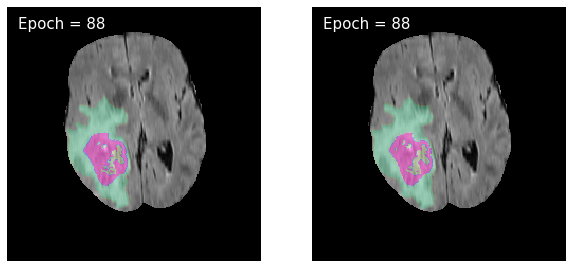

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 90: model 2 : train_loss : 0.28524548875405487, valid_loss : 0.2853618650346674


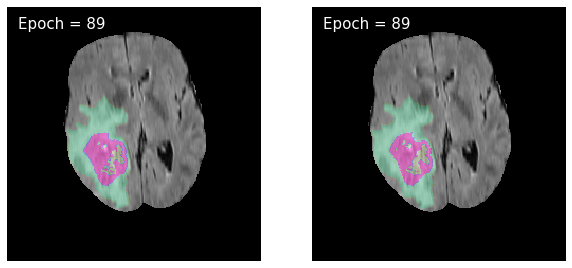

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 91: model 2 : train_loss : 0.28524571963871354, valid_loss : 0.28536412039751646


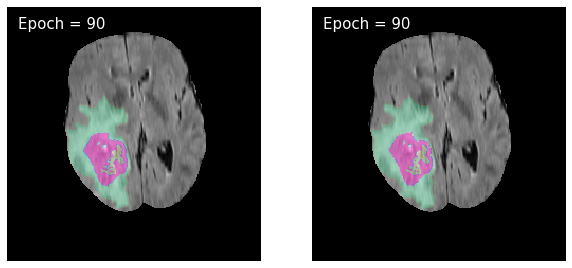

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 92: model 2 : train_loss : 0.28523503680623885, valid_loss : 0.28535234579636204


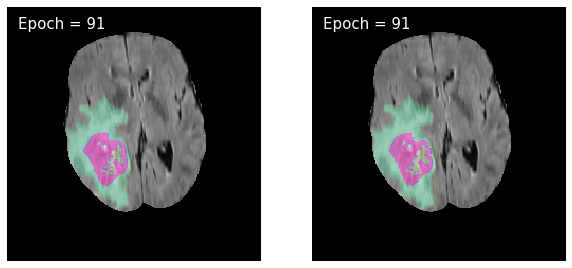

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 93: model 2 : train_loss : 0.2852287410489665, valid_loss : 0.28535773917551965


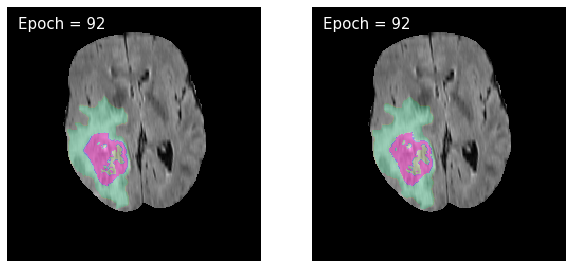

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 94: model 2 : train_loss : 0.285220753826551, valid_loss : 0.2853748783549314


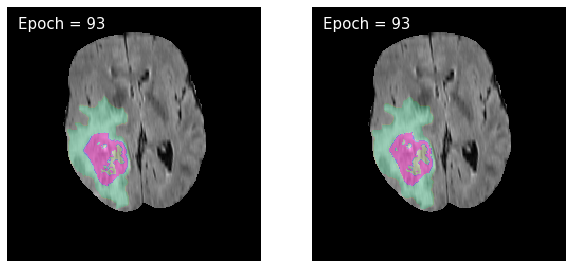

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 95: model 2 : train_loss : 0.28521507618411274, valid_loss : 0.2853491530623487


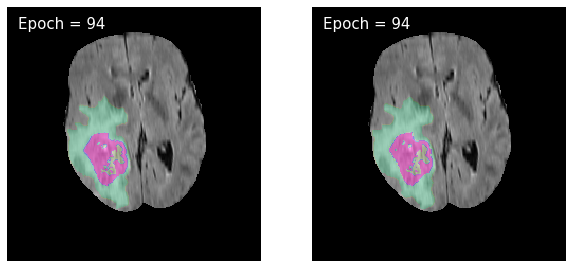

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 96: model 2 : train_loss : 0.28520805343685535, valid_loss : 0.28535367236022025


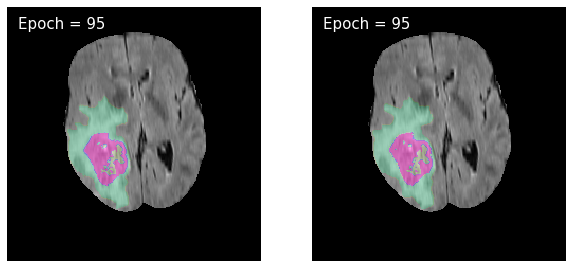

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 97: model 2 : train_loss : 0.28520280416113153, valid_loss : 0.28535480128340823


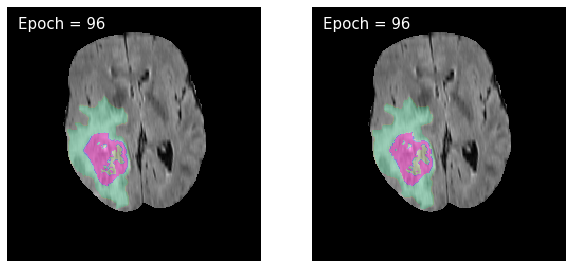

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 98: model 2 : train_loss : 0.28519702544415027, valid_loss : 0.2853503506029806


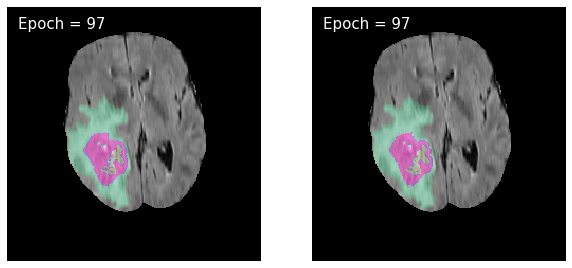

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 99: model 2 : train_loss : 0.2851903412566089, valid_loss : 0.2853514759210489


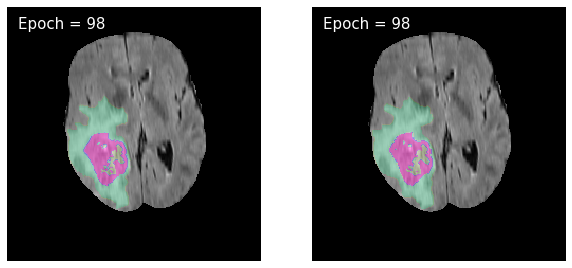

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 100: model 2 : train_loss : 0.28518467248152835, valid_loss : 0.2853540872293775


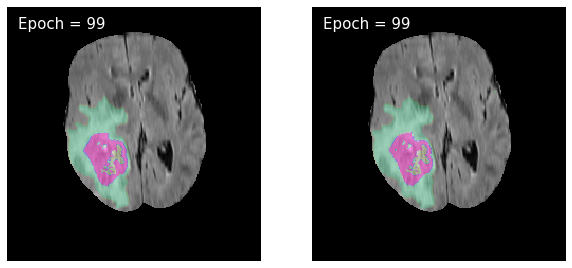

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 101: model 2 : train_loss : 0.2851797871008282, valid_loss : 0.2853464738576002


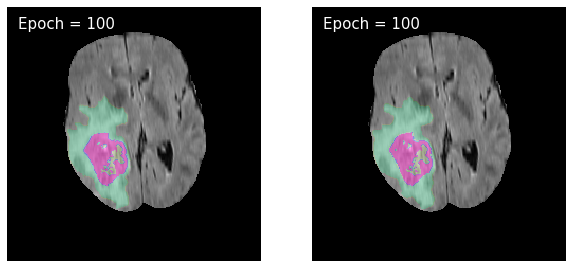

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 102: model 2 : train_loss : 0.2851612524564901, valid_loss : 0.28534372984081185


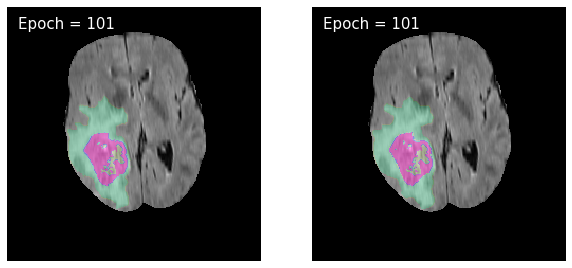

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 103: model 2 : train_loss : 0.2851562972703503, valid_loss : 0.2853438230531831


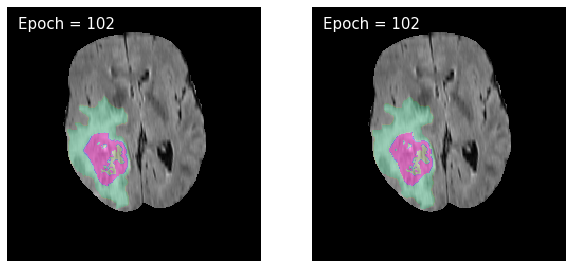

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 104: model 2 : train_loss : 0.2851576204401268, valid_loss : 0.28533978199446075


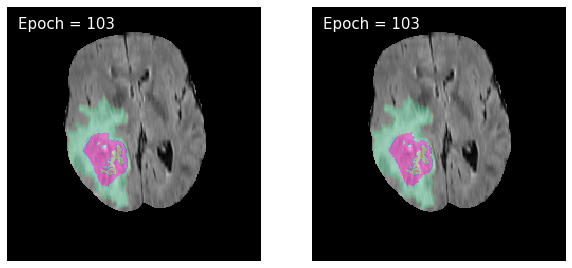

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 105: model 2 : train_loss : 0.28515517138261387, valid_loss : 0.2853423638609789


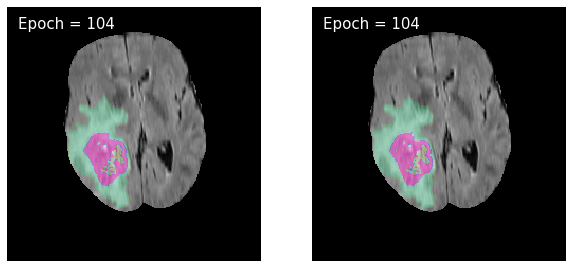

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 106: model 2 : train_loss : 0.2851512502103844, valid_loss : 0.2853427502897478


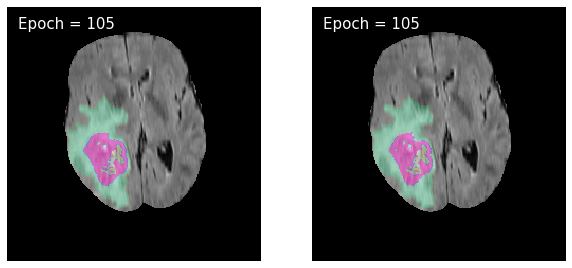

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 107: model 2 : train_loss : 0.28515333743970134, valid_loss : 0.2853431584293483


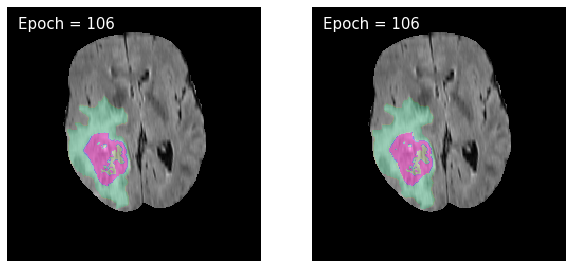

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 108: model 2 : train_loss : 0.28515057642454533, valid_loss : 0.2853452019713899


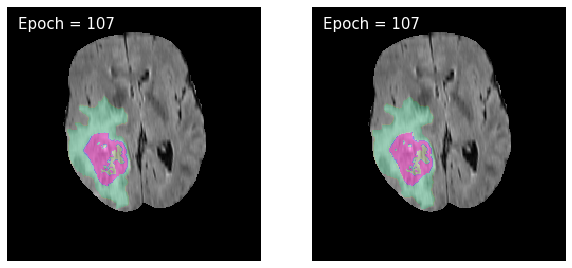

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 109: model 2 : train_loss : 0.28515509017628576, valid_loss : 0.28534248827766345


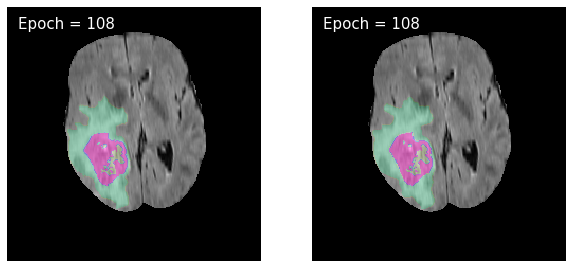

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 110: model 2 : train_loss : 0.2851490992427672, valid_loss : 0.2853375533896108


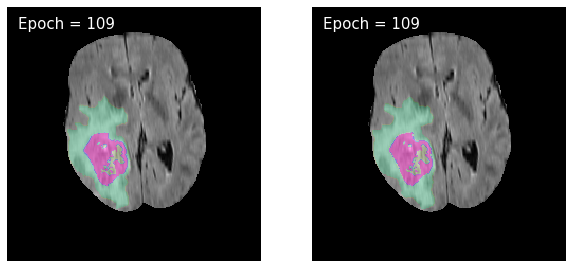

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 111: model 2 : train_loss : 0.285151888393449, valid_loss : 0.28534612019536315


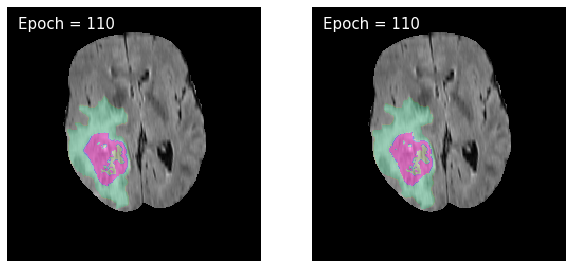

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 112: model 2 : train_loss : 0.2851486370734187, valid_loss : 0.2853398770494487


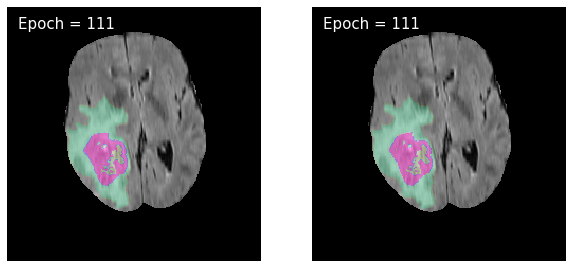

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 113: model 2 : train_loss : 0.28514417205880954, valid_loss : 0.2853472255651028


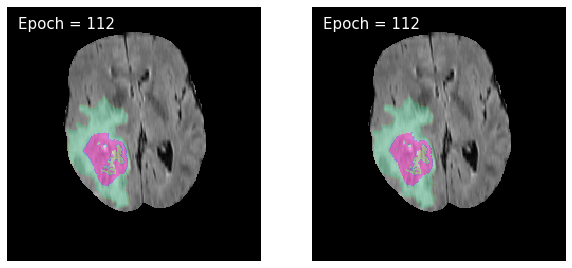

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 114: model 2 : train_loss : 0.28514598033305516, valid_loss : 0.2853427994796025


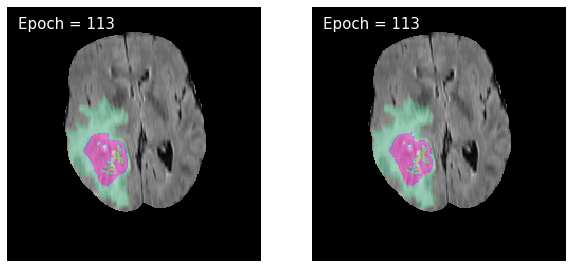

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 115: model 2 : train_loss : 0.2851454063549938, valid_loss : 0.2853400627131103


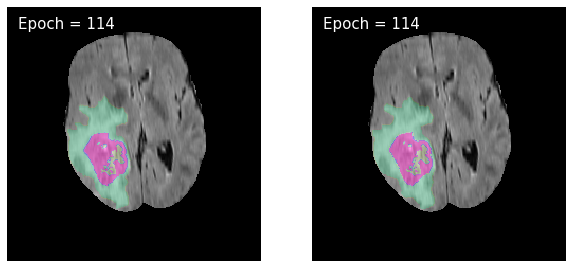

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 116: model 2 : train_loss : 0.2851414083767791, valid_loss : 0.2853382144083259


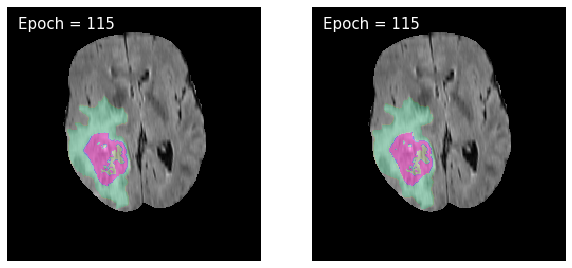

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 117: model 2 : train_loss : 0.28514586665753017, valid_loss : 0.28534389940160576


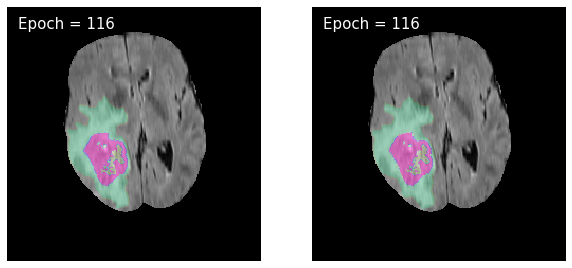

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 118: model 2 : train_loss : 0.28514558210202245, valid_loss : 0.28534327711789836


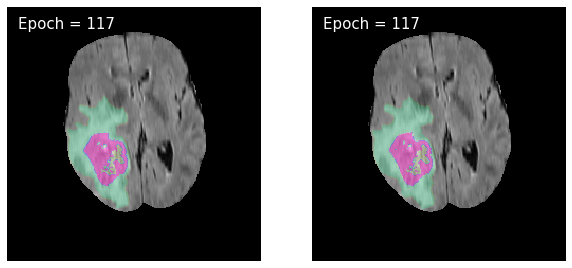

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 119: model 2 : train_loss : 0.285145310480856, valid_loss : 0.28533889169013626


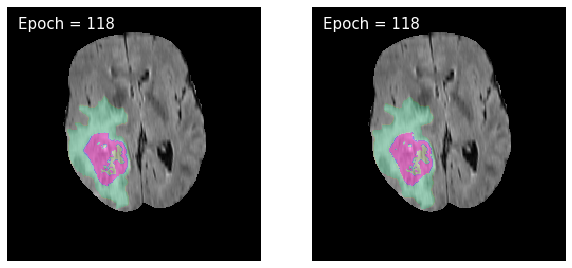

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 120: model 2 : train_loss : 0.28514221090598396, valid_loss : 0.2853431712876084


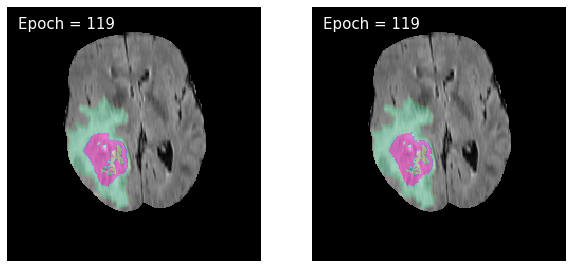

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 121: model 2 : train_loss : 0.28514528481218904, valid_loss : 0.2853378733640076


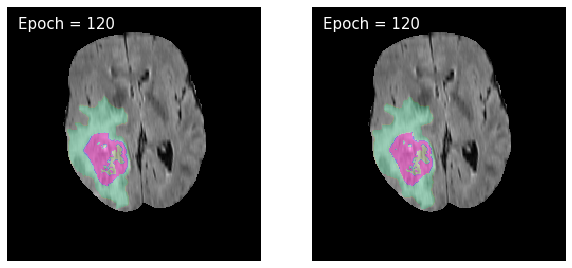

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 122: model 2 : train_loss : 0.28514404784913033, valid_loss : 0.28534394835111915


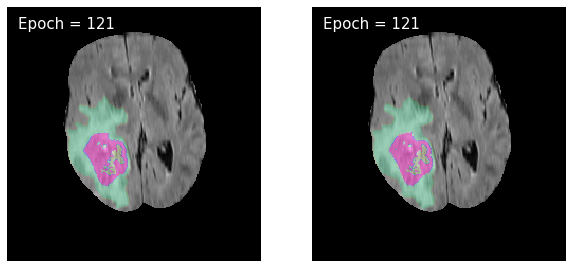

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 123: model 2 : train_loss : 0.2851434171999861, valid_loss : 0.2853433085224962


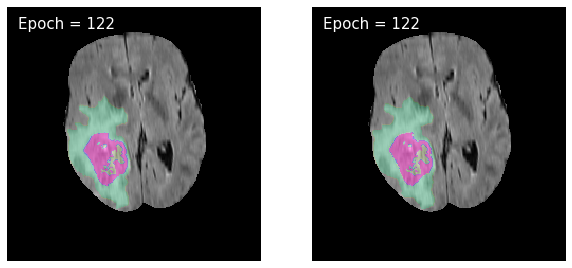

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 124: model 2 : train_loss : 0.28514445701434843, valid_loss : 0.2853397800717303


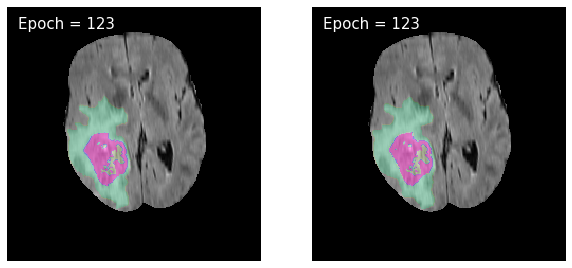

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 125: model 2 : train_loss : 0.2851429084936778, valid_loss : 0.28534153240021837


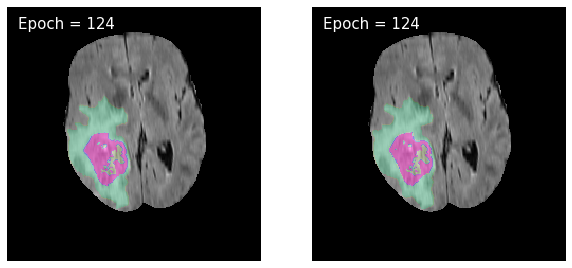

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 126: model 2 : train_loss : 0.2851448232428873, valid_loss : 0.28535335619122754


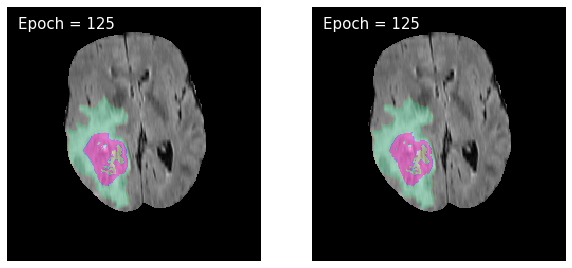

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 127: model 2 : train_loss : 0.2851472080953969, valid_loss : 0.2853412647000564


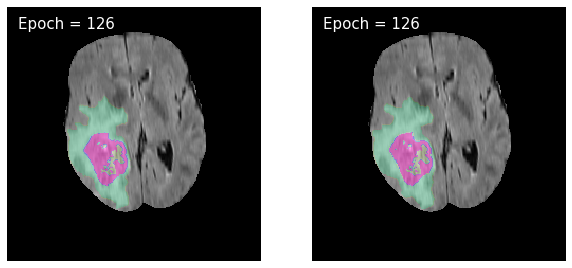

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 128: model 2 : train_loss : 0.28514700821315414, valid_loss : 0.28534471111432197


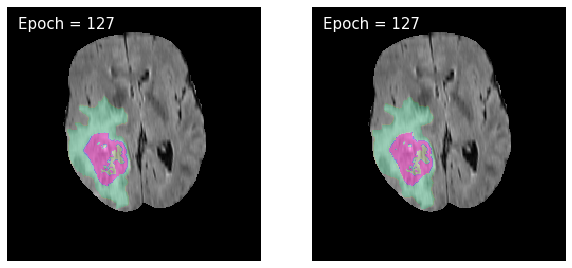

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 129: model 2 : train_loss : 0.2851444004766093, valid_loss : 0.28534216782258404


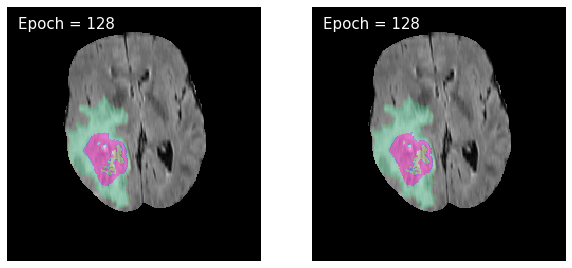

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 130: model 2 : train_loss : 0.28514806722901276, valid_loss : 0.28534401268247633


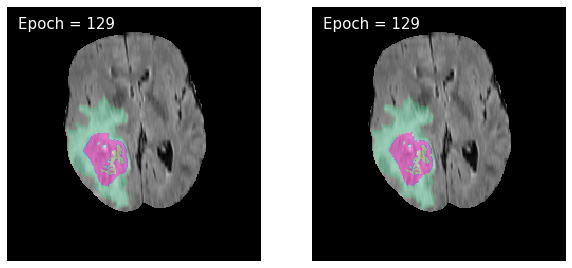

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 131: model 2 : train_loss : 0.2851447159011892, valid_loss : 0.28533916868349557


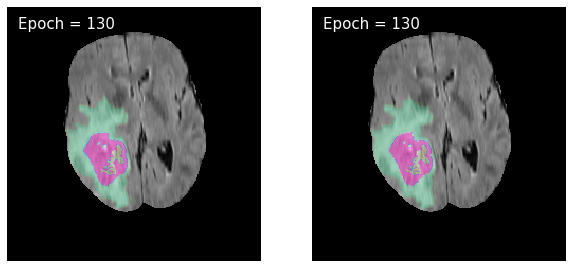

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 132: model 2 : train_loss : 0.28514328965671376, valid_loss : 0.28535209592151384


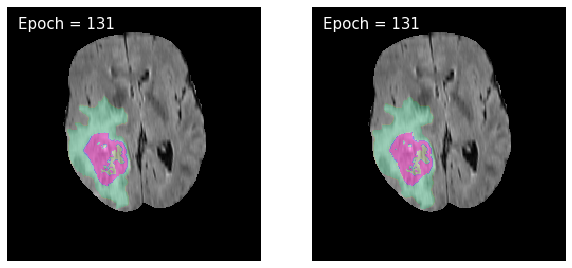

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 133: model 2 : train_loss : 0.2851439673761927, valid_loss : 0.2853406270745621


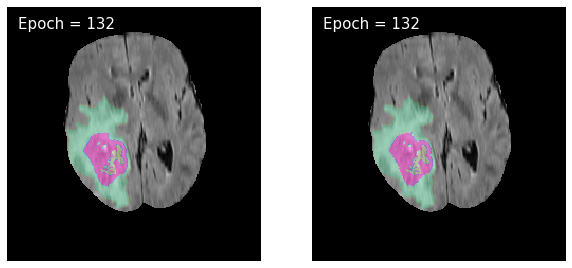

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 134: model 2 : train_loss : 0.2851432567874857, valid_loss : 0.2853451974449619


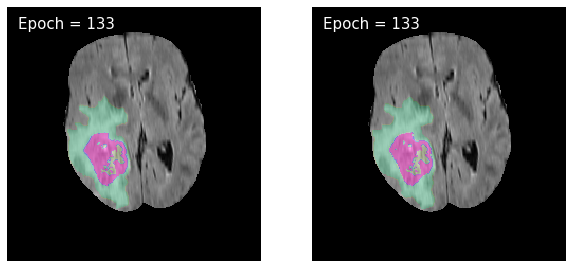

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 135: model 2 : train_loss : 0.285144053316223, valid_loss : 0.2853479670580997


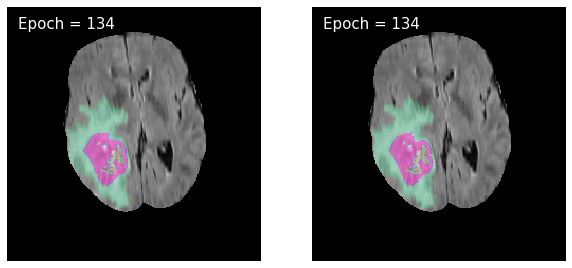

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 136: model 2 : train_loss : 0.2851434624701805, valid_loss : 0.2853407772478237


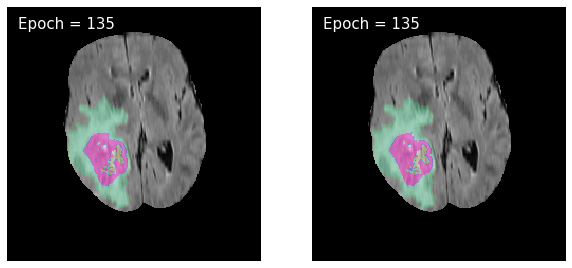

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 137: model 2 : train_loss : 0.28514652304201316, valid_loss : 0.28533978592003545


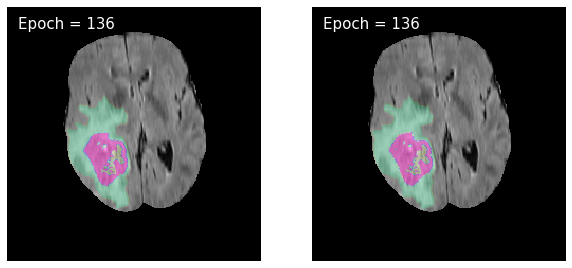

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 138: model 2 : train_loss : 0.28514384143304505, valid_loss : 0.2853388741852776


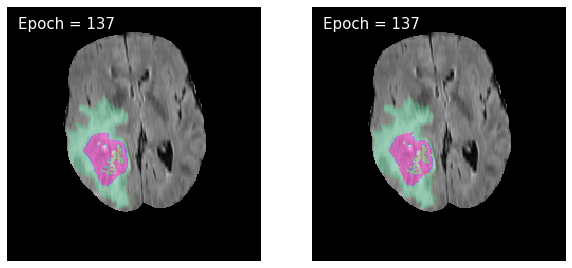

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 139: model 2 : train_loss : 0.28514436234030416, valid_loss : 0.28534259394772593


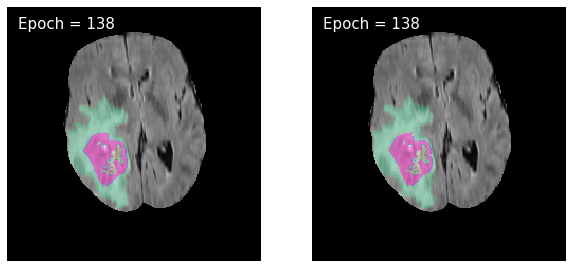

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 140: model 2 : train_loss : 0.2851444304789473, valid_loss : 0.28534012079559345


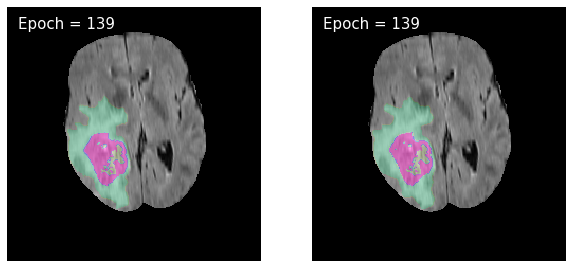

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 141: model 2 : train_loss : 0.2851452248075131, valid_loss : 0.2853421883317091


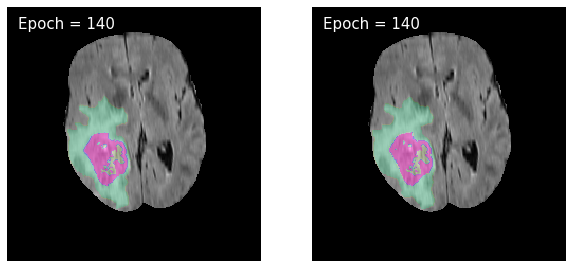

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 142: model 2 : train_loss : 0.2851438004298498, valid_loss : 0.2853415402513678


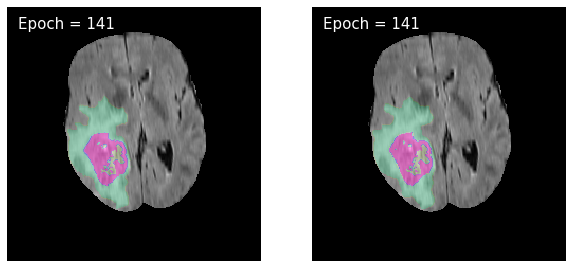

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 143: model 2 : train_loss : 0.2851447622381334, valid_loss : 0.2853466870002849


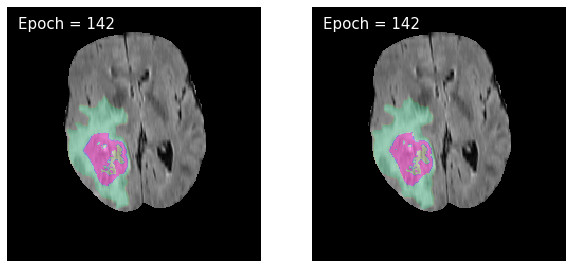

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 144: model 2 : train_loss : 0.2851419468854098, valid_loss : 0.28534518510744133


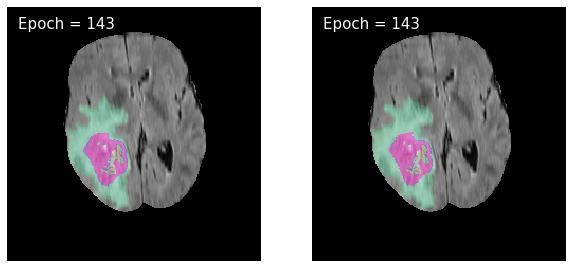

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 145: model 2 : train_loss : 0.2851460030681602, valid_loss : 0.2853401570470743


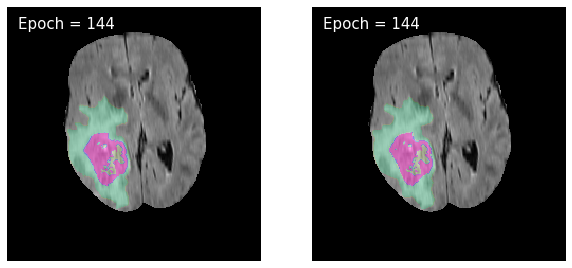

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 146: model 2 : train_loss : 0.285145102464646, valid_loss : 0.28534186447179444


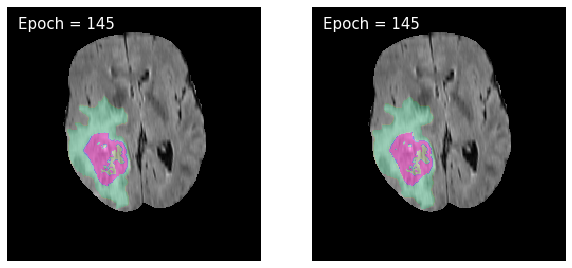

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 147: model 2 : train_loss : 0.28514677679512057, valid_loss : 0.28534956448661386


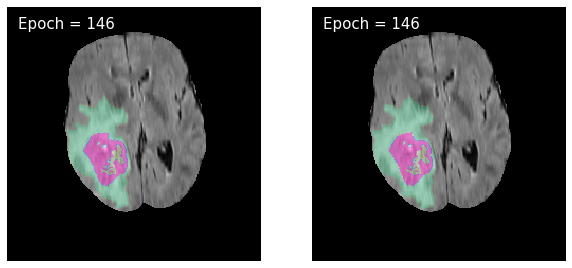

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 148: model 2 : train_loss : 0.28514262253806094, valid_loss : 0.28534392371613493


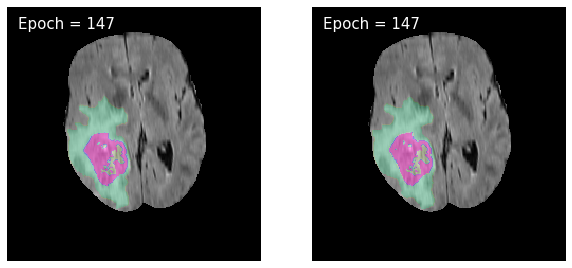

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 149: model 2 : train_loss : 0.28514293282890746, valid_loss : 0.2853435959707024


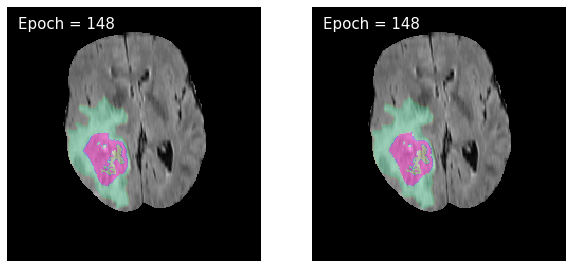

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 150: model 2 : train_loss : 0.28514471703461086, valid_loss : 0.28534036726560646


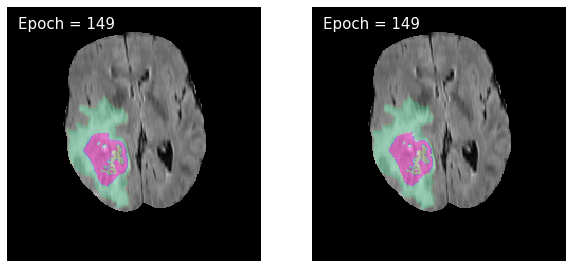

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 151: model 2 : train_loss : 0.2851448292433549, valid_loss : 0.2853401323319763


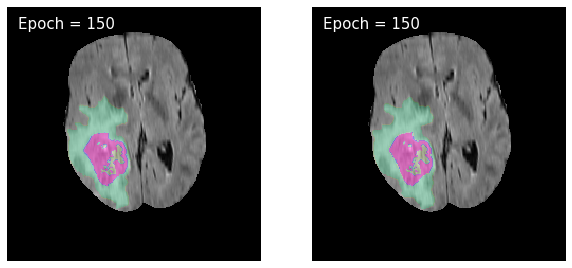

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 152: model 2 : train_loss : 0.2851439193724519, valid_loss : 0.28533964319735444


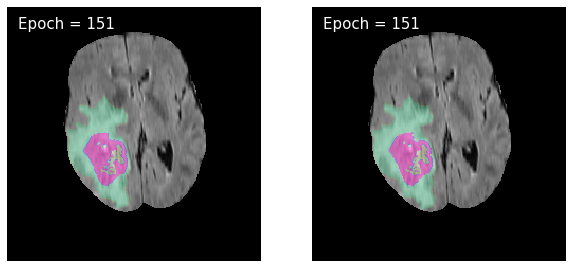

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 153: model 2 : train_loss : 0.28514357941262675, valid_loss : 0.2853402315128234


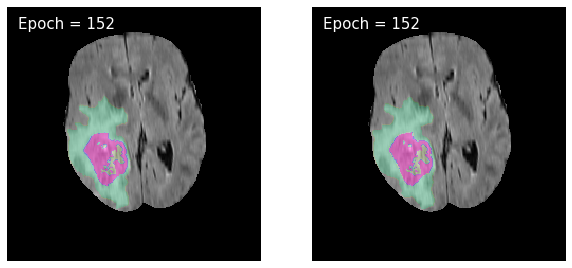

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 154: model 2 : train_loss : 0.2851448239096059, valid_loss : 0.28534093050546544


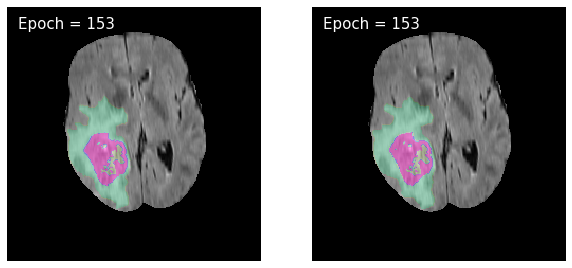

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 155: model 2 : train_loss : 0.2851389067151669, valid_loss : 0.2853417130167125


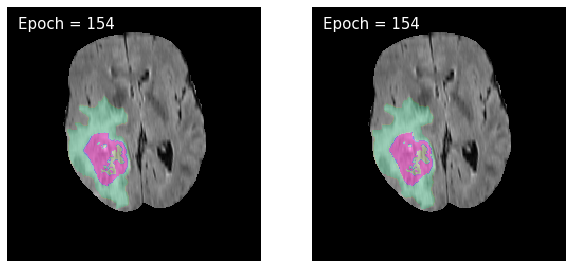

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 156: model 2 : train_loss : 0.285144310669611, valid_loss : 0.28534383354808696


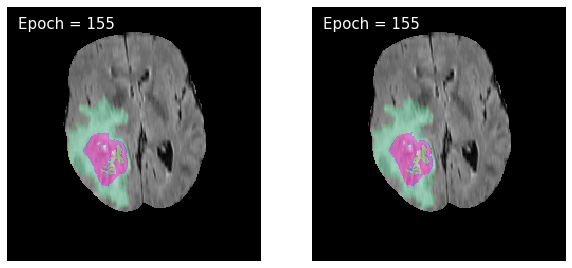

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 157: model 2 : train_loss : 0.28514521980712343, valid_loss : 0.2853429469690528


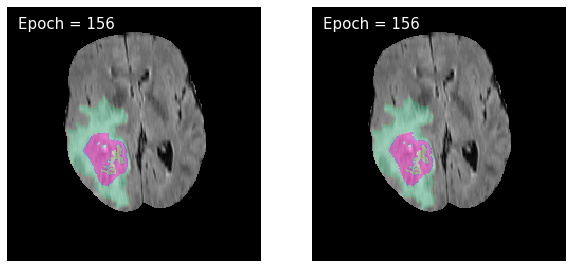

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 158: model 2 : train_loss : 0.28514442721202604, valid_loss : 0.2853392205171047


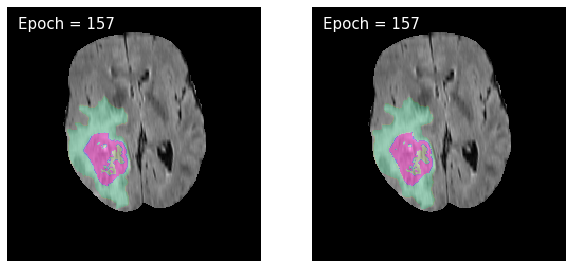

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 159: model 2 : train_loss : 0.285142818419992, valid_loss : 0.28535359236662106


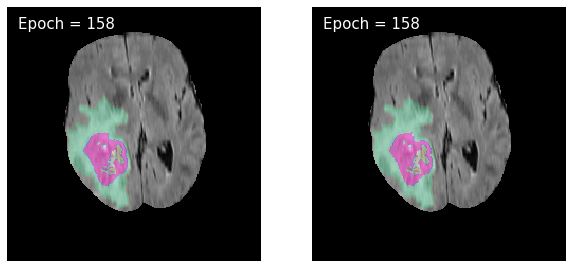

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 160: model 2 : train_loss : 0.28514451521888406, valid_loss : 0.28534262407050337


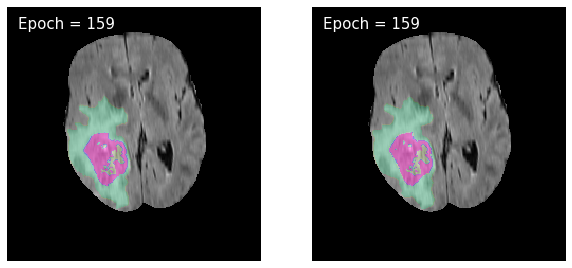

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 161: model 2 : train_loss : 0.28514464376223436, valid_loss : 0.28535090759396553


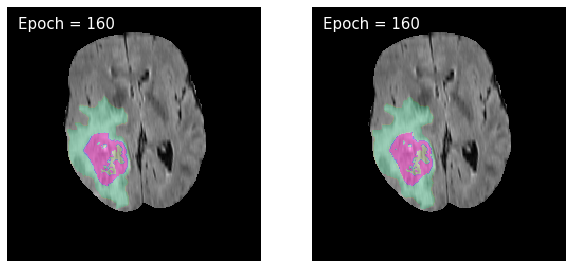

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 162: model 2 : train_loss : 0.28514396037564715, valid_loss : 0.28534084410276467


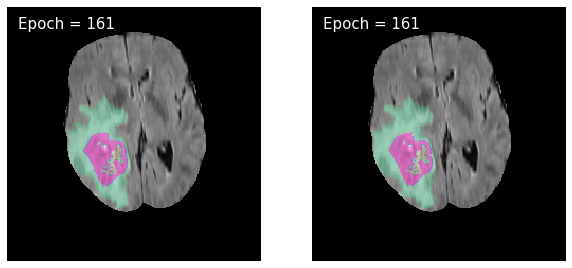

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 163: model 2 : train_loss : 0.28514113828906545, valid_loss : 0.28534126017362843


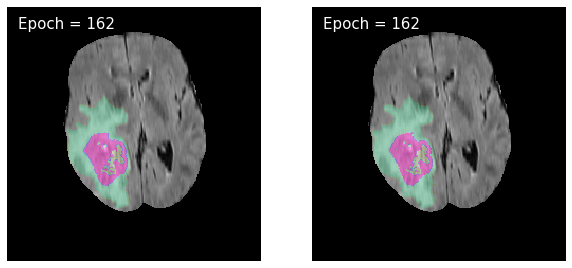

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 164: model 2 : train_loss : 0.2851453774860775, valid_loss : 0.28534140305653694


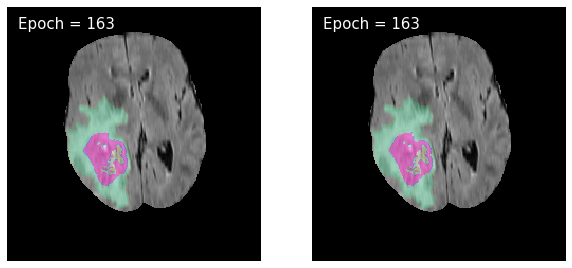

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 165: model 2 : train_loss : 0.2851430420374177, valid_loss : 0.28534384993135287


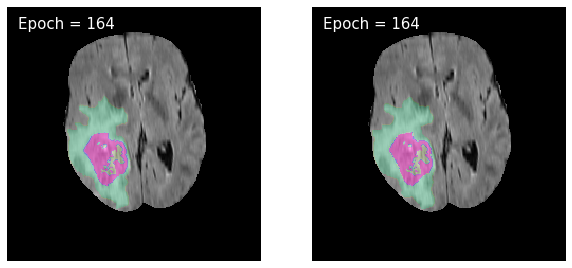

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 166: model 2 : train_loss : 0.2851420330254557, valid_loss : 0.2853396834545238


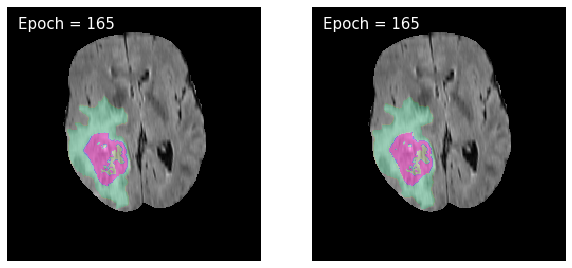

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 167: model 2 : train_loss : 0.28514438887570526, valid_loss : 0.2853470053724063


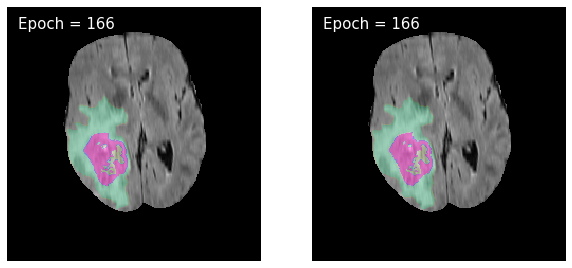

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 168: model 2 : train_loss : 0.2851435472101173, valid_loss : 0.2853409614293806


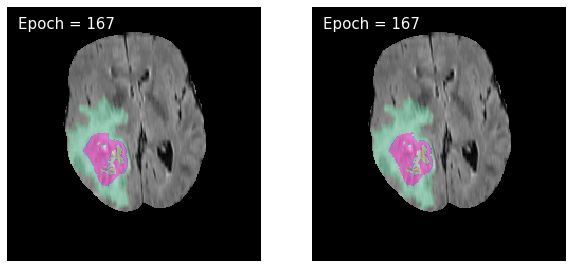

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 169: model 2 : train_loss : 0.2851427685494391, valid_loss : 0.285348566389212


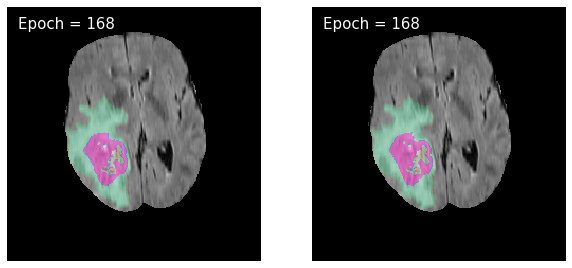

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 170: model 2 : train_loss : 0.2851430593721019, valid_loss : 0.28534504294555674


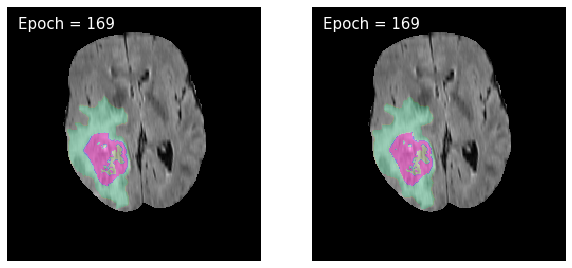

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 171: model 2 : train_loss : 0.2851433037244767, valid_loss : 0.2853443261276009


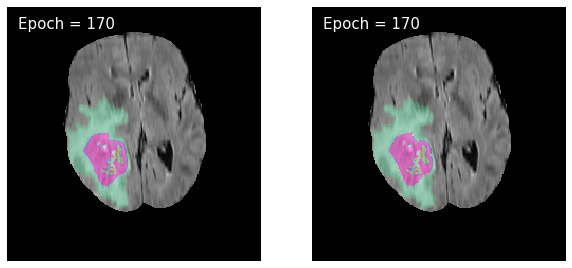

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 172: model 2 : train_loss : 0.28514461836025484, valid_loss : 0.2853476147177399


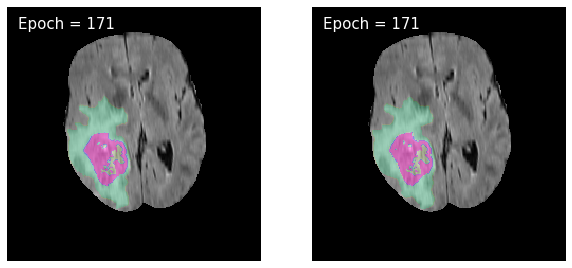

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 173: model 2 : train_loss : 0.285142435790175, valid_loss : 0.2853442368808613


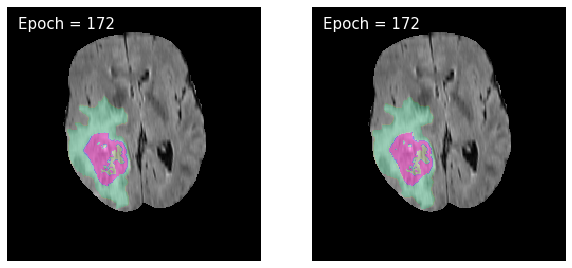

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 174: model 2 : train_loss : 0.2851454320236607, valid_loss : 0.2853394101463979


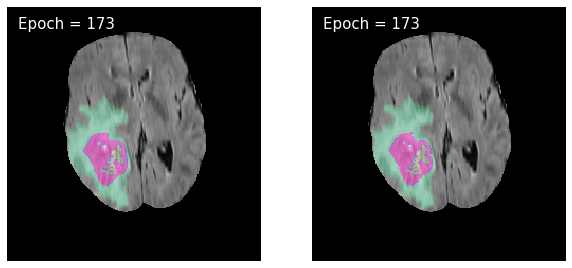

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 175: model 2 : train_loss : 0.28514330699139795, valid_loss : 0.28534516760258266


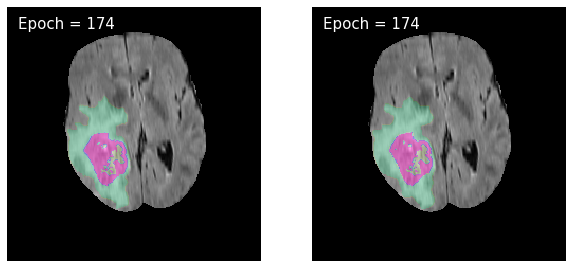

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 176: model 2 : train_loss : 0.2851453018801858, valid_loss : 0.28533792315471557


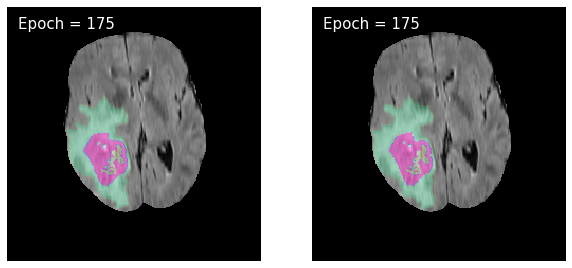

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 177: model 2 : train_loss : 0.2851434928058778, valid_loss : 0.2853410714255866


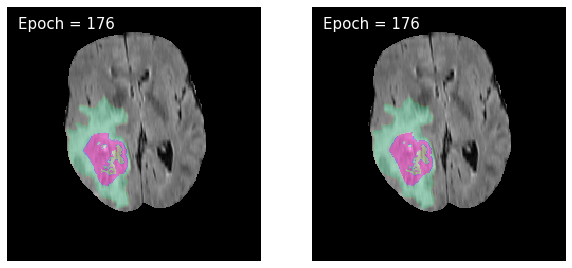

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 178: model 2 : train_loss : 0.2851432354524898, valid_loss : 0.28534332630775305


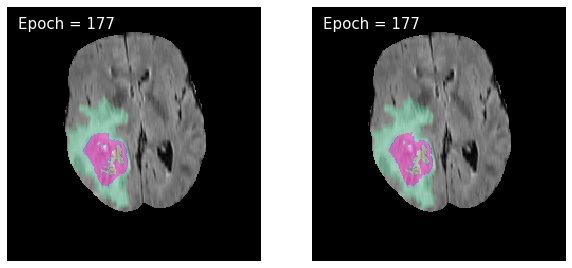

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 179: model 2 : train_loss : 0.2851439772436283, valid_loss : 0.2853419621705368


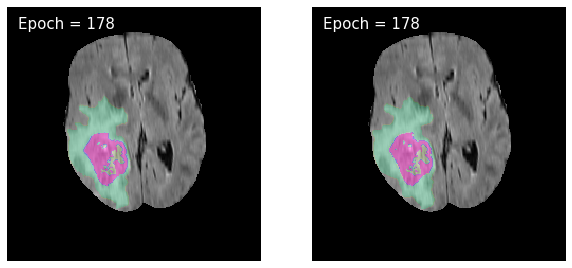

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 180: model 2 : train_loss : 0.2851459595314342, valid_loss : 0.2853392570890406


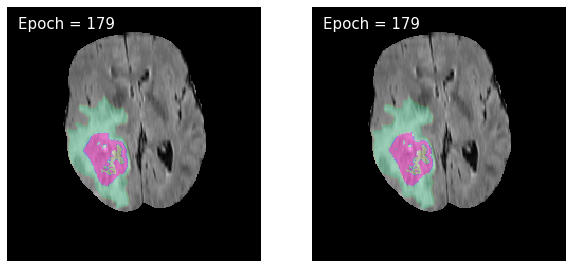

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 181: model 2 : train_loss : 0.28514281181947765, valid_loss : 0.28534549098181466


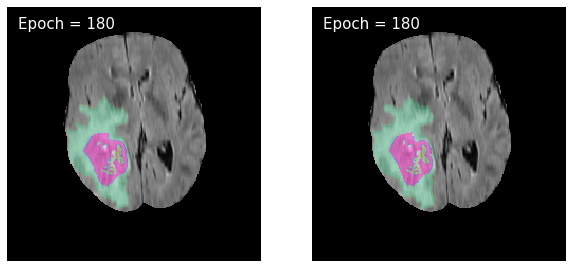

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 182: model 2 : train_loss : 0.28514183574341556, valid_loss : 0.28534263003897925


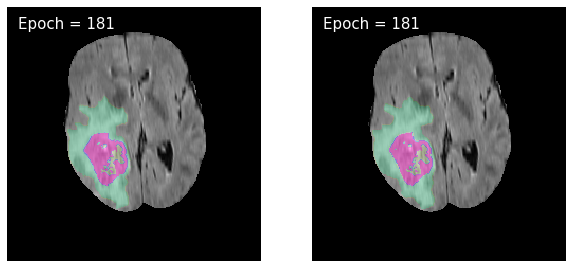

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 183: model 2 : train_loss : 0.2851450069905394, valid_loss : 0.28534284826888834


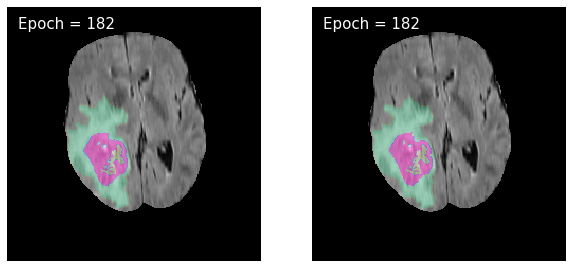

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 184: model 2 : train_loss : 0.28514186661248775, valid_loss : 0.28534108612646336


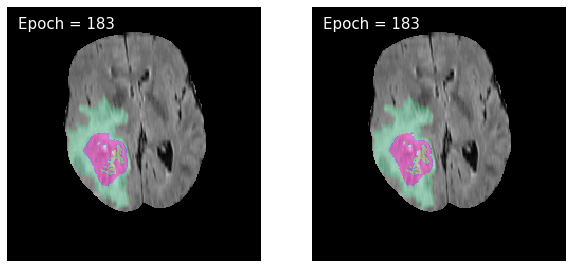

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 185: model 2 : train_loss : 0.285146002668129, valid_loss : 0.28534023992476926


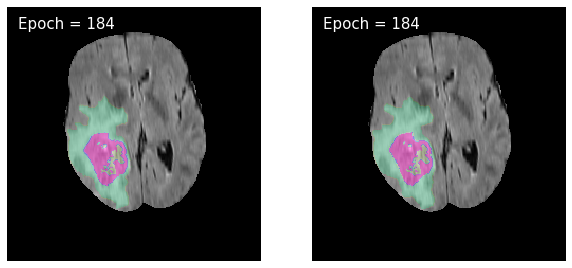

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 186: model 2 : train_loss : 0.2851444903502795, valid_loss : 0.2853366152974226


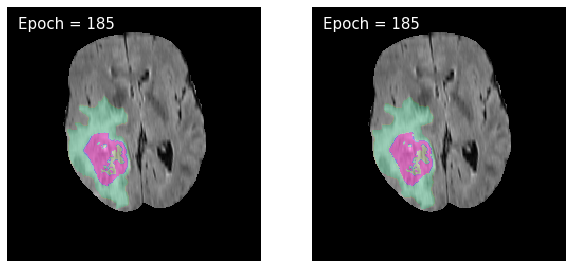

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 187: model 2 : train_loss : 0.2851454927617271, valid_loss : 0.28534250097569597


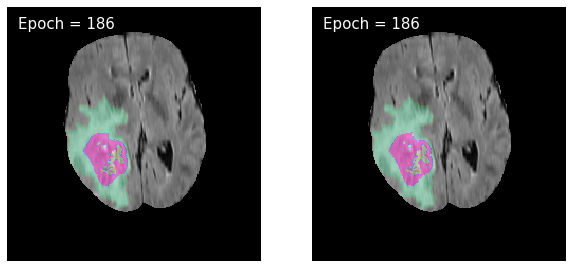

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 188: model 2 : train_loss : 0.28514303063652924, valid_loss : 0.28534699976444244


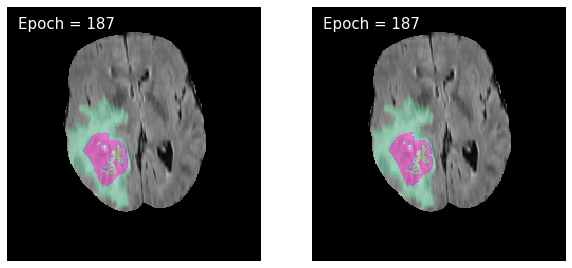

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 189: model 2 : train_loss : 0.28514408618545106, valid_loss : 0.2853412510807155


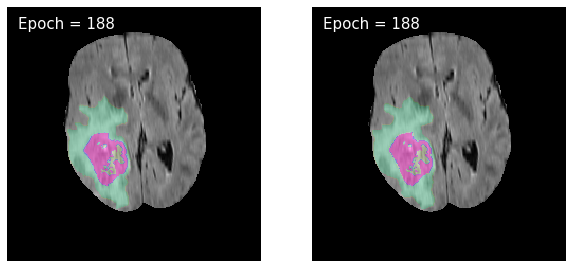

  0%|          | 0/224 [00:00<?, ?it/s]

  0%|          | 0/149 [00:00<?, ?it/s]

Epoch 190: model 2 : train_loss : 0.28514355647750617, valid_loss : 0.2853425530496464


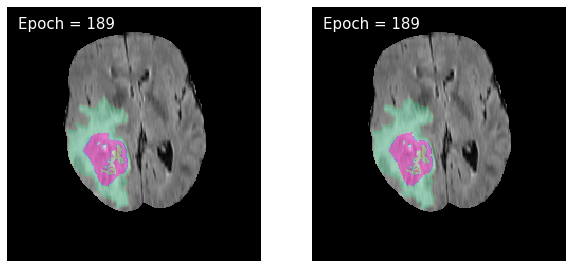

  0%|          | 0/224 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [20]:
model_1.load_state_dict(torch.load(f"./model/{save_1}.pt"))
model_1.eval()

    
loss_2 =0.
min_valid_loss = np.inf
train_loss_list_2 = []
valid_loss_list_2 = []

for i in tqdm(range(num_epoch)):
    train_loss_2 = 0.0
    valid_loss_2 = 0.0
    model_2.train()
    
    for image,label in tqdm(train_loader, leave=False):
      
        optimizer_2.zero_grad()
        image,label= image.to(device), label.to(device)

        # output =model_1(image)
        # check = threshold_img(output)
        output_2 = model_2(image)
        # check = threshold_img(output)
        # check = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).float()
        # output_2 = torch.concat((check,output_2),dim=1)       
        
        loss_2   = loss_func(output_2, label[:,1:])  #0:normal data 
        loss_2.backward()
        optimizer_2.step()
        train_loss_2 += loss_2.item()*image.size(0)#
    train_loss_2 = train_loss_2/len(train_loader.sampler)
        


    with torch.no_grad():
        model_2.eval()    
        for image, label in tqdm(valid_loader, leave=False):

            image,label = image.to(device),label.to(device)
            # output =model_1(image)
            # check = threshold_img(output)
            output_2 = model_2(image)
            
            # check = threshold_img(output)
            # check = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).float()        
            # output_2 = torch.concat((check,output_2),dim=1)

            # loss_2 = loss_func(output_2, label)  #0:normal data 
            loss_2   = loss_func(output_2, label[:,1:])  #0:normal data 
            valid_loss_2 += loss_2.item()*image.size(0)
        
        scheduler_2.step(valid_loss_2)
    valid_loss_2 = valid_loss_2/len(valid_loader.sampler)
        
    if min_valid_loss>=valid_loss_2:
    # torch.save(model.module.state_dict(),'model_best_'+ str(fold) + '.pt')
    # torch.save(model.state_dict(), './model/3x3_model_{}.pt'.format(i+1))
        torch.save(model_2.state_dict(), f'./model/{save_3}.pt')
    
    
    print('Epoch {}: model 2 : train_loss : {}, valid_loss : {}'.format(i+1, train_loss_2, valid_loss_2))
    train_loss_list_2.append(train_loss_2)
    valid_loss_list_2.append(valid_loss_2)

  
    ##################show the image 
    with torch.no_grad():
        pltimage = pltimage.to(device) # 4stack이미지를 
        output_1 = model_1(pltimage)     # 일단 넣고 
        pltout = model_2(pltimage)

        check = threshold_img(output_1) # 0.5 매핑
        check = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).float()        
        pltout = torch.concat((check,pltout),dim=1)         
        pltout = threshold_img(pltout) #잘 나오는지 확인하기 위해서 수행하는 작업 
        # imshow1(plt1)
        pltout = pltout.squeeze().detach().cpu().numpy()
        param = pltout[1] + pltout[2]*2 +pltout[3]*3 +pltout[4]*4
        # Bimshow(param, i)    
        Bimshow_2(plt1,show_label,param,i)
        plt.savefig('./image/model_3/macro_4_to_4_{}th_result.png'.format(i), dpi=300, facecolor='None')
        plt.show()         
    

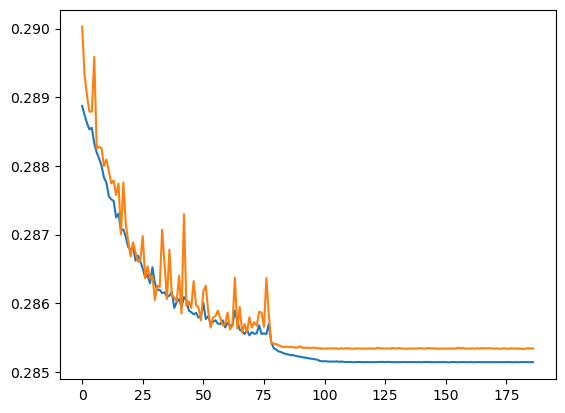

best epoch:  184


In [21]:
plt.style.use('default')

plt.plot(train_loss_list_2[3:])
plt.plot(valid_loss_list_2[3:])

plt.show()
print('best epoch: ',np.argmin(valid_loss_list_2)-1)
best=  np.argmin(valid_loss_list_2)-1
# plt.savefig('fig1.png', dpi=300, facecolor='w')

tensor(0.6296, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)

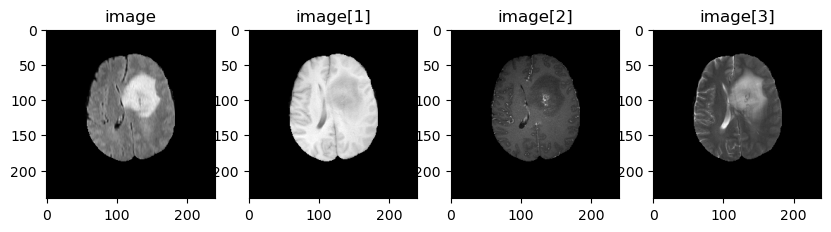

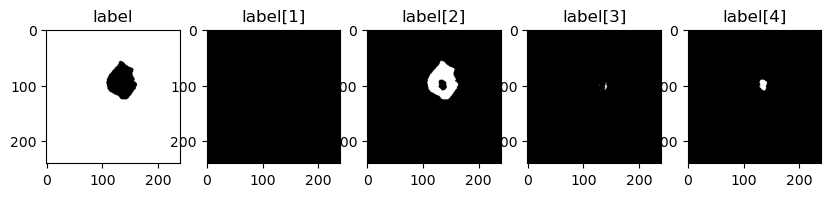

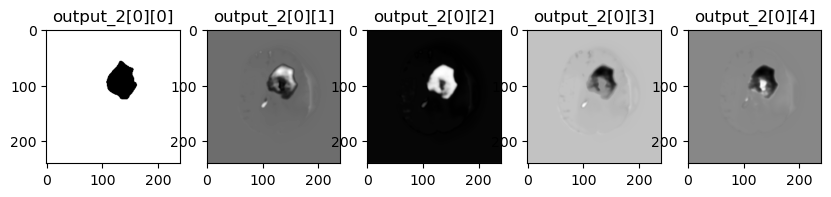

In [42]:
image, label = next(iter(test_loader))
image,label = image.to(device),label.to(device)
model_1= AttentionUNet_1(4,1).to(device)
model_1.load_state_dict(torch.load(f'./model/{save_1}.pt'))
model_2= AttentionUNet_1(4,4).to(device)
model_2.load_state_dict(torch.load(f'./model/{save_3}.pt'))
output =model_1(image)
output_2 = model_2(image)
check = threshold_img(output)
check = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).float()        
output_2 = torch.concat((check,output_2),dim=1)
f, (ax1,ax2,ax3,ax4) = plt.subplots(1,4,figsize = (10,20))
ax1.imshow(image[0][0].detach().cpu().numpy(),cmap='gray')
ax1.set_title('image')
ax2.imshow(image[0,1].detach().cpu().numpy(),cmap='gray')
ax2.set_title('image[1]')
ax3.imshow(image[0,2].detach().cpu().numpy(),cmap='gray')
ax3.set_title('image[2]')
ax4.imshow(image[0][3].detach().cpu().numpy(),cmap='gray')
ax4.set_title('image[3]')

f, (ax1,ax2,ax3,ax4,ax5) = plt.subplots(1,5,figsize = (10,20))
ax1.imshow(label[0][0].detach().cpu().numpy(),cmap='gray')
ax1.set_title('label')
ax2.imshow(label[0,1].detach().cpu().numpy(),cmap='gray')
ax2.set_title('label[1]')
ax3.imshow(label[0,2].detach().cpu().numpy(),cmap='gray')
ax3.set_title('label[2]')
ax4.imshow(label[0][3].detach().cpu().numpy(),cmap='gray')
ax4.set_title('label[3]')
ax5.imshow(label[0][4].detach().cpu().numpy(),cmap='gray')
ax5.set_title('label[4]')

f, (ax1,ax2,ax3,ax4,ax5) = plt.subplots(1,5,figsize = (10,20))
ax1.imshow(output_2[0][0].detach().cpu().numpy(),cmap='gray')
ax1.set_title('output_2[0][0]')
ax2.imshow(output_2[0,1].detach().cpu().numpy(),cmap='gray')
ax2.set_title('output_2[0][1]')
ax3.imshow(output_2[0,2].detach().cpu().numpy(),cmap='gray')
ax3.set_title('output_2[0][2]')
ax4.imshow(output_2[0][3].detach().cpu().numpy(),cmap='gray')
ax4.set_title('output_2[0][3]')
ax5.imshow(output_2[0][4].detach().cpu().numpy(),cmap='gray')
ax5.set_title('output_2[0][4]')
loss_func(output_2, label)

Text(0.5, 1.0, 'label[0] reshape')

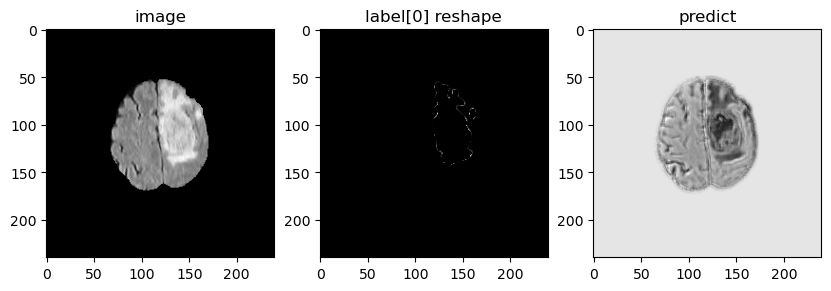

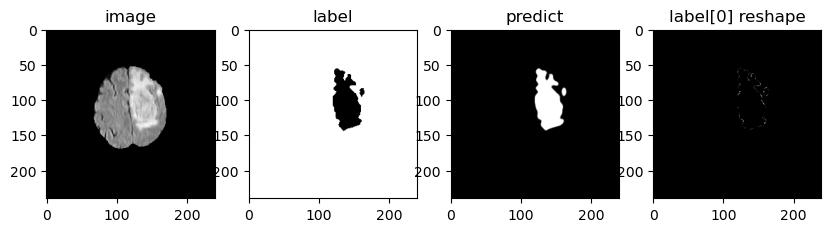

In [66]:
image , label = train_dataset.__getitem__(1200)
image, label = image.unsqueeze(0).cuda() , label.unsqueeze(0).cuda()
model_1.load_state_dict(torch.load(f"./model/{save_1}.pt"))
model_2.load_state_dict(torch.load(f'./model/{save_3}.pt'))
model_1.eval()
model_2.eval()
output = model_1(image)
la = label.clone()
l = output*label
la[:,0] = l[:,0]
output_2 = model_2(image)

##############
f, (ax1,ax2,ax3) = plt.subplots(1,3,figsize = (10,20))
ax1.imshow(image[0][0].detach().cpu().numpy(),cmap = 'gray')
ax1.set_title('image')
ax2.imshow(la[0][0].detach().cpu().numpy(),cmap = 'gray')
ax2.set_title('label[0] reshape')
ax3.imshow(output_2[0,0].detach().cpu().numpy(),cmap = 'gray')
ax3.set_title('predict')


# image.shape, label.shape
f, (ax1,ax2,ax3,ax4) = plt.subplots(1,4,figsize = (10,20))
ax1.imshow(image[0][0].detach().cpu().numpy(),cmap = 'gray')
ax1.set_title('image')
ax2.imshow(label[0,0].detach().cpu().numpy(),cmap = 'gray')
ax2.set_title('label')
ax3.imshow(output[0,0].detach().cpu().numpy(),cmap = 'gray')
ax3.set_title('predict')
ax4.imshow(la[0][0].detach().cpu().numpy(),cmap = 'gray')
ax4.set_title('label[0] reshape')


In [217]:
# def Bimshow(img,i):
#     plt.style.use('dark_background')
#     # plt.style.use('default')
    
#     plt.imshow(np.transpose(img), cmap=map_object, alpha=0.4)
#     # plt.text(10, 20, f'Epoch = {i}',color = 'white',size = 15)
#     # plt.text(10, 20, f'gilomas',color = 'white',size = 15)
#     # plt.style.use('default')

# plt.text(10, 20, f'gilomas',color = 'white',size = 15)
# plt.axis('off')
    
# # imshow1(pltimage[0][0].detach().cpu().numpy())
# param = torch.squeeze(pltout).detach().cpu().numpy()[1].T + torch.squeeze(pltout).detach().cpu().numpy()[2].T*10 + torch.squeeze(pltout).detach().cpu().numpy()[3].T*30 + torch.squeeze(pltout).detach().cpu().numpy()[4].T*40
# Bimshow(param, i)
# # plt.savefig('./image/TIC.png'.format(i), dpi=300,facecolor='None')   
# # plt.savefig('./image/gilomas'.format(i), dpi=300,)   



## Dice, Specificity, Sensitivity

In [27]:
def test_2(model_1,model_2, test_loader, loss_func,string, device):
    '''
    dataset shape -> [modality, h, d, w]
    dataset  -> data[0] : MR_Flair
    dataset  -> data[1] : MR_T1
    dataset  -> data[2] : MR_T1c
    dataset  -> data[3] : MR_T2
    one-hot: 
        [0] label necrosis
        [1] label edema
        [2] label non-enhancing tumor
        [3] label enhancing tumor
    '''
    enhancing = 0.0 # necrosis[1] + enhanced tumor[4]
    core = 0.0      # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3]
    complete = 0.0  # necrosis[1] + enhanced tumor[4] + non-enhanced tumor[3] + edema[2]
    enhancing_real_seg = 0.0
    core_real_seg = 0.0     
    complete_real_seg = 0.0 
    
    model_1 = model_1.to(device)
    model_2 = model_2.to(device)
    model_1.load_state_dict(torch.load(f"./model/{save_1}.pt"))
    
    model_2.load_state_dict(torch.load(f"./model/{save_3}.pt"))

    model_1.eval()
    model_2.eval()
    with torch.no_grad():
        for image, label in tqdm(test_loader, leave=False):
            image,label = image.to(device),label.to(device)
            output =model_1(image)
            output_2 = model_2(image)
            check = threshold_img(output)
            check = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).float()        
            output_2 = torch.concat((check,output_2),dim=1)
            output_2 = threshold_img(output_2)
        # pred = torch.topk(output_2, 1, dim=1).indices
        # target = torch.topk(label, 1, dim=1).indices
        
        en, co, com, en_real_seg, co_real_seg, com_real_seg  = loss_func(output_2.detach().cpu().numpy(), label.detach().cpu().numpy())
        
        enhancing += en
        core += co
        complete += com
        enhancing_real_seg += en_real_seg
        core_real_seg += co_real_seg
        complete_real_seg += com_real_seg
        
        
        
    enhancing, core, complete = enhancing/enhancing_real_seg, core/core_real_seg, complete/complete_real_seg
    
    return  complete, core, enhancing

In [28]:
model_1 = AttentionUNet_1(4, 1).to(device)
model_3 = AttentionUNet_2(4,4).to(device)
save_3 = '2_case_Macro_Unet_4to4'

dice  =dice
sen=sensitivity
spec=specificity

In [29]:
print('DICE : ', test_2(model_1,model_3, test_loader, dice,'DICE', device))
print('Specificity : ', test_2(model_1,model_3, test_loader, sen,'Specificity', device))
print('Sensitivity : ', test_2(model_1,model_3, test_loader, spec,'Sensitivity', device))

  0%|          | 0/149 [00:00<?, ?it/s]

DICE :  (0.9310631229235881, 0.9462092333756883, 0.9474130619168787)


  0%|          | 0/149 [00:00<?, ?it/s]

Specificity :  (0.9780085522296884, 0.88125, 0.9647887323943662)


  0%|          | 0/149 [00:00<?, ?it/s]

Sensitivity :  (0.999702058150931, 0.9998387459773502, 0.9998903119319725)


In [33]:
def test_confusion_matrix_2(model,model_2, test_loader, device):
    '''
    dataset shape -> [modality, h, d, w]
    dataset  -> data[0] : MR_Flair
    dataset  -> data[1] : MR_T1
    dataset  -> data[2] : MR_T1c
    dataset  -> data[3] : MR_T2
    one-hot: 
        [0] label normal
        [1] label necrosis
        [2] label edema
        [3] label non-enhancing tumor
        [4] label enhancing tumor
    '''
    class_name = ['Normal', 'Necrosis', 'Edema', 'Non-enhancing tumor', 'Enhancing tumor']

    model = model.to(device)
    model_2 = model_2.to(device)
    model.eval()
    model_2.eval()
    
    cm_pred = np.zeros((len(class_name), len(class_name)))
    cm_target = np.zeros((len(class_name), len(class_name)))
    for image, label in tqdm(test_loader, leave=False):
        image , label= image.to(device), label.to(device)
        output =model_1(image)
        output_2 = model_2(image)
        check = threshold_img(output)
        check = torch.bitwise_xor(check.int(),torch.ones_like(check.int(),dtype =torch.int32)).float()        
        output_2 = torch.concat((check,output_2),dim=1)
        output_2 = threshold_img(output_2)
        
        pred = torch.topk(output_2, 1, dim=1).indices
        target = torch.topk(label, 1, dim=1).indices
        
        cm_p, cm_t  = confusion_matrix(pred, target, class_name)
        cm_pred += cm_p
        cm_target += cm_t
        
    cm = np.round(cm_pred/cm_target, 2)
    ax = sns.heatmap(cm, annot=True)
    ax.set_yticklabels(class_name, rotation=0)
    ax.set_xticklabels(class_name, rotation=15)
    plt.show()
    return  cm

  0%|          | 0/149 [00:00<?, ?it/s]

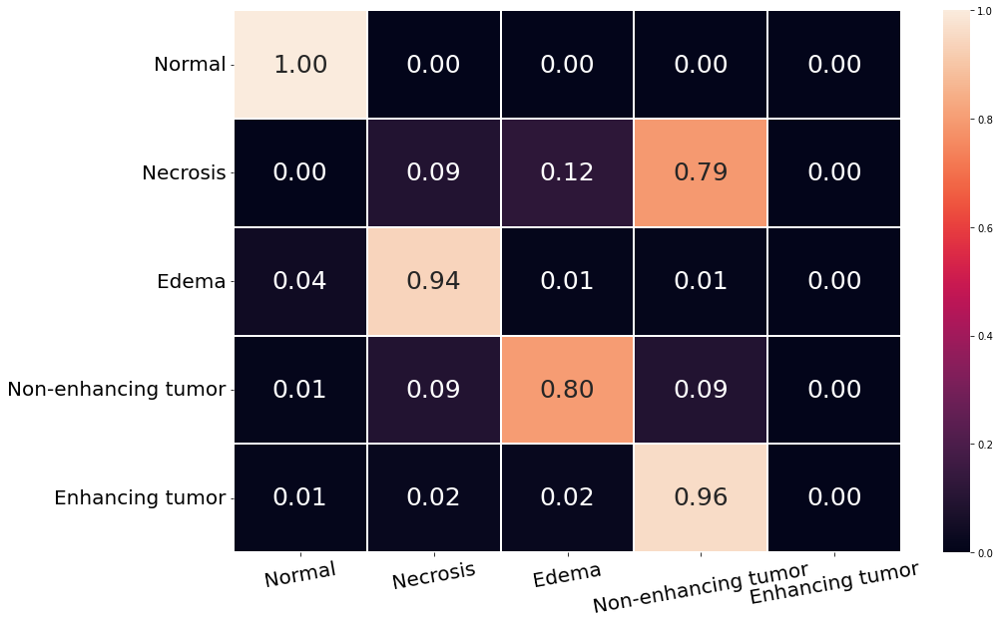

In [35]:
model_1 = AttentionUNet_1(4,1)
model_2 = AttentionUNet_2(4,4)
model_1.load_state_dict(torch.load(f'./model/{save_1}.pt'))
model_2.load_state_dict(torch.load(f"./model/{save_3}.pt"))


class_name = ['Normal', 'Necrosis', 'Edema', 'Non-enhancing tumor', 'Enhancing tumor']

cm = test_confusion_matrix(model_1,model_2, test_loader, device)

fig,ax = plt.subplots(1,1,figsize = (15,10))
ax = sns.heatmap(cm, annot=True,linewidths=0.1,fmt=".2f",annot_kws={"fontsize":25})
ax.set_yticklabels(class_name, rotation=0,fontsize =20,)
ax.set_xticklabels(class_name, rotation=10,fontsize =20)
plt.savefig('./png/macro_micro_2_path_4to4.png', dpi=200, facecolor='w',bbox_inches = 'tight')
plt.show()

# 전체 데이터를 모델에 넣었을때의 결과 

## Confusion_matrix

Text(0.5, 1.0, 'label[0] reshape')

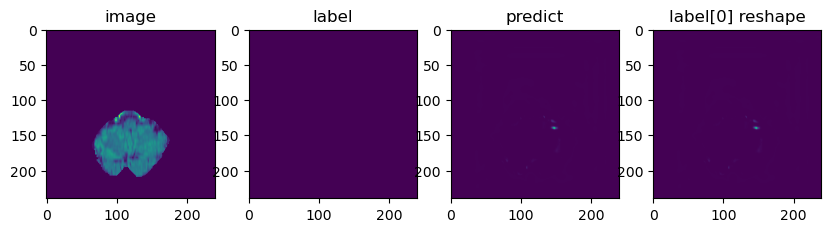

In [139]:
image , label = train_dataset.__getitem__(1200)
# image,label = pltimage , pltlabel
image, label = image.unsqueeze(0).cuda() , label.unsqueeze(0).cuda()
model_1.load_state_dict(torch.load(f"./model/{save_1}.pt"))
model_1.eval()
output = model_1(image)
# image.shape, label.shape
la = label.clone()
l = output*label
la[:,0] = l[:,0]
f, (ax1,ax2,ax3,ax4) = plt.subplots(1,4,figsize = (10,20))
ax1.imshow(image[0][0].detach().cpu().numpy())
ax1.set_title('image')
ax2.imshow(label[0,0].detach().cpu().numpy())
ax2.set_title('label')
ax3.imshow(output[0,0].detach().cpu().numpy())
ax3.set_title('predict')
ax4.imshow(la[0][0].detach().cpu().numpy())
ax4.set_title('label[0] reshape')


## Picture - 2

In [ ]:
def Bimshowhot(img):
    plt.imshow(img, cmap=map_object, alpha=0.3) 

def Bimshow(img):
    plt.imshow(img, cmap='gray') 

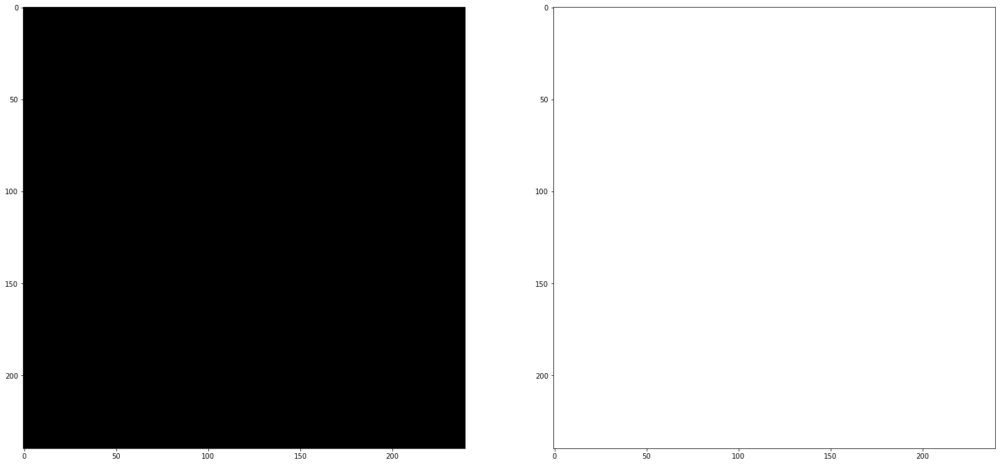

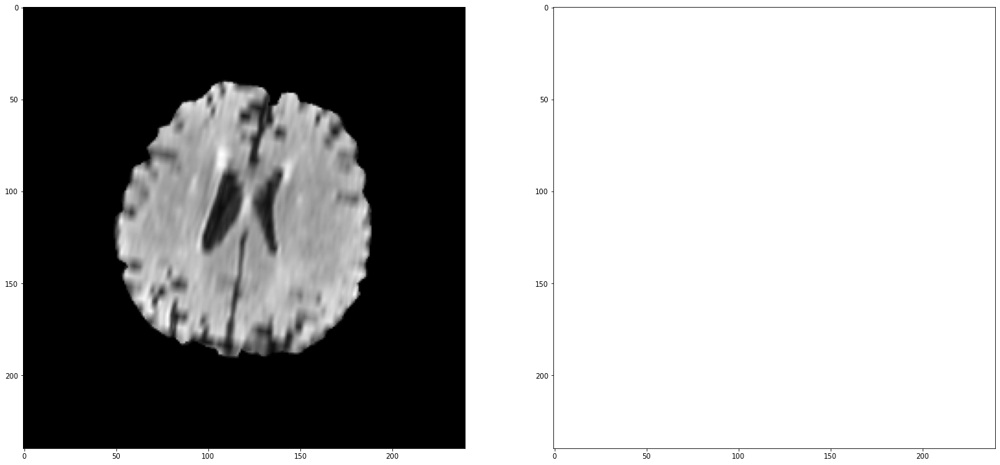

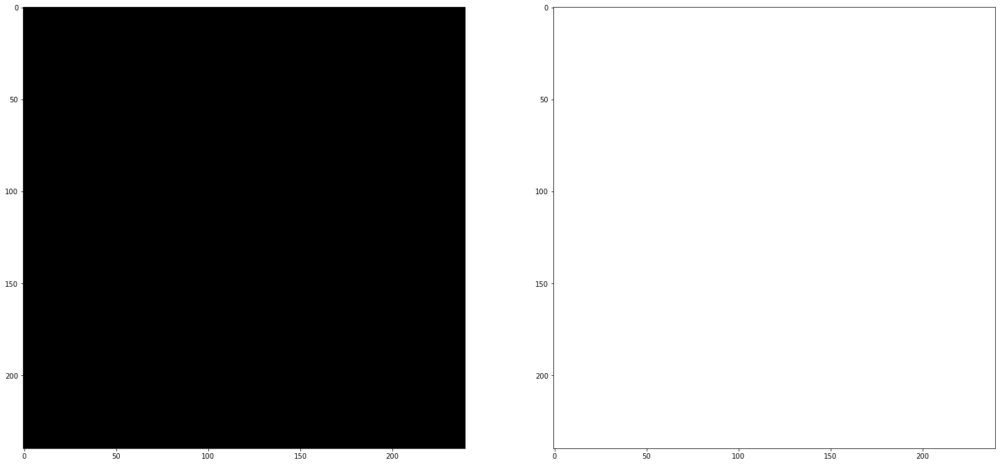

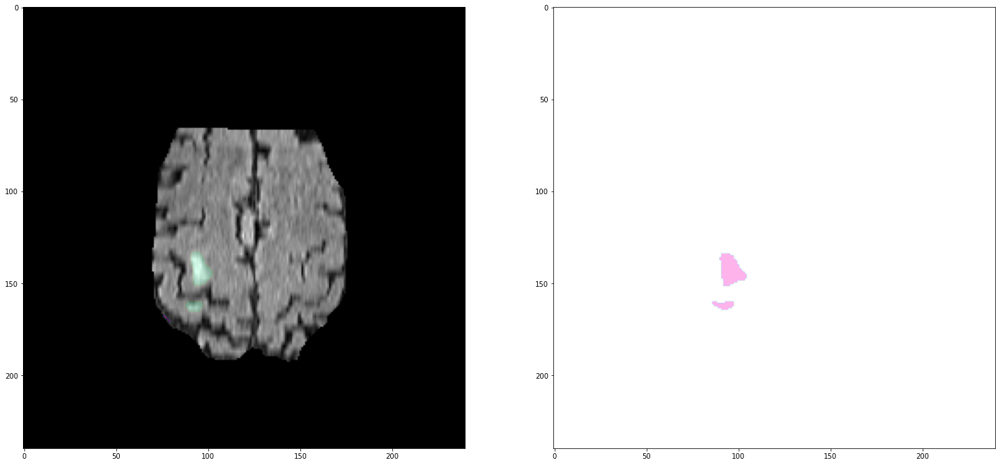

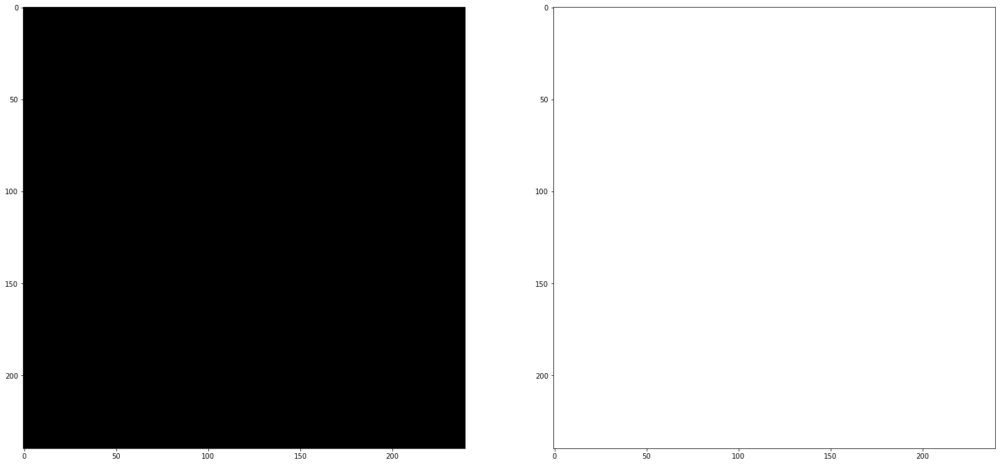

In [23]:
data, label = next(iter(test_loader))
data, label = data.to(device), label.to(device)
out = model(data)
pred = torch.topk(out, 1, dim=1).indices
target = torch.topk(label, 1, dim=1).indices

for i in range(5):
    plt.figure(figsize=(25, 25))
    plt.subplot(1,2,1)
    Bimshow(data[i][0].detach().cpu().numpy())
    Bimshowhot(pred[i][0].detach().cpu().numpy())
    plt.subplot(1,2,2)
    Bimshowhot(target[i][0].detach().cpu().numpy())
    plt.show()